In [17]:
import pathlib
import time
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
import skimage

import os
os.environ["KERAS_BACKEND"] = "tensorflow"
import tensorflow as tf

import keras
import keras.layers
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten, BatchNormalization, Conv2D,AveragePooling2D, MaxPooling2D, Dropout
from keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator
import visualkeras

import sklearn
import sklearn.metrics
import sklearn.neighbors
import sklearn.ensemble
from sklearn.metrics import roc_curve, auc

from tqdm.notebook import tqdm
import PIL
from collections import defaultdict

print(f"tf version: {tf.__version__}", f", keras version: {keras.__version__}")

ddir = pathlib.Path("data","SUIM")
print(f"We expect the data files in directory {ddir.absolute()}")

tf version: 2.15.0 , keras version: 2.15.0
We expect the data files in directory d:\Library\Downloads\Documents\School\SUPSI_23-24\deep_learning\notebooks\data\SUIM


# setup

## patches

In [2]:
patches_train = np.load(pathlib.Path(ddir, "npy", "patches_train.npy"))
labels_train = np.load(pathlib.Path(ddir, "npy", "labels_train.npy"))
patches_test = np.load(pathlib.Path(ddir, "npy", "patches_test.npy"))
labels_test = np.load(pathlib.Path(ddir, "npy", "labels_test.npy"))
print(len(patches_train), len(labels_train), len(patches_test), len(labels_test))

37093 37093 2828 2828


In [3]:
patches_train_reduced = np.load(pathlib.Path(ddir, "npy", "patches_train_reduced.npy"))
labels_train_reduced = np.load(pathlib.Path(ddir, "npy", "labels_train_reduced.npy"))
patches_test_reduced = np.load(pathlib.Path(ddir, "npy", "patches_test_reduced.npy"))
labels_test_reduced = np.load(pathlib.Path(ddir, "npy", "labels_test_reduced.npy"))
print(len(patches_train_reduced), len(labels_train_reduced), len(patches_test_reduced), len(labels_test_reduced))

37128 37128 2763 2763


In [282]:
patches_train_reduced = np.load(pathlib.Path(ddir, "npy", "patches_train_reduced_100.npy"))
labels_train_reduced = np.load(pathlib.Path(ddir, "npy", "labels_train_reduced_100.npy"))
patches_test_reduced = np.load(pathlib.Path(ddir, "npy", "patches_test_reduced_100.npy"))
labels_test_reduced = np.load(pathlib.Path(ddir, "npy", "labels_test_reduced_100.npy"))
print(len(patches_train_reduced), len(labels_train_reduced), len(patches_test_reduced), len(labels_test_reduced))

25704 25704 1981 1981


In [5]:
print("---------------train---------------")
print("fish patches: ",f"{np.sum(labels_train)}, {round(np.sum(labels_train)/len(labels_train)*100,4)}%")
print("rnd patches: ",f"{np.sum(labels_train==0)}, {round(np.sum(labels_train==0)/len(labels_train)*100,4)}%")

print("---------------test----------------")
print("fish patches: ",f"{np.sum(labels_test)}, {round(np.sum(labels_test)/len(labels_test)*100,4)}%")
print("rnd patches: ",f"{np.sum(labels_test==0)}, {round(np.sum(labels_test==0)/len(labels_test)*100,4)}%")


print("-----------train-reduced-----------")
print("fish patches: ",f"{np.sum(labels_train_reduced)}, {round(np.sum(labels_train_reduced)/len(labels_train_reduced)*100,4)}%")
print("rnd patches: ",f"{np.sum(labels_train_reduced==0)}, {round(np.sum(labels_train_reduced==0)/len(labels_train_reduced)*100,4)}%")

print("-----------test-reduced------------")
print("fish patches: ",f"{np.sum(labels_test_reduced)}, {round(np.sum(labels_test_reduced)/len(labels_test_reduced)*100,4)}%")
print("rnd patches: ",f"{np.sum(labels_test_reduced==0)}, {round(np.sum(labels_test_reduced==0)/len(labels_test_reduced)*100,4)}%")



---------------train---------------
fish patches:  18538, 49.9771%
rnd patches:  18555, 50.0229%
---------------test----------------
fish patches:  1448, 51.2023%
rnd patches:  1380, 48.7977%
-----------train-reduced-----------
fish patches:  18576, 50.0323%
rnd patches:  18552, 49.9677%
-----------test-reduced------------
fish patches:  1383, 50.0543%
rnd patches:  1380, 49.9457%


In [133]:
def read_image(name, set_="train_val", im_type="images"):
    im = skimage.io.imread(pathlib.Path(ddir, set_, im_type, name))
    if im_type == "masks":
        return skimage.img_as_float(im)
    return im

def get_images(set_="train_val", im_type="images"):
    return [read_image(file.name, set_, im_type) 
            for file in pathlib.Path(ddir, set_, im_type).iterdir() 
            if file.is_file()]
    
def get_filenames(set_="train_val", im_type="images"):
    return [file.name[:-4]
            for file in pathlib.Path(ddir, set_, im_type).iterdir() 
            if file.is_file()]

def plot_loss_acc(history,title="",epochs=np.inf,auc=True):
    if auc:
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        i = 2
    else:
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))
        i = 1
    epochs = min(len(history.history['loss']),epochs)
    
    try:
        axes[0].plot(history.history['accuracy'][:epochs], label='Train acc')
        axes[0].plot(history.history['val_accuracy'][:epochs], label='Val acc') 
    except KeyError:
        axes[0].plot(history.history['binary_accuracy'][:epochs], label='Train acc')
        axes[0].plot(history.history['val_binary_accuracy'][:epochs], label='Val acc')
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Accuracy')
    axes[0].set_title('Accuracy')
    axes[0].grid(True)
    axes[0].legend()
    if auc:
        axes[1].plot(history.history['auc'][:epochs], label='auc')
        axes[1].plot(history.history['val_auc'][:epochs], label='Val auc')
        axes[1].set_xlabel('Epoch')
        axes[1].set_ylabel('AUC')
        axes[1].set_title('AUC')
        axes[1].grid(True)
        axes[1].legend()
    
    axes[i].plot(history.history['loss'][:epochs], label='Train loss')
    axes[i].plot(history.history['val_loss'][:epochs], label='Val loss')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].set_title('Loss')
    axes[i].grid(True)
    axes[i].legend()
    
    fig.suptitle(title)
    plt.show()


def plot_AUC(labels_test,labels_prob,title="",figsize=(4,4),red=False):
    # if red:
    #     test_labels = labels_test_reduced
    # else:
    #     test_labels = labels_test
    if isinstance(labels_prob,dict):
        fprs = []
        tprs = []
        roc_aucs = []
        for key in labels_prob.keys():
            fpr, tpr, _ = roc_curve(labels_test, labels_prob[key])
            roc_auc = auc(fpr, tpr)
            fprs.append(fpr)
            tprs.append(tpr)
            roc_aucs.append(roc_auc)
    else:
        fpr, tpr, _ = roc_curve(labels_test, labels_prob)
        roc_auc = auc(fpr, tpr)

    # Plot ROC curve
    plt.figure(figsize=figsize)
    if isinstance(labels_prob,dict):
        for i in range(len(fprs)):
            plt.plot(fprs[i], tprs[i], lw=2, label=f'{list(labels_prob.keys())[i]} (AUC = {round(roc_aucs[i],2)})')
    else:
        plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (AUC = {:.2f})'.format(roc_auc))
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random classifier')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve '+title)
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()
    
    return roc_auc
    
    
def plot_confustion_matrix(labels_test, labels_pred,percent=False):
    acc = np.mean(labels_test == labels_pred)
    if percent:
        cm = sklearn.metrics.confusion_matrix(y_true=labels_test, y_pred=labels_pred,normalize="true")
        fmt = '.0%'
    else:
        cm = sklearn.metrics.confusion_matrix(y_true=labels_test, y_pred=labels_pred)
        fmt = 'd'
    sns.heatmap(cm, annot=True, xticklabels=["Fish", "Not fish"], yticklabels=["Fish", "Not fish"], fmt=fmt)
    plt.xlabel('Prediction', fontsize = 12) 
    plt.ylabel('Truth', fontsize = 12) 
    plt.title(f"Confusion Matrix testing instances (acc={acc:.0%})", fontsize = 15)
    return cm

Text(0.5, 0.8, '50x50 patches from original res')

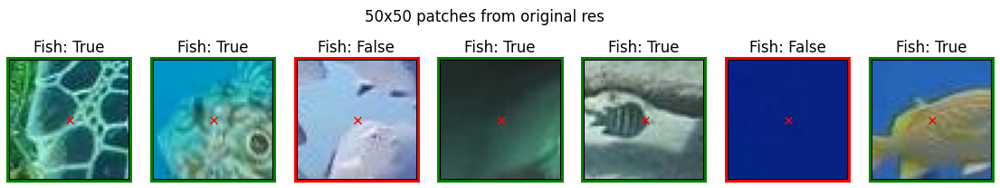

In [219]:
amt = 7
random_idx = np.random.choice(len(patches_train), amt, replace=False)

fig, axes = plt.subplots(2, amt, figsize=(2*amt, 4))
for i,(im, label) in enumerate(zip(patches_train[random_idx], labels_train[random_idx])):
    axes[i].imshow(im)
    axes[i].set_title(f"Fish: {label}")
    axes[i].plot(im.shape[0]//2, im.shape[1]//2, "x", color="red")
    if label == True:
        axes[i].patch.set_linewidth(5)
        axes[i].patch.set_edgecolor('green')
    else:
        axes[i].patch.set_linewidth(5)
        axes[i].patch.set_edgecolor('red')
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
fig.suptitle("50x50 patches from original res",y=.8)

Text(0.5, 0.8, '50x50 patches from 50% res')

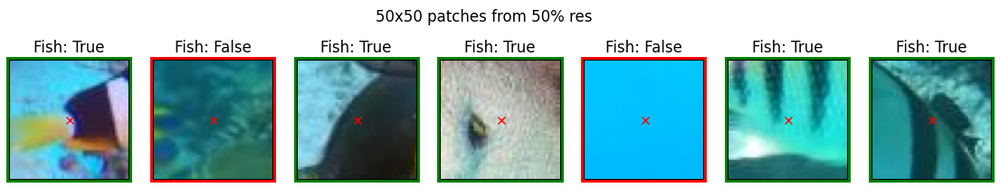

In [235]:
amt = 7
random_idx = np.random.choice(len(patches_train_reduced), amt, replace=False)

fig, axes = plt.subplots(2, amt, figsize=(2*amt, 4))
for i,(im, label) in enumerate(zip(patches_train_reduced[random_idx], labels_train_reduced[random_idx])):
    axes[i].imshow(im)
    axes[i].set_title(f"Fish: {label}")
    axes[i].plot(im.shape[0]//2, im.shape[1]//2, "x", color="red")
    if label == True:
        axes[i].patch.set_linewidth(5)
        axes[i].patch.set_edgecolor('green')
    else:
        axes[i].patch.set_linewidth(5)
        axes[i].patch.set_edgecolor('red')
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
fig.suptitle("50x50 patches from 50% res",y=.8)

Text(0.5, 0.8, '100x100 patches from 50% res')

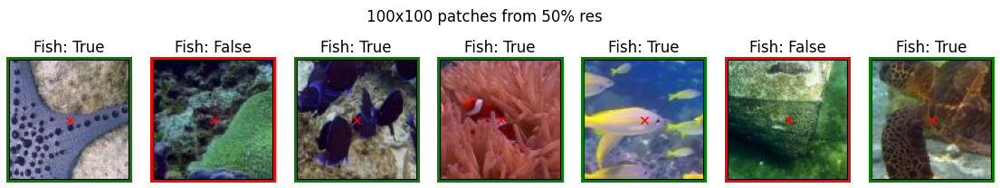

In [297]:
amt = 7
random_idx = np.random.choice(len(patches_train_reduced), amt, replace=False)

fig, axes = plt.subplots(2, amt, figsize=(2*amt, 4))
for i,(im, label) in enumerate(zip(patches_train_reduced[random_idx], labels_train_reduced[random_idx])):
    axes[i].imshow(im)
    axes[i].set_title(f"Fish: {label}")
    axes[i].plot(im.shape[0]//2, im.shape[1]//2, "x", color="red")
    if label == True:
        axes[i].patch.set_linewidth(5)
        axes[i].patch.set_edgecolor('green')
    else:
        axes[i].patch.set_linewidth(5)
        axes[i].patch.set_edgecolor('red')
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
fig.suptitle("100x100 patches from 50% res",y=.8)

## labels

In [298]:
labels_train_oh = keras.utils.to_categorical(labels_train, num_classes=2).astype(np.int8)
labels_test_oh = keras.utils.to_categorical(labels_test, num_classes=2).astype(np.int8)
print(labels_train_oh.shape, labels_test_oh.shape)
print(labels_train_oh.sum(axis=0))
print(labels_test_oh[:3],"\n")

labels_train_bin = np.argmax(labels_train_oh, axis=-1)
labels_test_bin = np.argmax(labels_test_oh, axis=-1)
print(labels_train_bin.shape, labels_test_bin.shape)
print(np.bincount(labels_train_bin))
print(labels_test_bin[:3])

print("-------------reduced data-------------")
labels_train_oh_reduced = keras.utils.to_categorical(labels_train_reduced, num_classes=2).astype(np.int8)
labels_test_oh_reduced = keras.utils.to_categorical(labels_test_reduced, num_classes=2).astype(np.int8)
print(labels_train_oh_reduced.shape, labels_test_oh_reduced.shape)
print(labels_train_oh_reduced.sum(axis=0))
print(labels_test_oh_reduced[:3],"\n")

labels_train_bin_reduced = np.argmax(labels_train_oh_reduced, axis=-1)
labels_test_bin_reduced = np.argmax(labels_test_oh_reduced, axis=-1)
print(labels_train_bin_reduced.shape, labels_test_bin_reduced.shape)
print(np.bincount(labels_train_bin_reduced))
print(labels_test_bin_reduced[:3])

(37093, 2) (2828, 2)
[18555 18538]
[[0 1]
 [1 0]
 [0 1]] 

(37093,) (2828,)
[18555 18538]
[1 0 1]
-------------reduced data-------------
(25704, 2) (1981, 2)
[18555 18538]
[[0 1]
 [1 0]
 [0 1]] 

(25704,) (1981,)
[12857 12847]
[1 1 0]


## train fn

In [5]:
def get_callbacks(model_name):
    modelid = model_name + "_" + time.strftime("%Y-%m-%d_%H-%M-%S")
    return [
    # keras.callbacks.TerminateOnNaN(),
    keras.callbacks.ReduceLROnPlateau(
        verbose=1,
        monitor='val_loss',
        patience=5, # how many epochs with no improvement to wait until reducing learning rate (tweak)
        factor=0.05,
        min_delta=0.0003,
      ),
    keras.callbacks.EarlyStopping(
        verbose=1,
        monitor='val_loss',
        patience=7, # how many epochs with no improvement to wait until stopping (tweak)
        restore_best_weights=True,
        start_from_epoch=10
      ),
    keras.callbacks.ModelCheckpoint(
        filepath=(ddir/"models"/"checkpoints"/f'checkpoint_best_{modelid}.keras').as_posix(),
        monitor='val_loss',
        save_best_only=True
      ),
        keras.callbacks.BackupAndRestore(
        backup_dir = (ddir/"models"/"tmp-backups"/model_name).as_posix(),
        save_freq="epoch", 
        delete_checkpoint=True
      ),
        keras.callbacks.TensorBoard(
        log_dir=(ddir/"logs"/modelid).as_posix(),
        histogram_freq=0, write_graph=False, write_images=False
      )
]
    
def shift_color(im):
    if np.random.randint(3) == 1:
        im = skimage.img_as_float(im)
        im = im*np.random.uniform(.9,1.1,size=(1,1,3))
        im = np.clip(im,0,1)
    return im

def train_model(model,epochs=100,batch_size=64, callbacks=None,augment=False,red=False):
    if red:
        patches_tr = patches_train_reduced
        labels_tr_bin = labels_train_bin_reduced
        patches_te = patches_test_reduced
        labels_te_bin = labels_test_bin_reduced
    else:
        patches_tr = patches_train
        labels_tr_bin = labels_train_bin
        patches_te = patches_test
        labels_te_bin = labels_test_bin
    
    datagen = ImageDataGenerator(
        rotation_range=45,
        width_shift_range=0.1,
        height_shift_range=0.1,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        brightness_range=(0.7,1.2),
        fill_mode='nearest',
        preprocessing_function = shift_color
    )
    
    if augment:
        history = model.fit(
            datagen.flow(patches_tr.astype(float)/255, labels_tr_bin, batch_size=batch_size),
            validation_data=(patches_te.astype(float)/255, labels_te_bin),
            epochs=epochs, #steps_per_epoch=int(len(patches_train)//batch_size),
            callbacks=callbacks

        )
    else:
        history = model.fit(
            patches_tr.astype(float) / 255, labels_tr_bin, batch_size=batch_size,
            validation_data=(patches_te.astype(float) / 255, labels_te_bin),
            epochs=epochs, #steps_per_epoch=int(len(patches_train)//batch_size),
            callbacks=callbacks
       
        )
    return history

# simple NN

In [106]:
color_map = defaultdict(dict)
color_map[keras.layers.Conv2D]['fill'] = '#799bcd'
color_map[keras.layers.BatchNormalization]['fill'] = '#ffc4c2'
color_map[keras.layers.Dropout]['fill'] = '#db335b'
color_map[keras.layers.MaxPooling2D]['fill'] = '#118ab2'
color_map[keras.layers.AveragePooling2D]['fill'] = '#0c627e'
color_map[keras.layers.Dense]['fill'] = '#073b4c'
color_map[keras.layers.Flatten]['fill'] = '#797775'
color_map[keras.layers.Activation]['fill'] = '#00c28c'
color_map[keras.layers.InputLayer]['fill'] = '#ffef66'
color_map[keras.layers.UpSampling2D]['fill'] = '#01c5ff'
color_map[keras.layers.Concatenate]['fill'] = '#c43e1c'

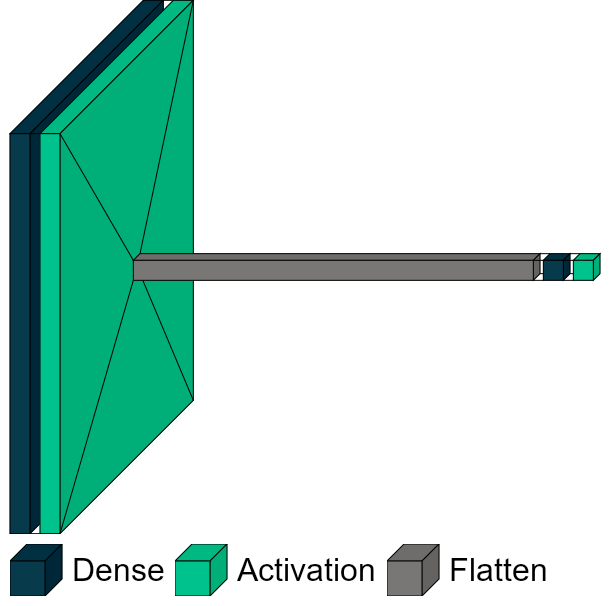

In [54]:
patchsize = 100

def make_model_nn(input_neurons):
    # linear stack of layers  
    model = Sequential(name="nn")
    # regular deeply connected neural network layer with 100 neurons
    model.add(Dense(input_neurons, input_shape=(patchsize,patchsize,3))) 
    # apply sigmoid activation function
    model.add(Activation("sigmoid")) 
    # flatten the input
    model.add(Flatten()) 
    # regular densely-connected NN layer with 2 neurons for output
    model.add(Dense(1)) 
    # sigmoid for binary classification
    model.add(Activation("sigmoid")) 
    
    # Adam optimization algorithm is an extension to stochastic gradient descent for computer vision and natural language processing
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.01),  
                  loss=keras.losses.BinaryCrossentropy(from_logits=False),
                  metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)])
    
    return model

input_neurons = 100
model_nn = make_model_nn(input_neurons)

font = PIL.ImageFont.truetype("arial.ttf", 32)  
visualkeras.layered_view(model_nn , legend=True, font=font, color_map=color_map)  
# model_nn.summary()

In [303]:
batch_size        = 64
epochs            = 25
augmented         = False
reduced           = True

model_name = "model_nn_red2"
callbacks = get_callbacks(model_name)

model_nn = make_model_nn(input_neurons)
history_nn = train_model(model_nn, epochs, batch_size, callbacks, augmented,reduced)

model_nn.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))

np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history_nn)

Epoch 1/25
402/402 [==============================] - 156s 380ms/step - loss: 147.8525 - binary_accuracy: 0.5013 - auc_9: 0.5009 - val_loss: 33.7527 - val_binary_accuracy: 0.5008 - val_auc_9: 0.5025 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 159s 395ms/step - loss: 20.7034 - binary_accuracy: 0.5133 - auc_9: 0.5137 - val_loss: 8.4768 - val_binary_accuracy: 0.5083 - val_auc_9: 0.5251 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 150s 374ms/step - loss: 5.8927 - binary_accuracy: 0.5284 - auc_9: 0.5346 - val_loss: 3.3424 - val_binary_accuracy: 0.5144 - val_auc_9: 0.6075 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 136s 337ms/step - loss: 5.9485 - binary_accuracy: 0.5286 - auc_9: 0.5324 - val_loss: 3.0284 - val_binary_accuracy: 0.5295 - val_auc_9: 0.5306 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 144s 358ms/step - loss: 3.2818 - binary_accuracy: 0.5389 - auc_9: 0.5537 - val_loss: 1.1242 - val_binary_a

In [306]:
batch_size        = 64
epochs            = 25
augmented         = True
reduced           = True

model_name = "model_nn_red2_aug"
callbacks = get_callbacks(model_name)

model_nn = make_model_nn(input_neurons)
history_nn = train_model(model_nn, epochs, batch_size, callbacks, augmented,reduced)

model_nn.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history_nn)

Epoch 1/25
402/402 [==============================] - 243s 595ms/step - loss: 212.3098 - binary_accuracy: 0.4999 - auc_11: 0.4998 - val_loss: 33.0546 - val_binary_accuracy: 0.4997 - val_auc_11: 0.5000 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 193s 480ms/step - loss: 31.3541 - binary_accuracy: 0.4955 - auc_11: 0.4959 - val_loss: 11.0125 - val_binary_accuracy: 0.4997 - val_auc_11: 0.5000 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 182s 452ms/step - loss: 13.3468 - binary_accuracy: 0.4982 - auc_11: 0.4986 - val_loss: 9.0415 - val_binary_accuracy: 0.5003 - val_auc_11: 0.4995 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 196s 487ms/step - loss: 6.8450 - binary_accuracy: 0.4972 - auc_11: 0.4973 - val_loss: 2.4495 - val_binary_accuracy: 0.4997 - val_auc_11: 0.4877 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 194s 481ms/step - loss: 3.9904 - binary_accuracy: 0.4981 - auc_11: 0.4986 - val_loss: 0.7573 - v

# CNN

## CNN RPS

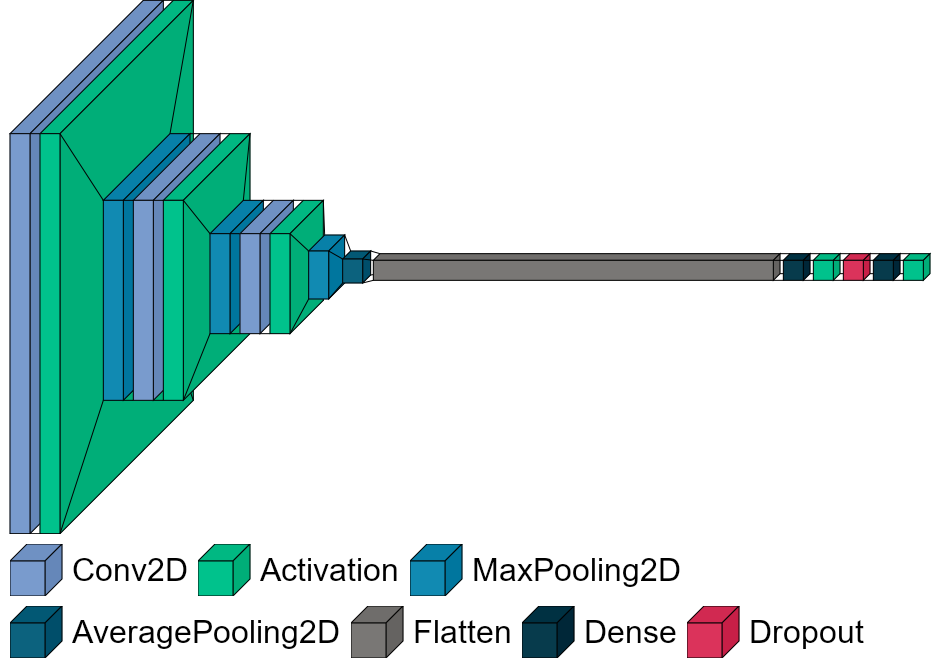

In [107]:

# ! simplified model using rock paper scissors example
patchsize          = 100
pool_size          = (2,2) # size of pooling area for max pooling
kernel_size        = (3,3) # convolution kernel size

def make_model_1(nb_filters):
    model = Sequential(name="cnn1")
    model.add(Conv2D(nb_filters, kernel_size, padding = "same" ,
              input_shape=(patchsize,patchsize,3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size = pool_size))
    
    model.add(Conv2D(nb_filters*2, kernel_size, padding = "same"))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size = pool_size))
    
    model.add(Conv2D(nb_filters*4, kernel_size, padding = "same"))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size = pool_size))
    model.add(AveragePooling2D(pool_size = pool_size))
    
    model.add(Flatten())
    model.add(Dense(128)) # generate a fully connected layer with 128 outputs (arbitrary value)
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1)) # output layer
    model.add(Activation('sigmoid'))

    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=0.01),
        loss=keras.losses.BinaryCrossentropy(from_logits=False),
        metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)]
    )

    return model

filters= 32
model1 = make_model_1(filters)
visualkeras.layered_view(model1  , legend=True, font=font, color_map=color_map)  
# model1.summary()

In [308]:
batch_size      = 64
epochs          = 25
augmented       = False
reduced         = True

model_name = "model_cnn1_red2"
callbacks = get_callbacks(model_name)

model1 = make_model_1(filters)
history1 = train_model(model1, epochs, batch_size, callbacks, augmented,reduced)

model1.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history1)

Epoch 1/25
402/402 [==============================] - 160s 379ms/step - loss: 0.7115 - binary_accuracy: 0.5016 - auc_13: 0.5026 - val_loss: 0.6931 - val_binary_accuracy: 0.4997 - val_auc_13: 0.5000 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 155s 385ms/step - loss: 0.6933 - binary_accuracy: 0.4993 - auc_13: 0.4979 - val_loss: 0.6934 - val_binary_accuracy: 0.5003 - val_auc_13: 0.5000 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 178s 443ms/step - loss: 0.6933 - binary_accuracy: 0.4956 - auc_13: 0.4948 - val_loss: 0.6932 - val_binary_accuracy: 0.5003 - val_auc_13: 0.5000 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 181s 449ms/step - loss: 0.6934 - binary_accuracy: 0.4954 - auc_13: 0.4977 - val_loss: 0.6931 - val_binary_accuracy: 0.5003 - val_auc_13: 0.5000 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 168s 417ms/step - loss: 0.6933 - binary_accuracy: 0.4949 - auc_13: 0.4938 - val_loss: 0.6931 - val_bin

In [309]:
batch_size        = 64
epochs            = 25
augmented         = True
reduced           = True

model_name = "model_cnn1_red2_aug"
callbacks = get_callbacks(model_name)

model1 = make_model_1(filters)
history1 = train_model(model1, epochs, batch_size, callbacks, augmented,reduced)

model1.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history1)

Epoch 1/25
402/402 [==============================] - 190s 443ms/step - loss: 0.6941 - binary_accuracy: 0.5042 - auc_14: 0.5040 - val_loss: 0.6933 - val_binary_accuracy: 0.5003 - val_auc_14: 0.5000 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 171s 425ms/step - loss: 0.6934 - binary_accuracy: 0.5014 - auc_14: 0.4993 - val_loss: 0.6932 - val_binary_accuracy: 0.4997 - val_auc_14: 0.5000 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 168s 417ms/step - loss: 0.6933 - binary_accuracy: 0.4982 - auc_14: 0.4958 - val_loss: 0.6935 - val_binary_accuracy: 0.4997 - val_auc_14: 0.5000 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 163s 406ms/step - loss: 0.6933 - binary_accuracy: 0.4959 - auc_14: 0.5008 - val_loss: 0.6932 - val_binary_accuracy: 0.4997 - val_auc_14: 0.5000 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 172s 426ms/step - loss: 0.6934 - binary_accuracy: 0.4941 - auc_14: 0.4939 - val_loss: 0.6932 - val_bin

1/1 [==============================] - 1s 581ms/step


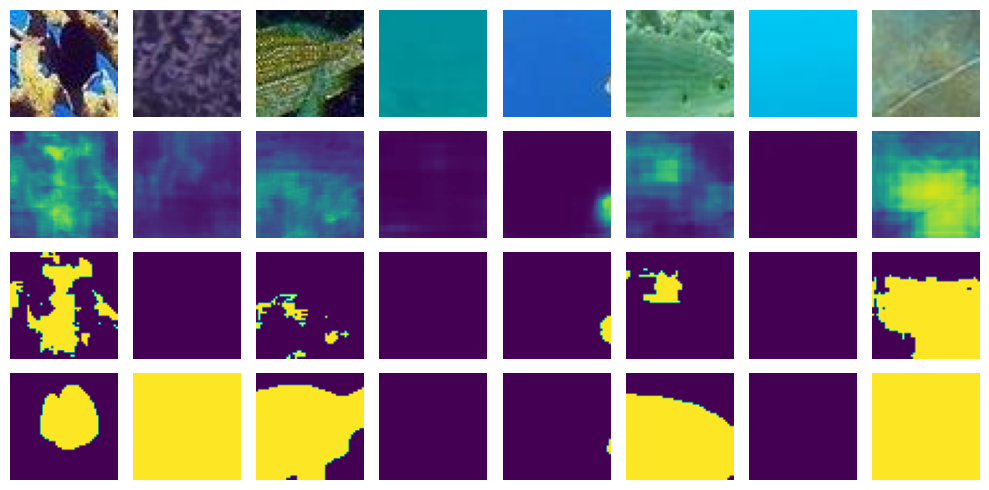

Epoch 1/4
203/203 [==============================] - 100s 459ms/step - loss: 0.4417 - binary_accuracy: 0.7891 - val_loss: 0.4412 - val_binary_accuracy: 0.7888 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4416 - binary_accuracy: 0.7894 - val_loss: 0.4414 - val_binary_accuracy: 0.7887 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 92s 454ms/step - loss: 0.4412 - binary_accuracy: 0.7893 - val_loss: 0.4414 - val_binary_accuracy: 0.7887 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


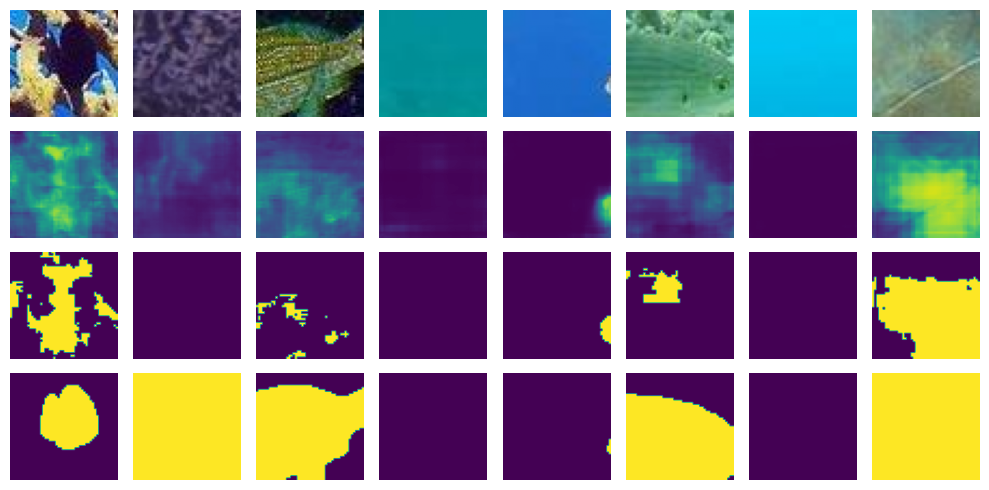

Epoch 1/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4409 - binary_accuracy: 0.7896 - val_loss: 0.4415 - val_binary_accuracy: 0.7886 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4408 - binary_accuracy: 0.7895 - val_loss: 0.4417 - val_binary_accuracy: 0.7886 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 92s 454ms/step - loss: 0.4410 - binary_accuracy: 0.7896 - val_loss: 0.4417 - val_binary_accuracy: 0.7886 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


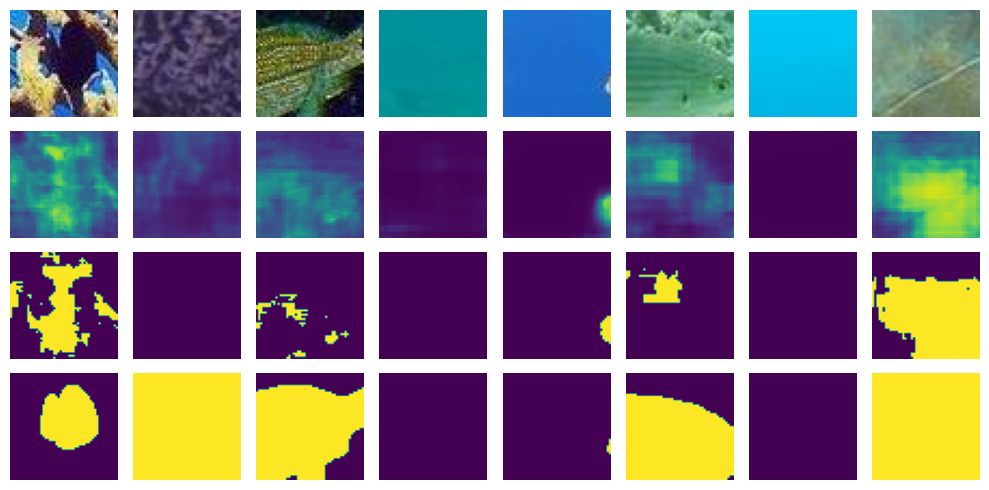

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4407 - binary_accuracy: 0.7898 - val_loss: 0.4417 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4412 - binary_accuracy: 0.7897 - val_loss: 0.4417 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4403 - binary_accuracy: 0.7901 - val_loss: 0.4418 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


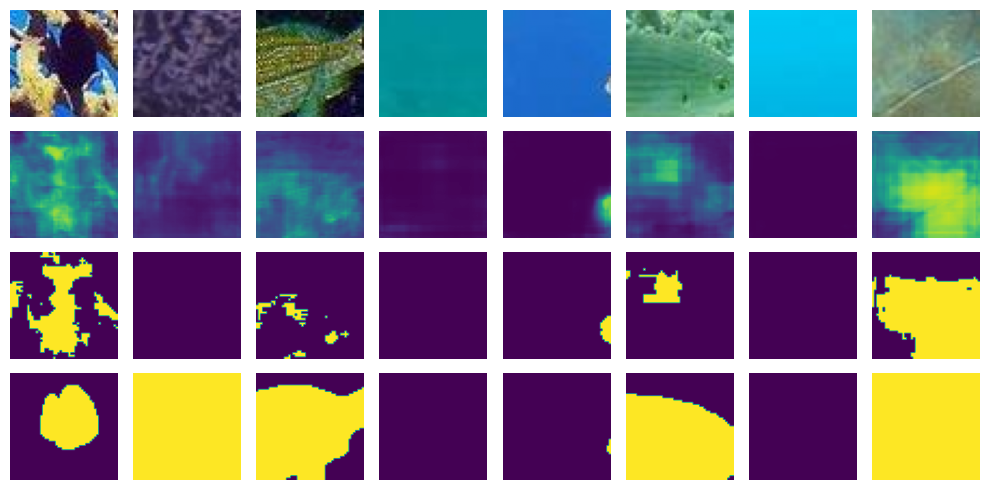

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4416 - binary_accuracy: 0.7894 - val_loss: 0.4419 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4405 - binary_accuracy: 0.7900 - val_loss: 0.4419 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4411 - binary_accuracy: 0.7897 - val_loss: 0.4419 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


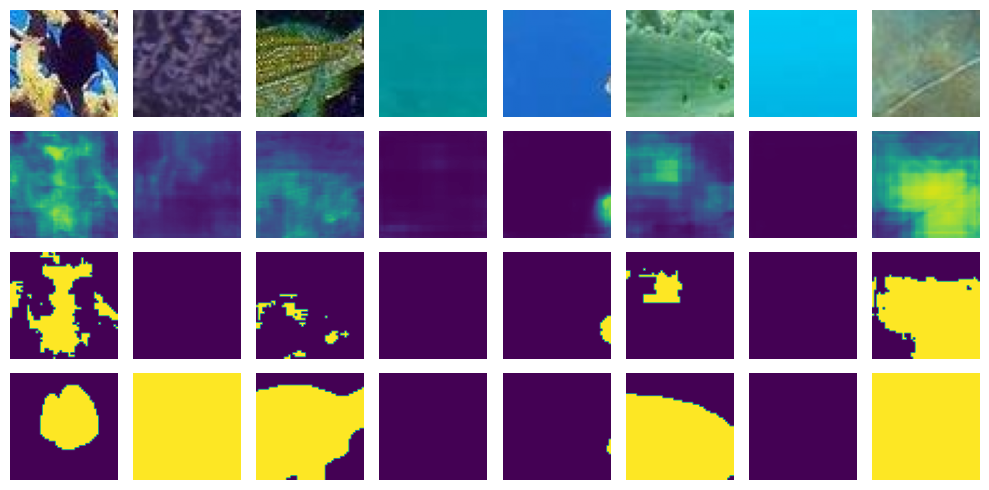

Epoch 1/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4406 - binary_accuracy: 0.7898 - val_loss: 0.4419 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4411 - binary_accuracy: 0.7896 - val_loss: 0.4420 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4404 - binary_accuracy: 0.7899 - val_loss: 0.4420 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 57ms/step


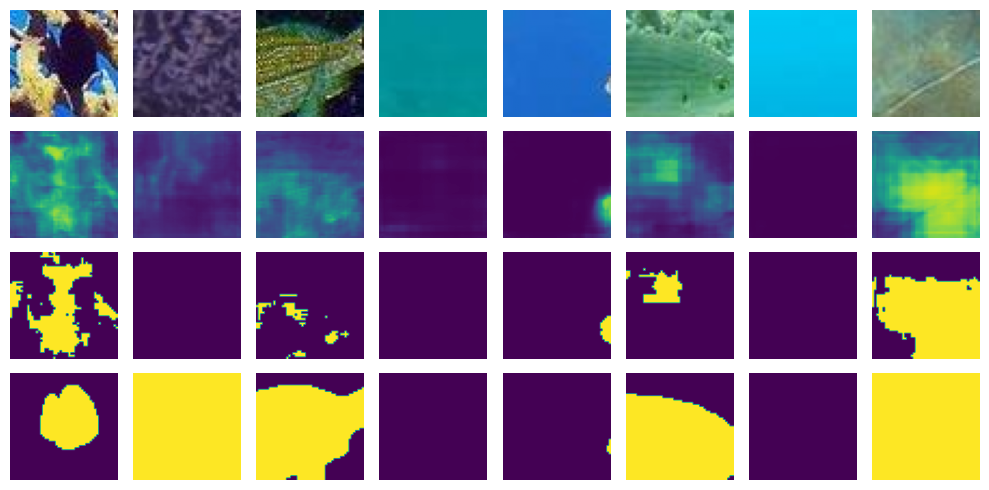

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4405 - binary_accuracy: 0.7900 - val_loss: 0.4420 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4406 - binary_accuracy: 0.7899 - val_loss: 0.4420 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4407 - binary_accuracy: 0.7897 - val_loss: 0.4421 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


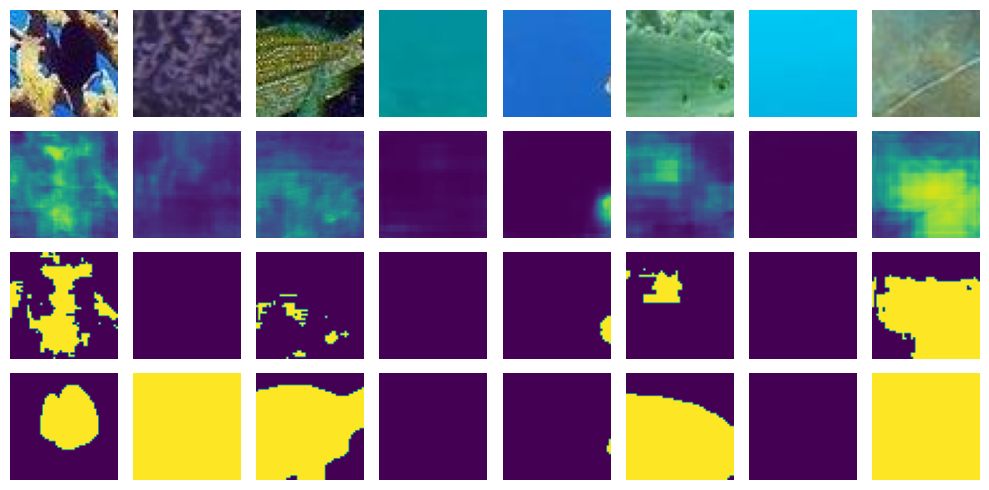

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4407 - binary_accuracy: 0.7897 - val_loss: 0.4421 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4408 - binary_accuracy: 0.7900 - val_loss: 0.4421 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4405 - binary_accuracy: 0.7901 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


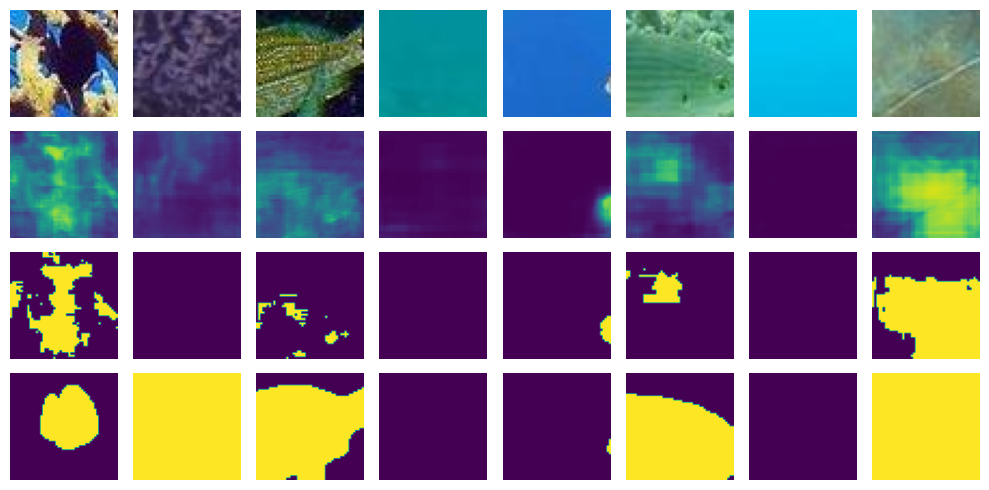

Epoch 1/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4409 - binary_accuracy: 0.7896 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4403 - binary_accuracy: 0.7901 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4403 - binary_accuracy: 0.7901 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


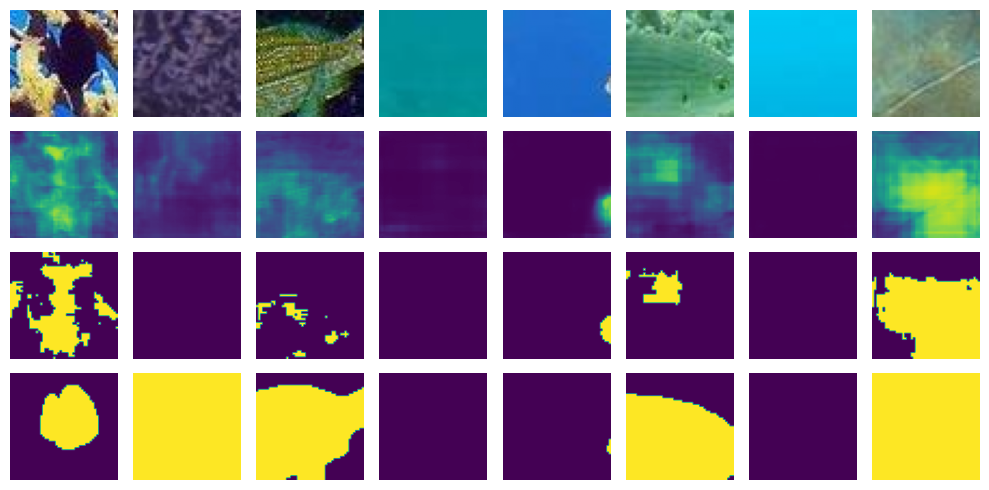

Epoch 1/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4399 - binary_accuracy: 0.7903 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4410 - binary_accuracy: 0.7894 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4403 - binary_accuracy: 0.7898 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


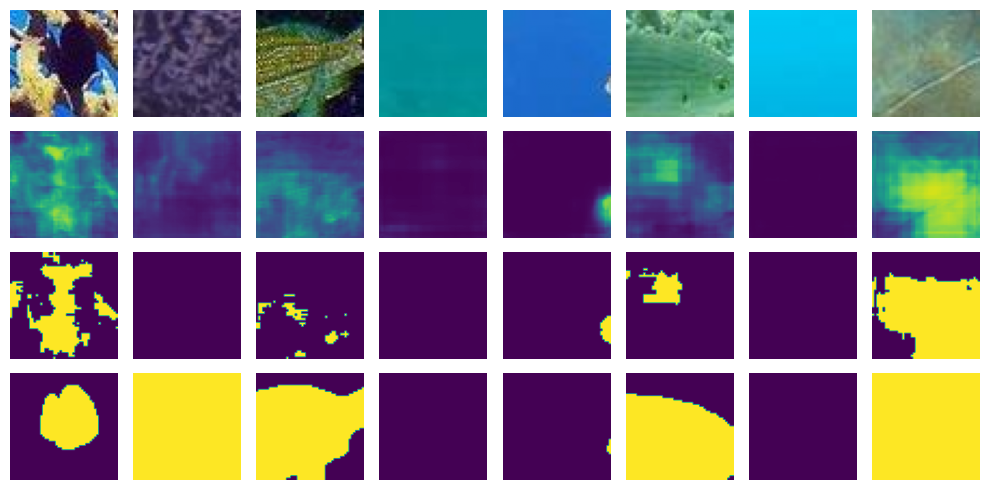

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4409 - binary_accuracy: 0.7896 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4411 - binary_accuracy: 0.7895 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4401 - binary_accuracy: 0.7900 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


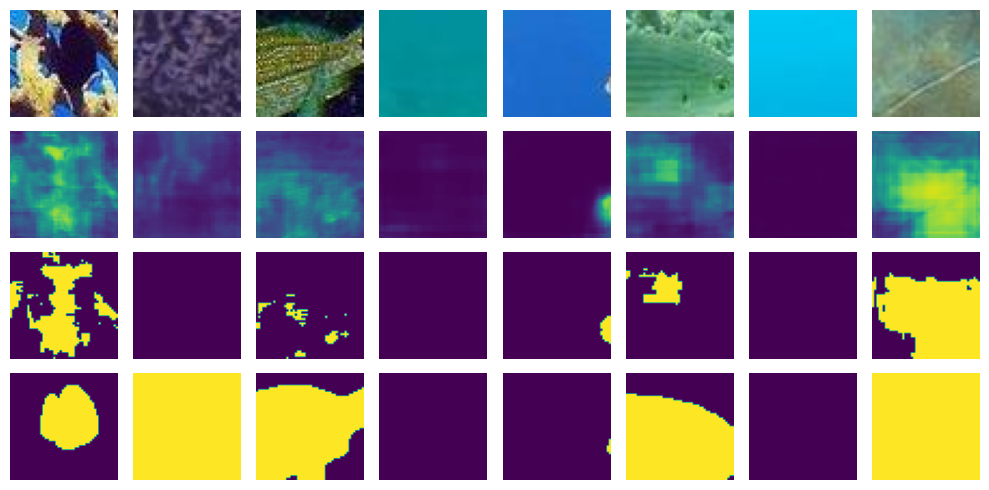

Epoch 1/4
203/203 [==============================] - 92s 454ms/step - loss: 0.4406 - binary_accuracy: 0.7899 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4409 - binary_accuracy: 0.7896 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4397 - binary_accuracy: 0.7902 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


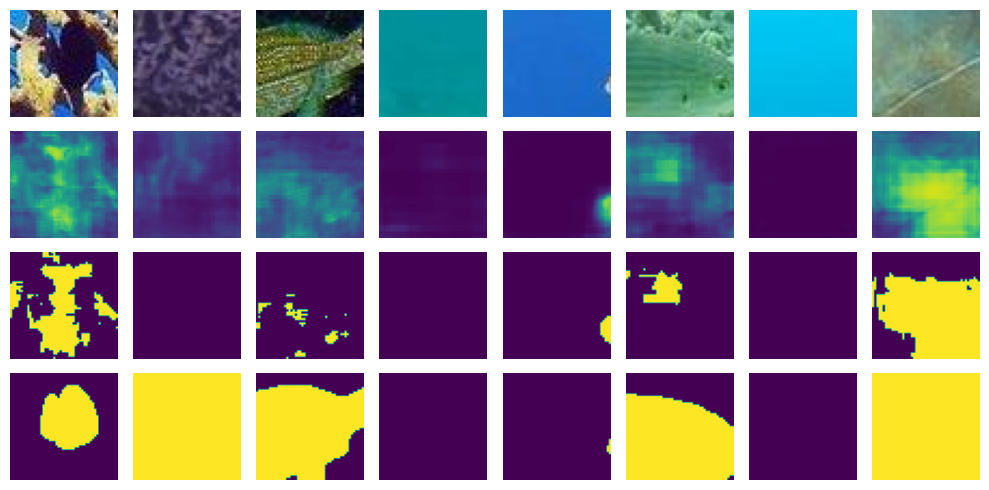

Epoch 1/4
203/203 [==============================] - 95s 467ms/step - loss: 0.4399 - binary_accuracy: 0.7904 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 95s 469ms/step - loss: 0.4396 - binary_accuracy: 0.7902 - val_loss: 0.4424 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 468ms/step - loss: 0.4402 - binary_accuracy: 0.7904 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 52ms/step


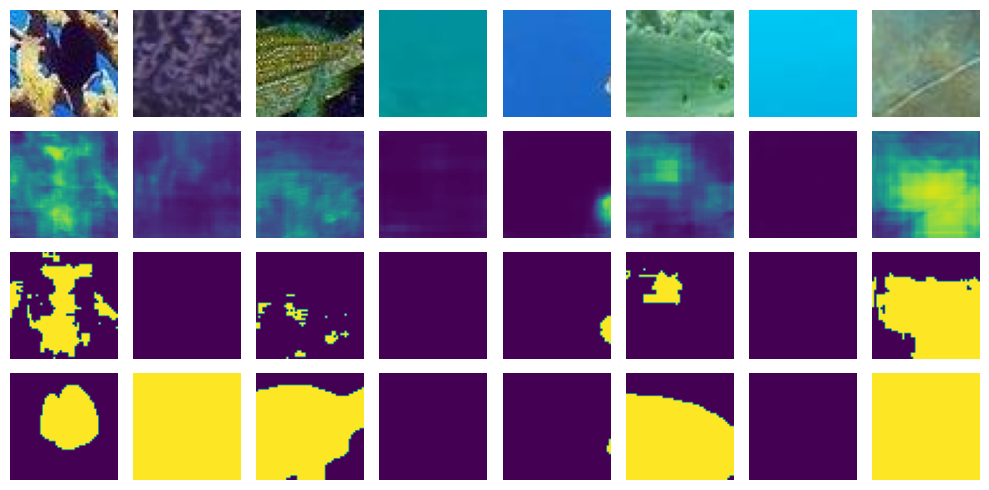

Epoch 1/4
203/203 [==============================] - 95s 467ms/step - loss: 0.4402 - binary_accuracy: 0.7902 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 95s 467ms/step - loss: 0.4404 - binary_accuracy: 0.7899 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 469ms/step - loss: 0.4402 - binary_accuracy: 0.7900 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 63ms/step


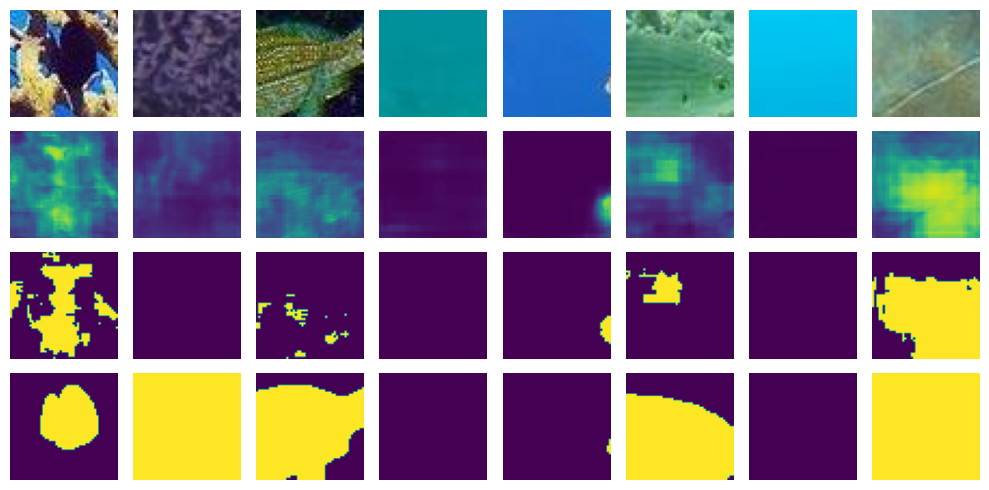

Epoch 1/4
203/203 [==============================] - 95s 468ms/step - loss: 0.4405 - binary_accuracy: 0.7901 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7903 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4400 - binary_accuracy: 0.7902 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 52ms/step


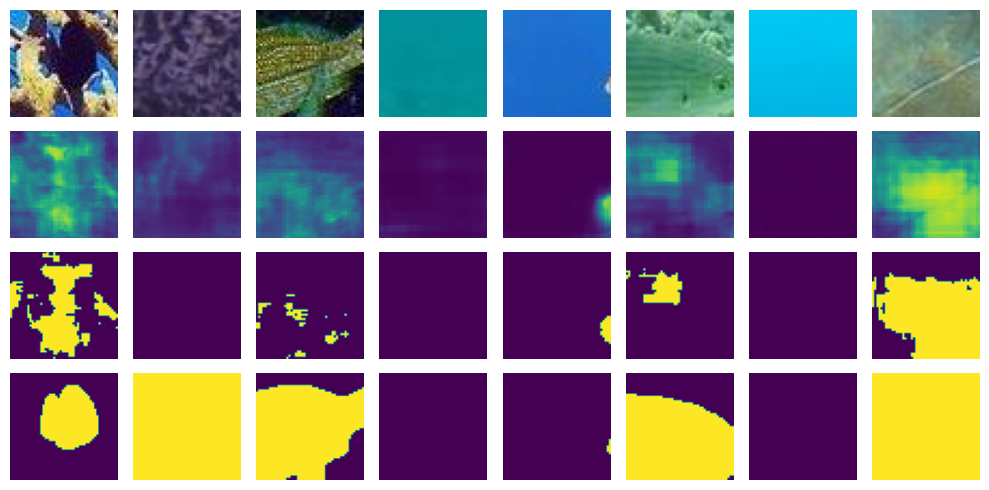

Epoch 1/4
203/203 [==============================] - 94s 460ms/step - loss: 0.4392 - binary_accuracy: 0.7904 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7903 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7904 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


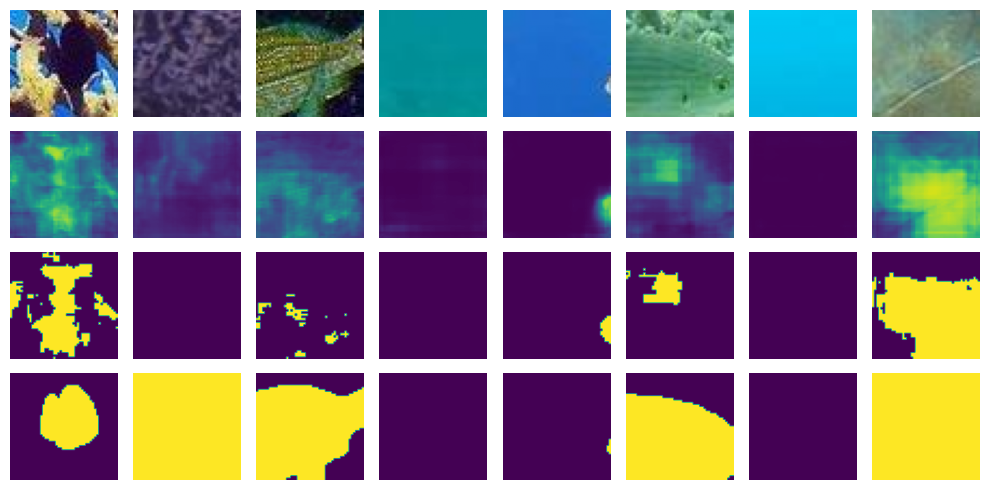

Epoch 1/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4398 - binary_accuracy: 0.7902 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7904 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4394 - binary_accuracy: 0.7904 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


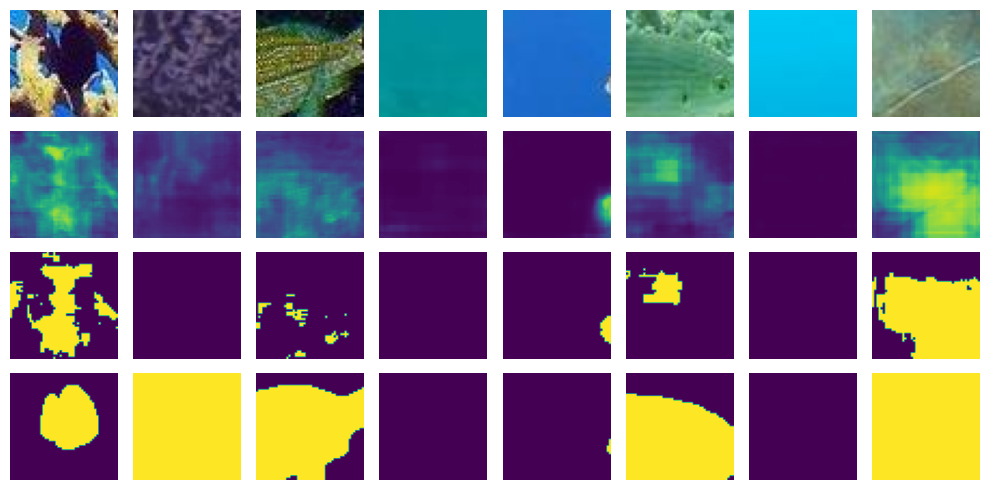

Epoch 1/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4395 - binary_accuracy: 0.7905 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4403 - binary_accuracy: 0.7899 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4400 - binary_accuracy: 0.7901 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 68ms/step


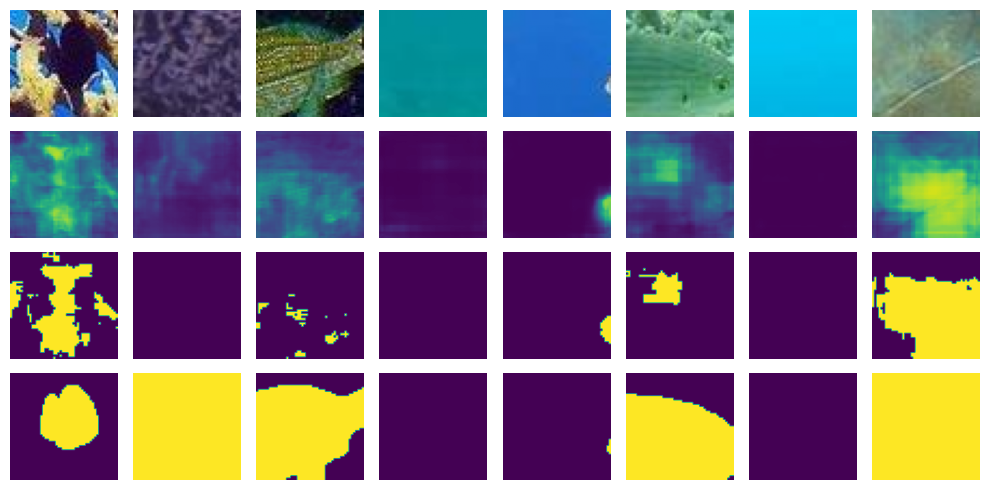

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7900 - val_loss: 0.4425 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4397 - binary_accuracy: 0.7903 - val_loss: 0.4425 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4389 - binary_accuracy: 0.7907 - val_loss: 0.4425 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


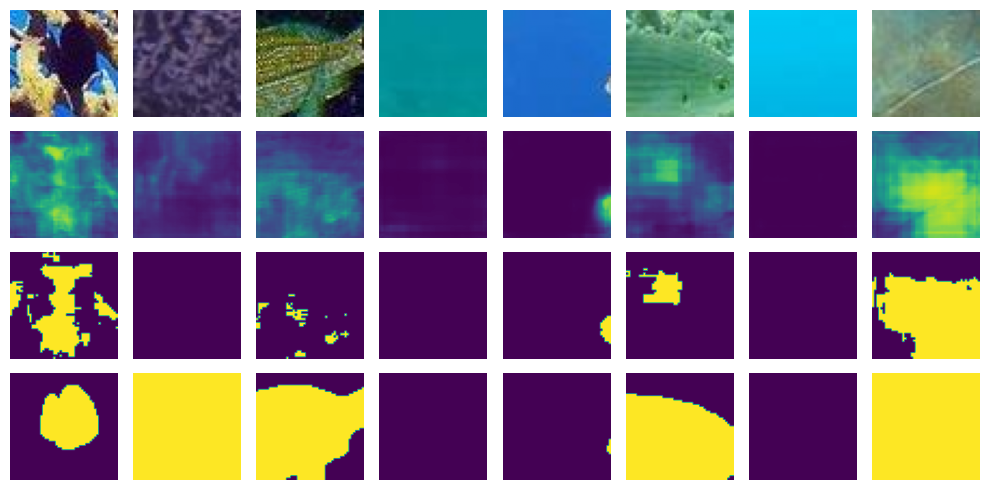

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7900 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4397 - binary_accuracy: 0.7905 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4392 - binary_accuracy: 0.7905 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


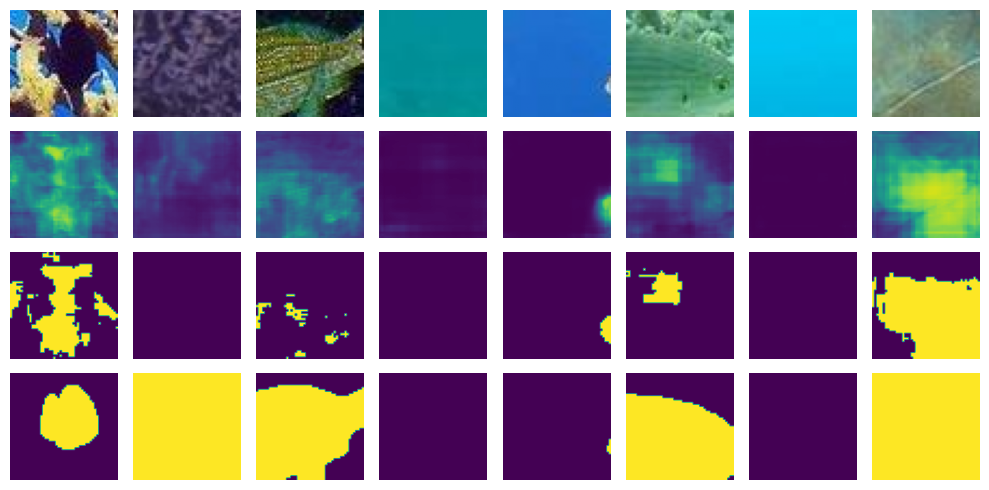

Epoch 1/4
203/203 [==============================] - 94s 464ms/step - loss: 0.4401 - binary_accuracy: 0.7900 - val_loss: 0.4426 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 460ms/step - loss: 0.4398 - binary_accuracy: 0.7902 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4393 - binary_accuracy: 0.7906 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


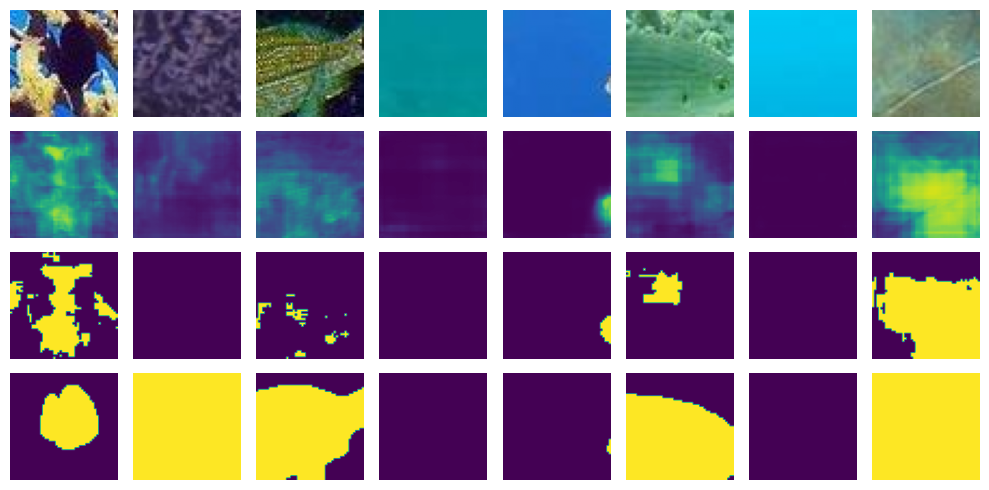

Epoch 1/4
203/203 [==============================] - 94s 464ms/step - loss: 0.4391 - binary_accuracy: 0.7907 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 95s 464ms/step - loss: 0.4391 - binary_accuracy: 0.7903 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4389 - binary_accuracy: 0.7905 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 56ms/step


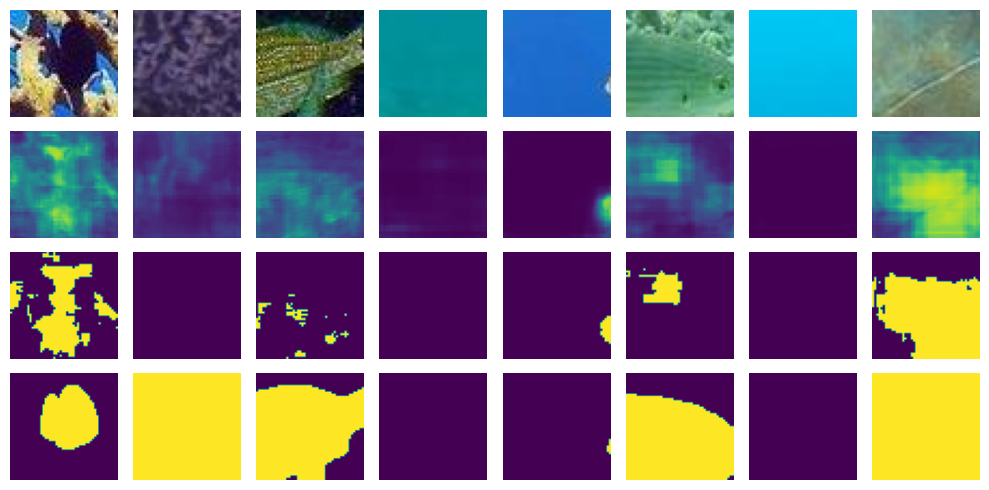

Epoch 1/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4395 - binary_accuracy: 0.7903 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4399 - binary_accuracy: 0.7902 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4390 - binary_accuracy: 0.7906 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 64ms/step


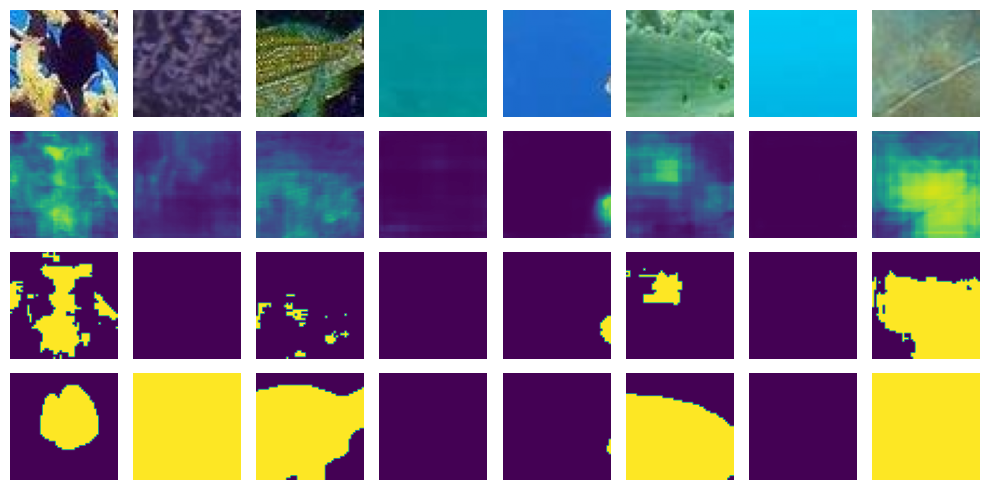

Epoch 1/4
203/203 [==============================] - 97s 474ms/step - loss: 0.4395 - binary_accuracy: 0.7904 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 96s 469ms/step - loss: 0.4396 - binary_accuracy: 0.7905 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4393 - binary_accuracy: 0.7904 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 60ms/step


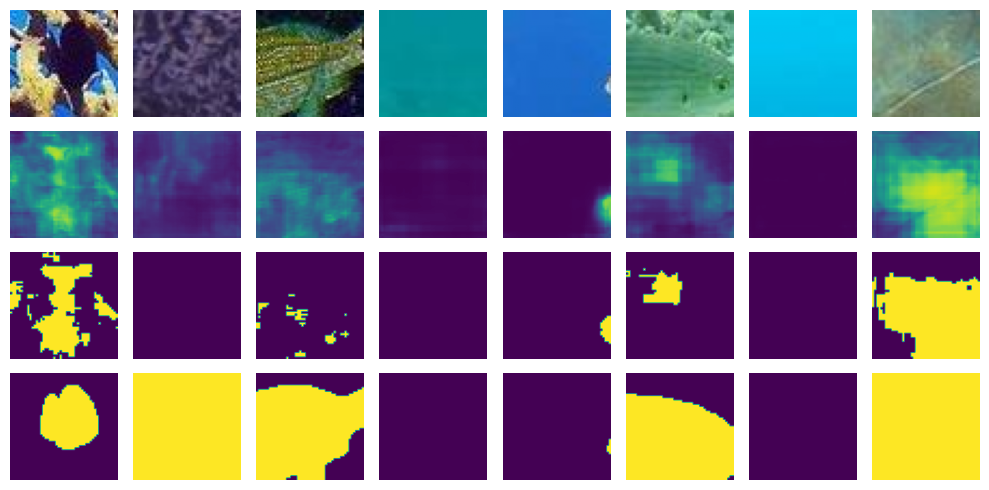

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4395 - binary_accuracy: 0.7904 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 96s 471ms/step - loss: 0.4388 - binary_accuracy: 0.7908 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 96s 474ms/step - loss: 0.4386 - binary_accuracy: 0.7912 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


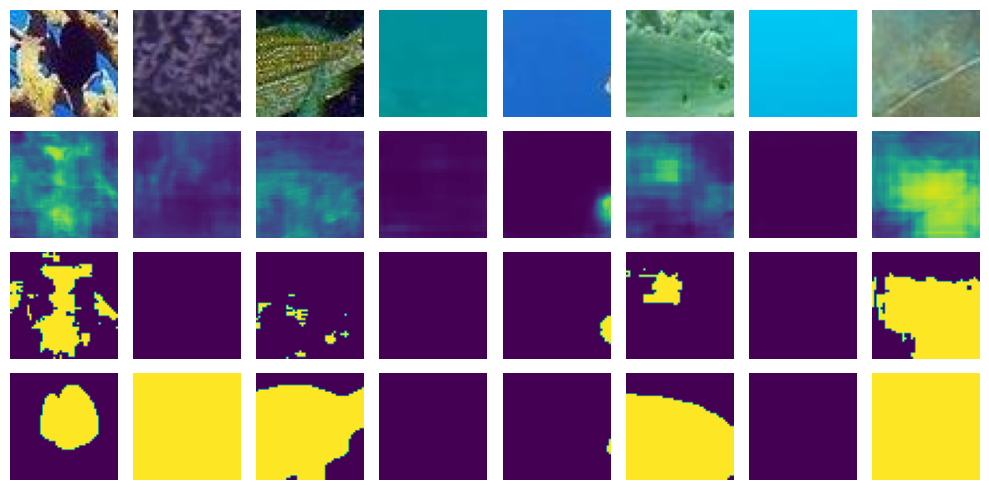

Epoch 1/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4391 - binary_accuracy: 0.7906 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 96s 472ms/step - loss: 0.4392 - binary_accuracy: 0.7903 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 467ms/step - loss: 0.4396 - binary_accuracy: 0.7903 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 56ms/step


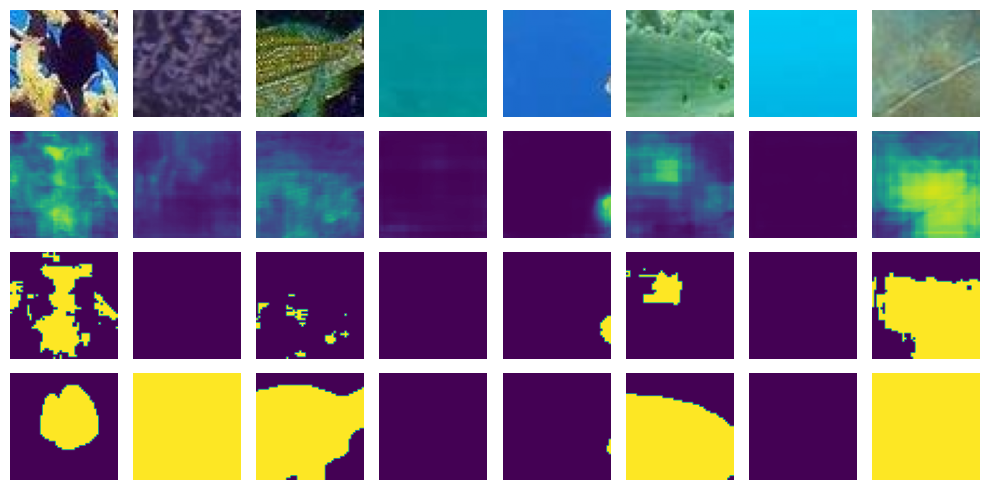

Epoch 1/4
203/203 [==============================] - 95s 464ms/step - loss: 0.4395 - binary_accuracy: 0.7903 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4394 - binary_accuracy: 0.7903 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4386 - binary_accuracy: 0.7909 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


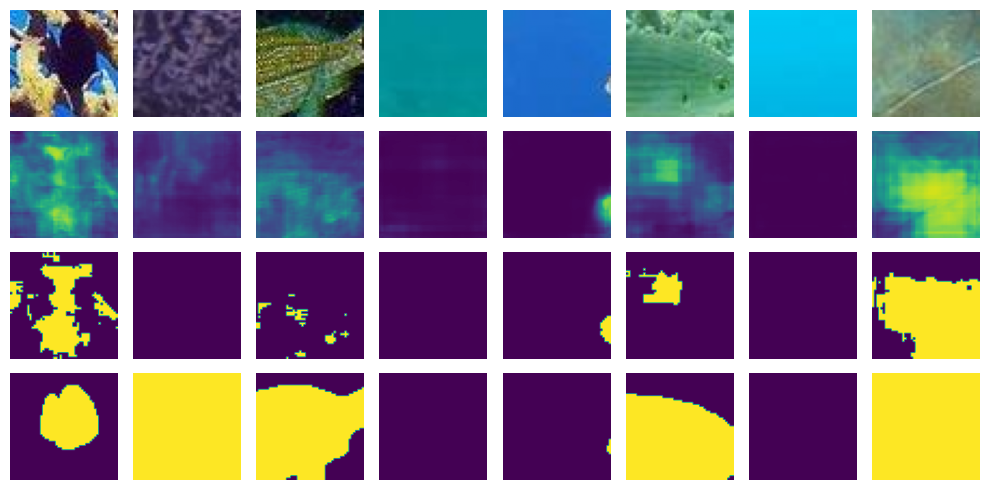

Epoch 1/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4386 - binary_accuracy: 0.7911 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4392 - binary_accuracy: 0.7906 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4389 - binary_accuracy: 0.7909 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 71ms/step


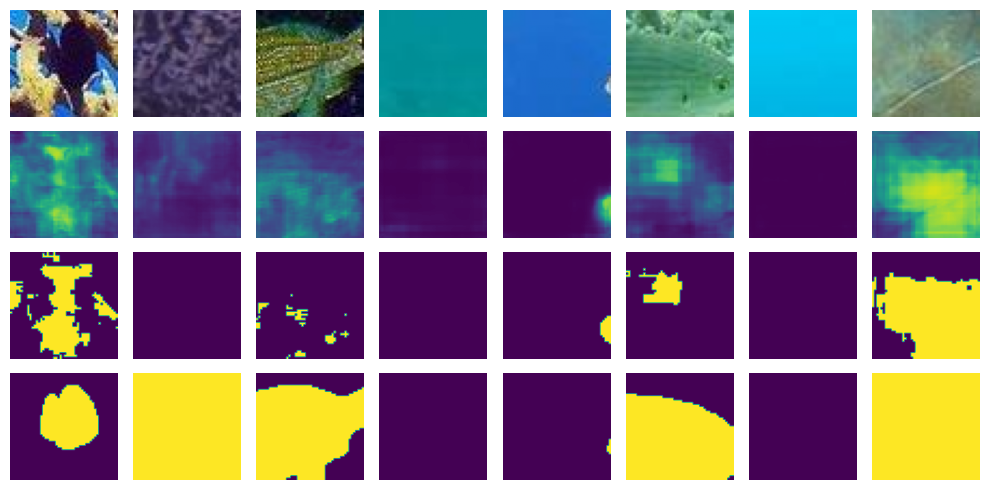

Epoch 1/4
203/203 [==============================] - 94s 460ms/step - loss: 0.4388 - binary_accuracy: 0.7913 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 464ms/step - loss: 0.4388 - binary_accuracy: 0.7907 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4393 - binary_accuracy: 0.7908 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


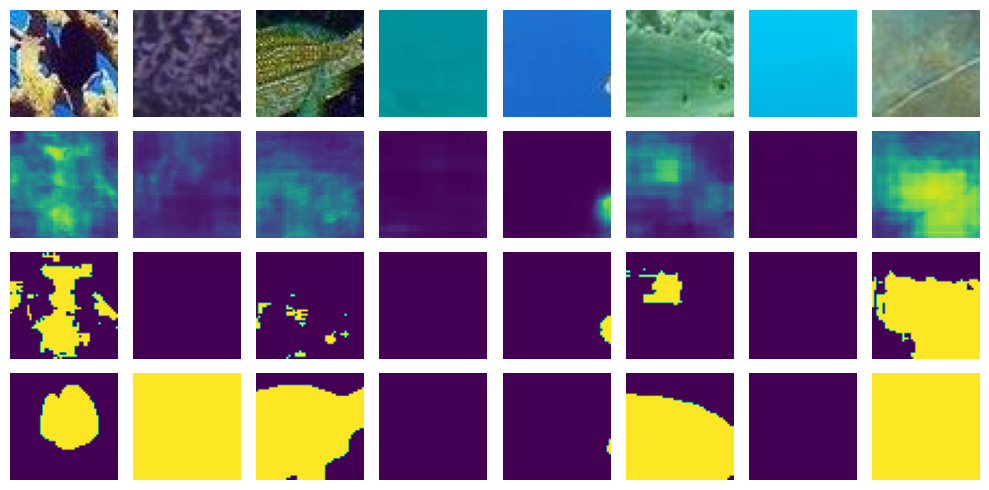

Epoch 1/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4386 - binary_accuracy: 0.7909 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4384 - binary_accuracy: 0.7911 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4391 - binary_accuracy: 0.7904 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


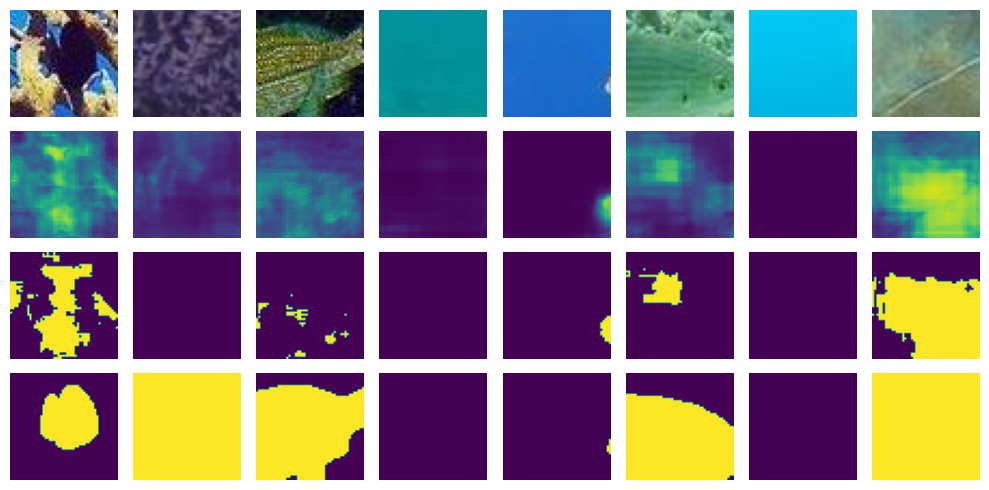

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4391 - binary_accuracy: 0.7909 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4383 - binary_accuracy: 0.7912 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 464ms/step - loss: 0.4387 - binary_accuracy: 0.7910 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 56ms/step


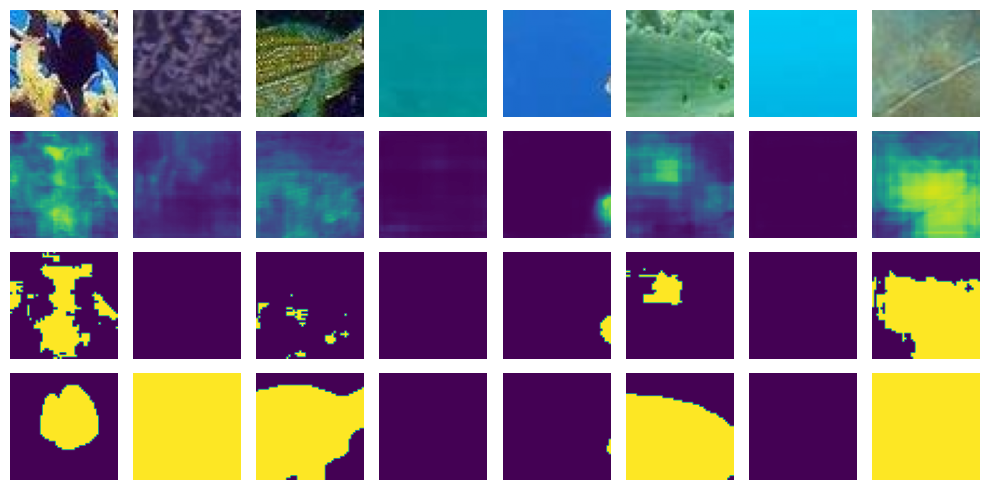

Epoch 1/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4388 - binary_accuracy: 0.7909 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4392 - binary_accuracy: 0.7905 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4388 - binary_accuracy: 0.7906 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


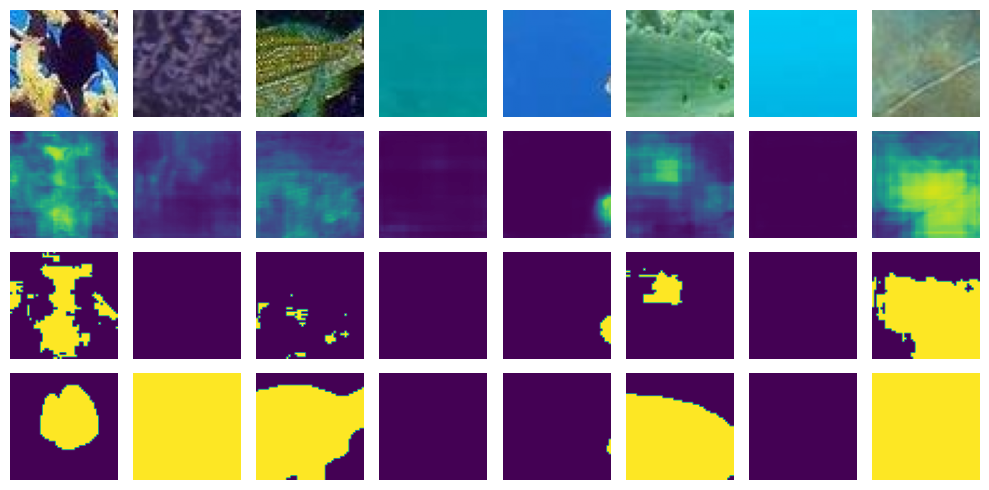

Epoch 1/4
203/203 [==============================] - 100s 493ms/step - loss: 0.4384 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 104s 510ms/step - loss: 0.4389 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 97s 478ms/step - loss: 0.4387 - binary_accuracy: 0.7907 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


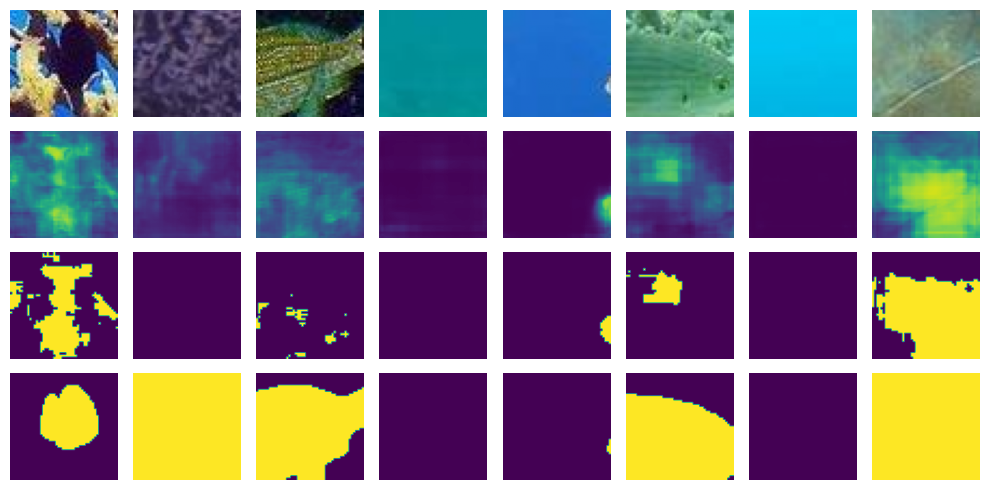

Epoch 1/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4387 - binary_accuracy: 0.7912 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4381 - binary_accuracy: 0.7913 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4394 - binary_accuracy: 0.7904 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 56ms/step


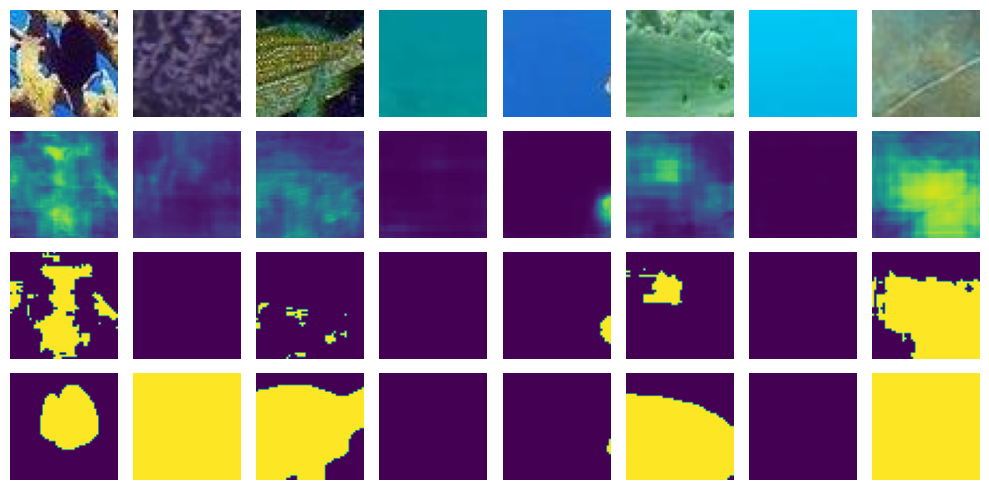

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4385 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4386 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4384 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 59ms/step


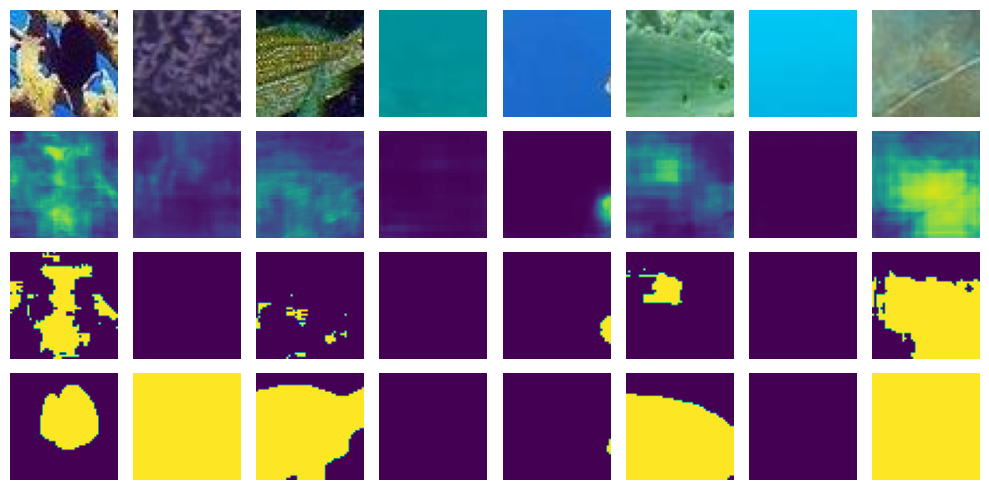

Epoch 1/4
203/203 [==============================] - 95s 464ms/step - loss: 0.4385 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 460ms/step - loss: 0.4381 - binary_accuracy: 0.7913 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4391 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


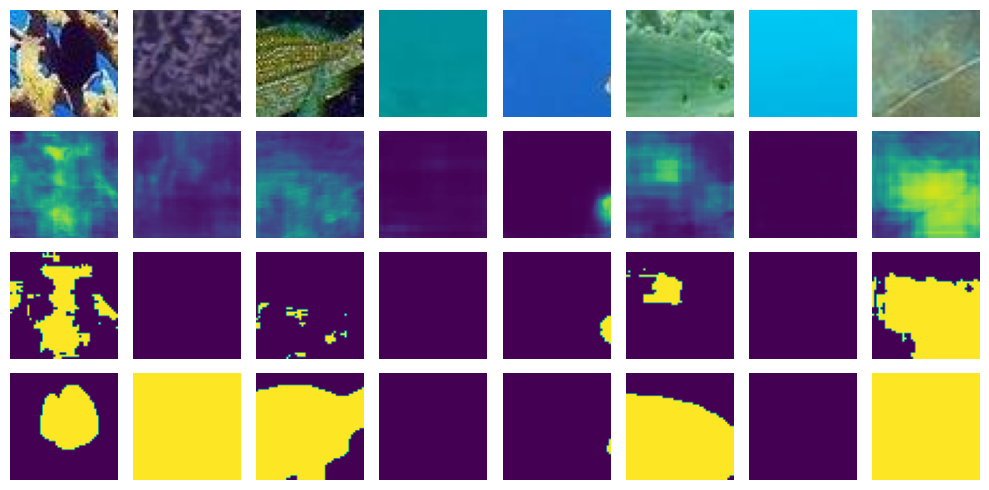

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4384 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4382 - binary_accuracy: 0.7915 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4381 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


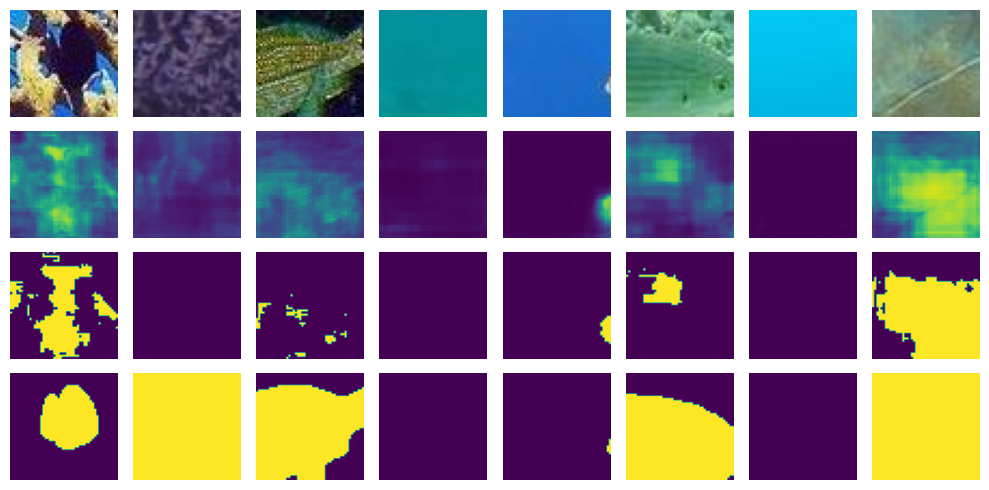

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4384 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4380 - binary_accuracy: 0.7914 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4387 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


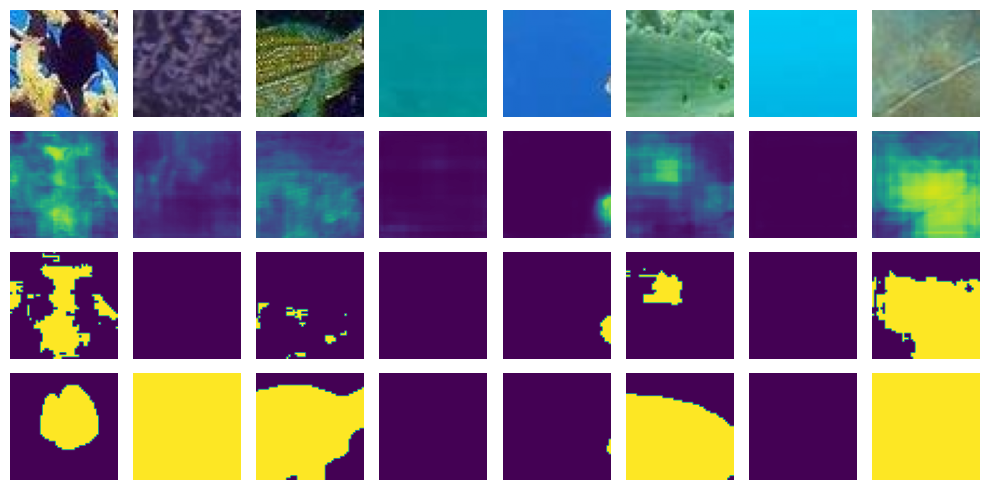

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4384 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4379 - binary_accuracy: 0.7913 - val_loss: 0.4429 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4382 - binary_accuracy: 0.7909 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


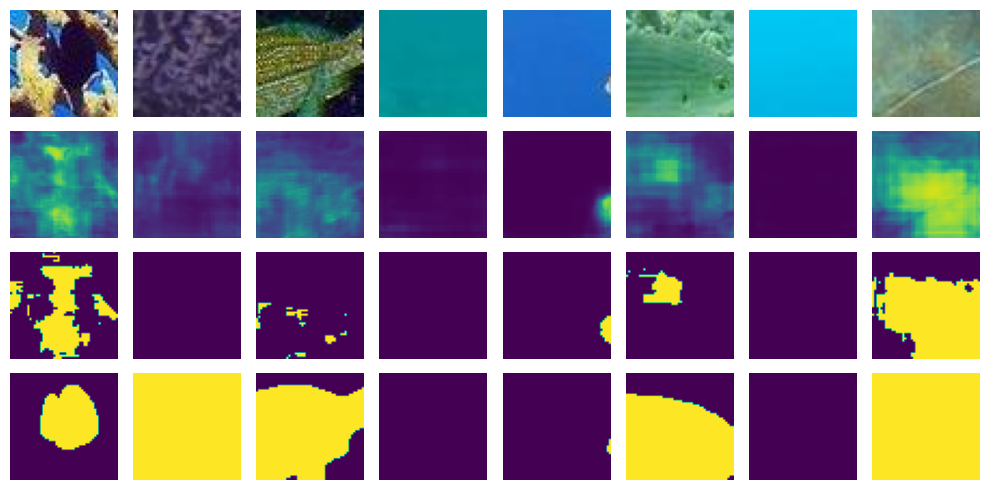

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4377 - binary_accuracy: 0.7915 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4377 - binary_accuracy: 0.7917 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4381 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 51ms/step


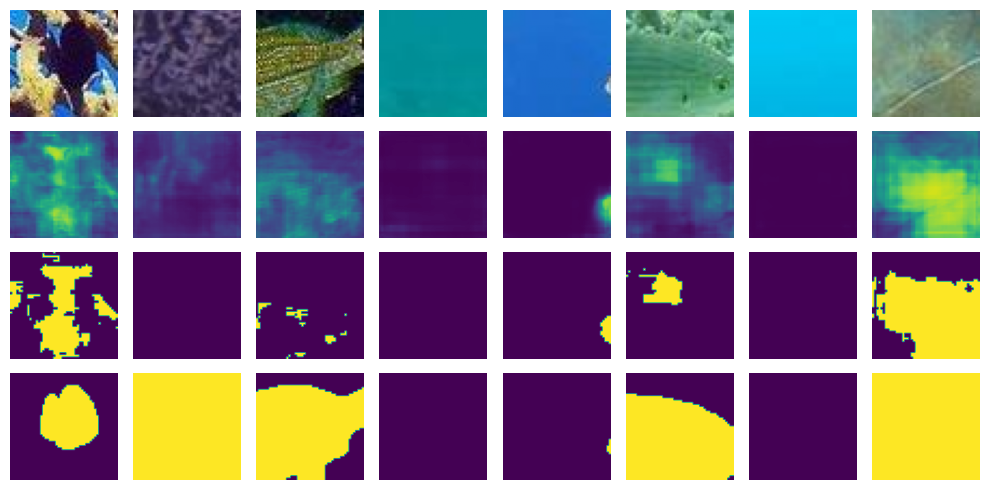

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4383 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4384 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4388 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


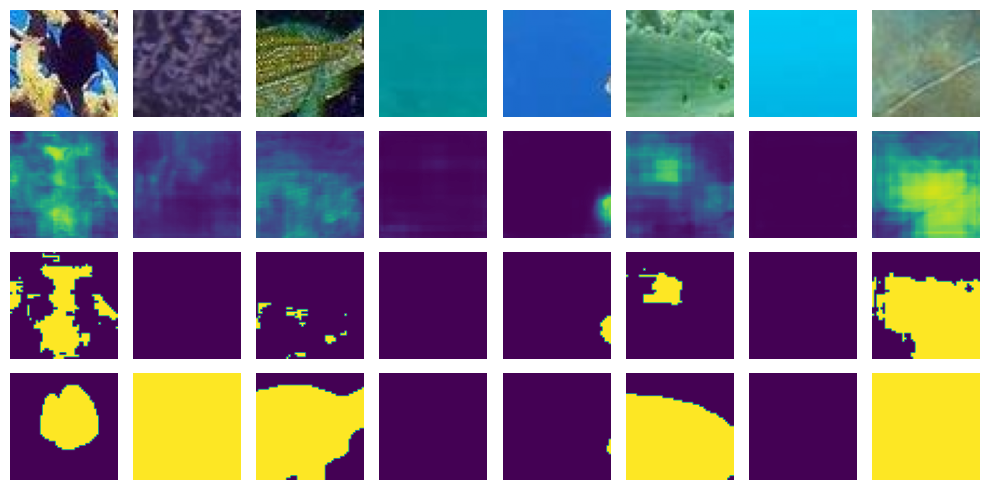

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4383 - binary_accuracy: 0.7911 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4385 - binary_accuracy: 0.7912 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4388 - binary_accuracy: 0.7908 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


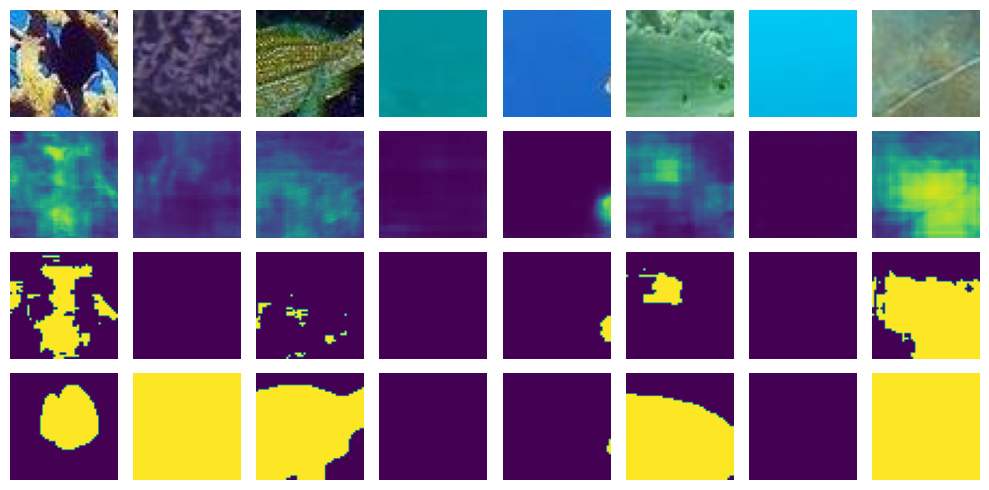

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4386 - binary_accuracy: 0.7909 - val_loss: 0.4429 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4381 - binary_accuracy: 0.7913 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4382 - binary_accuracy: 0.7913 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 52ms/step


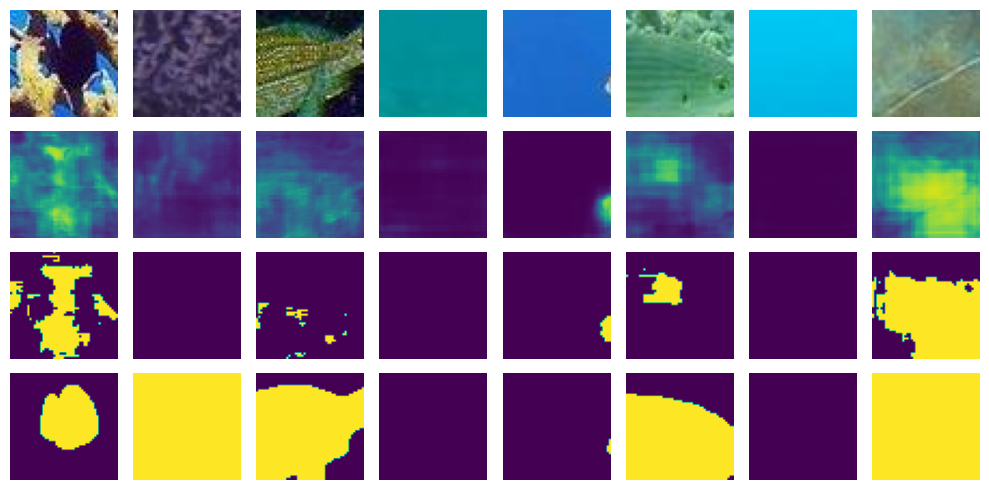

Epoch 1/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4378 - binary_accuracy: 0.7917 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4379 - binary_accuracy: 0.7915 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4381 - binary_accuracy: 0.7912 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


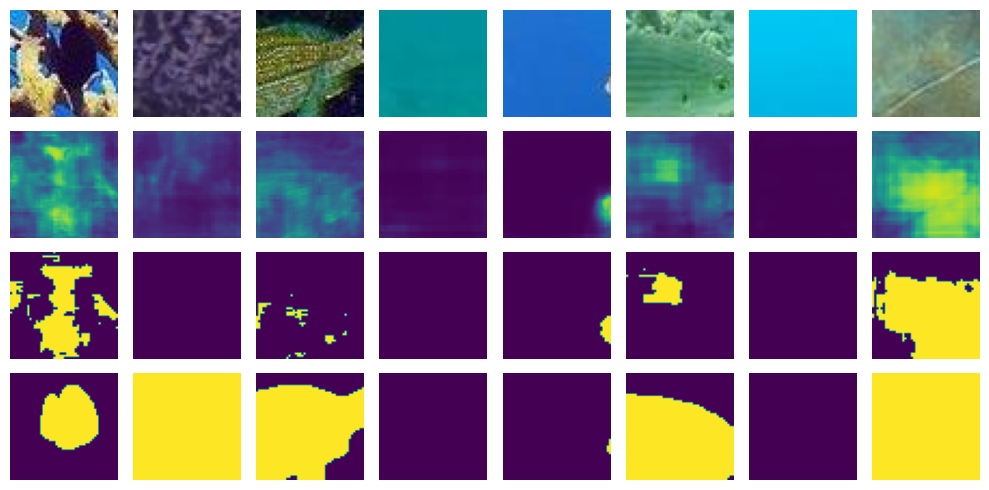

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4380 - binary_accuracy: 0.7912 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4384 - binary_accuracy: 0.7914 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4379 - binary_accuracy: 0.7911 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 50ms/step


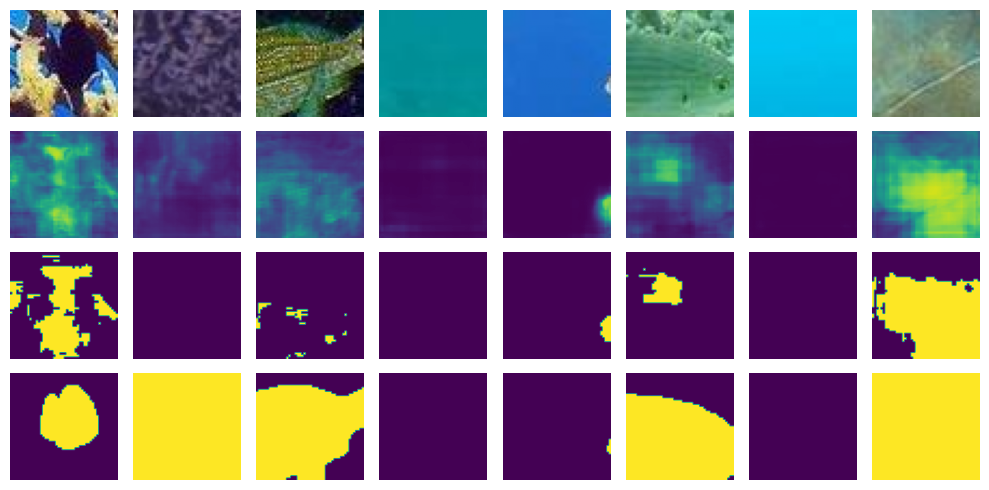

Epoch 1/4
203/203 [==============================] - 94s 459ms/step - loss: 0.4386 - binary_accuracy: 0.7907 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4382 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4381 - binary_accuracy: 0.7914 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


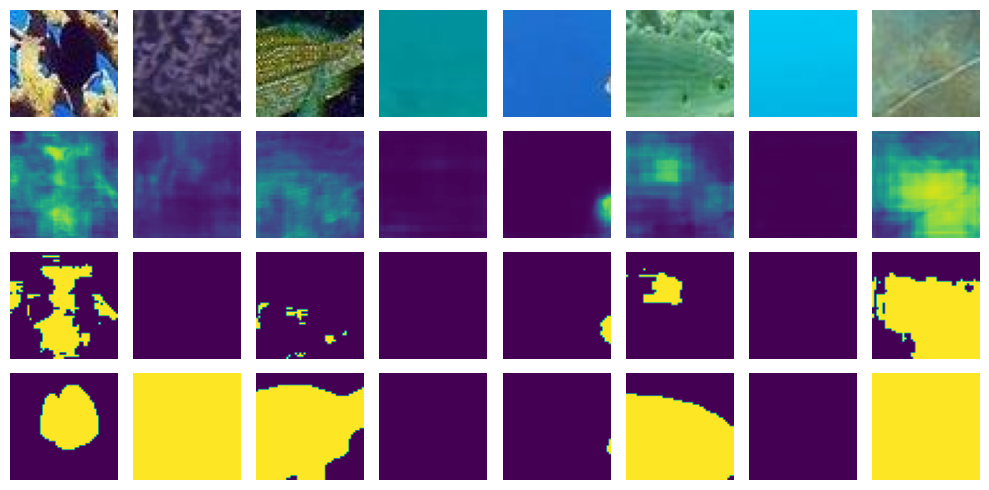

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4384 - binary_accuracy: 0.7912 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4381 - binary_accuracy: 0.7910 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4379 - binary_accuracy: 0.7916 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 60ms/step


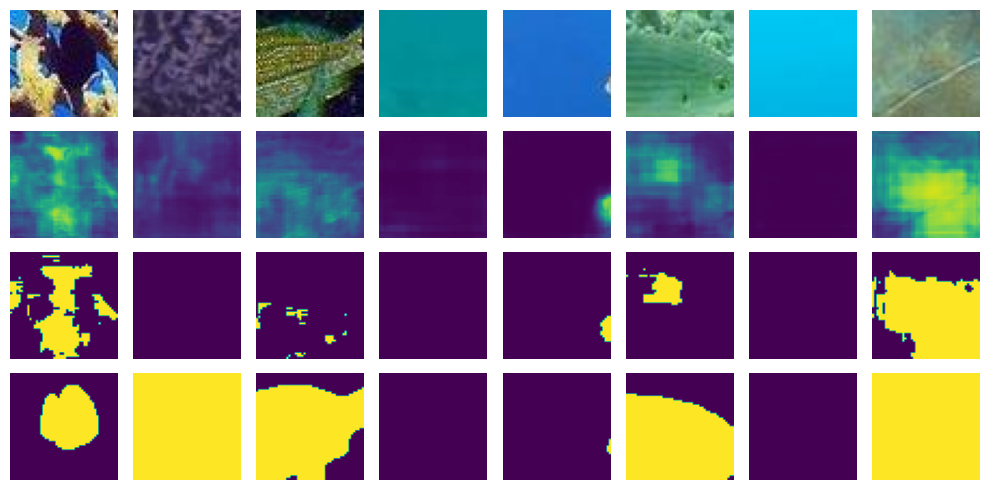

Epoch 1/4
203/203 [==============================] - 93s 459ms/step - loss: 0.4381 - binary_accuracy: 0.7913 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4376 - binary_accuracy: 0.7915 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4385 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


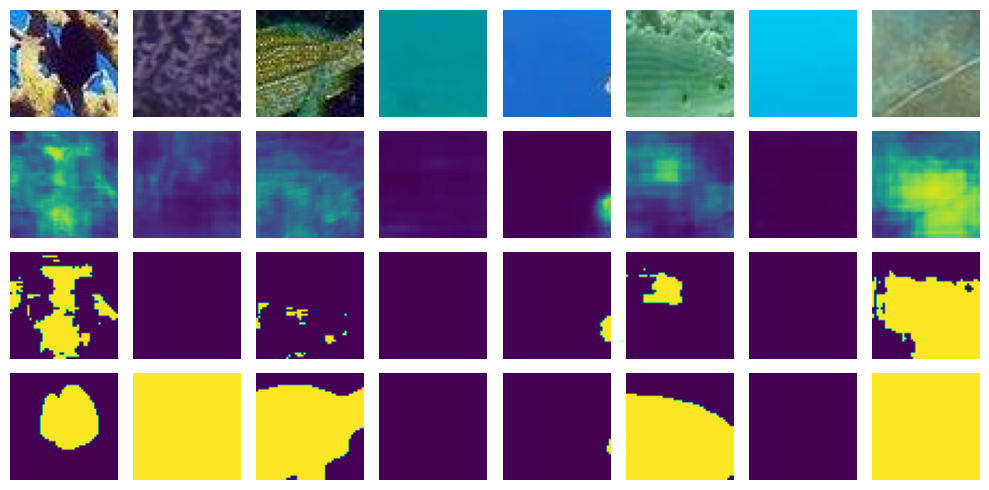

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4378 - binary_accuracy: 0.7913 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4373 - binary_accuracy: 0.7917 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4380 - binary_accuracy: 0.7913 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


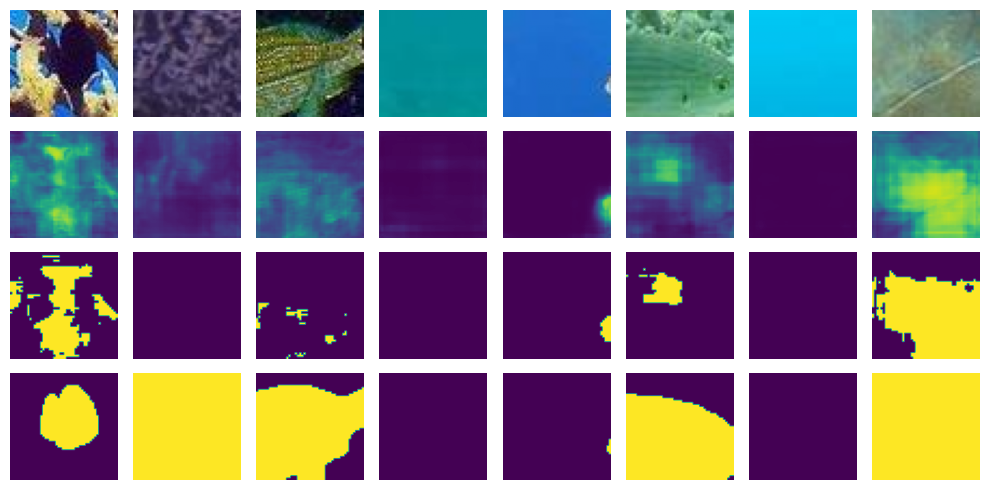

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4383 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4380 - binary_accuracy: 0.7914 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
 45/203 [=====>........................] - ETA: 1:02 - loss: 0.4387 - binary_accuracy: 0.7917

KeyboardInterrupt: 

In [ ]:
ntest = 8
batch_size = 128
(tx,ty) = next(iter(ds_te.batch(ntest)))
while(True):
    tyhat = model_unet.predict(tx)
    fig,axs = plt.subplots(nrows=4, ncols=ntest, figsize=(10,5))
    for ti in range(ntest):
        axs[0,ti].imshow(tx[ti])
        axs[1,ti].imshow(tyhat[ti,:,:,0], vmin=0, vmax=1)
        axs[2,ti].imshow(tyhat[ti,:,:,0]>0.5, vmin=0, vmax=1)
        axs[3,ti].imshow(ty[ti], vmin=0, vmax=1)
    for ax in axs.flatten():
        ax.axis("off")
    plt.tight_layout()
    plt.show()
    model_unet.fit(ds_s_tr.shuffle(1024).batch(batch_size), validation_data=ds_s_val.batch(batch_size), epochs=4, callbacks=callbacks)

## CNN example

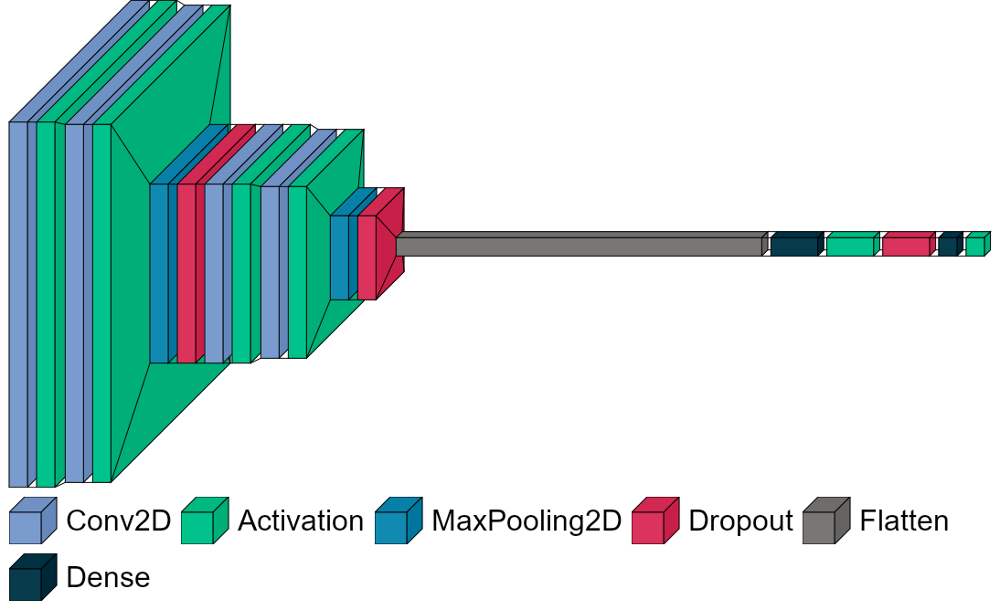

In [42]:

# ! example assignment
patchsize = 100
pool_size = (2, 2)  # size of pooling area for max pooling
kernel_size = (3, 3)  # convolution kernel size


def make_model_2(nb_filters=32):
    model = Sequential(name="cnn2")
    model.add(Conv2D(nb_filters, kernel_size, padding='same',
                     input_shape=(patchsize, patchsize, 3)))
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.25))

    model.add(Conv2D(nb_filters*2, kernel_size, padding='same'))
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters*2, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.25))

    model.add(Flatten())
    model.add(Dense(512))  # tweak
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1))
    model.add(Activation('sigmoid'))

    # For a 2-class classification problem
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=0.01),
        loss=keras.losses.BinaryCrossentropy(from_logits=False),
        metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)]
    )

    return model


filters = 32
model2 = make_model_2(filters)
visualkeras.layered_view(model2 , legend=True, font=font, color_map=color_map)
# model2.summary()

In [311]:
batch_size        = 64
epochs            = 25
augmented         = False
reduced           = True

model_name = "model_cnn2_red2"
callbacks = get_callbacks(model_name)

model2 = make_model_2(filters)
history2 = train_model(model2, epochs, batch_size, callbacks, augmented,reduced)

model2.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history2)

Epoch 1/25
402/402 [==============================] - 272s 666ms/step - loss: 1.0218 - binary_accuracy: 0.4979 - auc_16: 0.4959 - val_loss: 0.6931 - val_binary_accuracy: 0.4997 - val_auc_16: 0.5000 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 271s 673ms/step - loss: 0.6933 - binary_accuracy: 0.4988 - auc_16: 0.5017 - val_loss: 0.6936 - val_binary_accuracy: 0.4997 - val_auc_16: 0.5000 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 2221s 6s/step - loss: 0.6934 - binary_accuracy: 0.4976 - auc_16: 0.4971 - val_loss: 0.6932 - val_binary_accuracy: 0.4997 - val_auc_16: 0.5000 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 277s 688ms/step - loss: 0.6933 - binary_accuracy: 0.5020 - auc_16: 0.5005 - val_loss: 0.6931 - val_binary_accuracy: 0.5003 - val_auc_16: 0.5000 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 271s 673ms/step - loss: 0.6933 - binary_accuracy: 0.5021 - auc_16: 0.5049 - val_loss: 0.6931 - val_binar

In [312]:
batch_size        = 64
epochs            = 25
augmented         = True
reduced           = True

model_name = "model_cnn2_red2_aug"
callbacks = get_callbacks(model_name)

model2 = make_model_2(filters)
history2 = train_model(model2, epochs, batch_size, callbacks, augmented,reduced)

model2.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history2)

Epoch 1/25
402/402 [==============================] - 368s 905ms/step - loss: 0.6950 - binary_accuracy: 0.4973 - auc_17: 0.4971 - val_loss: 0.6934 - val_binary_accuracy: 0.4997 - val_auc_17: 0.5000 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 341s 847ms/step - loss: 0.6933 - binary_accuracy: 0.5014 - auc_17: 0.4991 - val_loss: 0.6934 - val_binary_accuracy: 0.5003 - val_auc_17: 0.5000 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 381s 948ms/step - loss: 0.6933 - binary_accuracy: 0.4988 - auc_17: 0.4983 - val_loss: 0.6933 - val_binary_accuracy: 0.4997 - val_auc_17: 0.5000 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 424s 1s/step - loss: 0.6933 - binary_accuracy: 0.5010 - auc_17: 0.5012 - val_loss: 0.6936 - val_binary_accuracy: 0.4997 - val_auc_17: 0.5000 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 400s 994ms/step - loss: 0.6934 - binary_accuracy: 0.4933 - auc_17: 0.4941 - val_loss: 0.6932 - val_binary

## CNN example tweaked

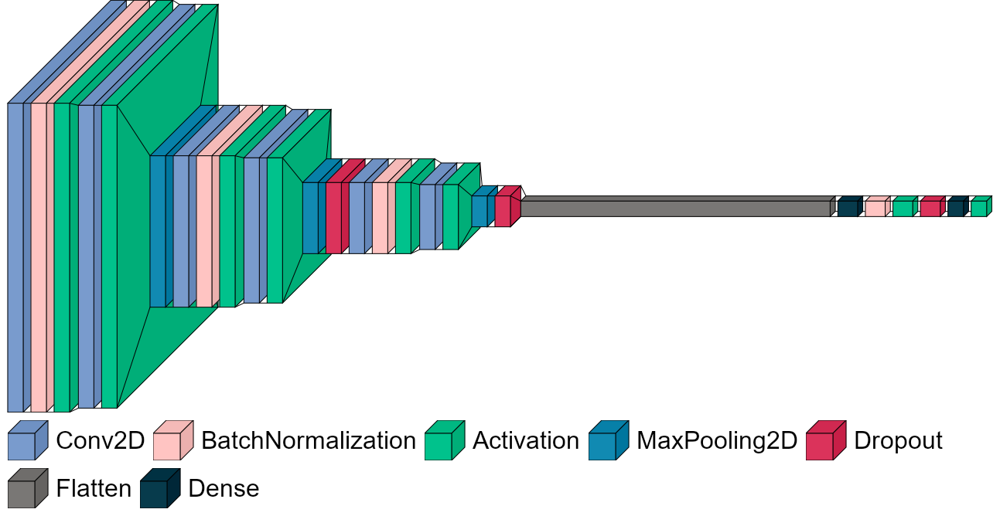

In [43]:

# ! example tweaked
patchsize = 100
pool_size = (2, 2)  # size of pooling area for max pooling
kernel_size = (3, 3)  # convolution kernel size


def make_model_2_2(nb_filters=32):
    model = Sequential(name="cnn2_2")
    model.add(Conv2D(nb_filters, kernel_size, padding='same',
                    input_shape=(patchsize, patchsize, 3)))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))

    model.add(Conv2D(nb_filters*2, kernel_size, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters*2, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.25))

    model.add(Conv2D(nb_filters*4, kernel_size, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters*4, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.4))

    model.add(Flatten())
    model.add(Dense(256))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1))
    model.add(Activation('sigmoid'))
    
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=0.01),
        loss=keras.losses.BinaryCrossentropy(from_logits=False),
        metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)]
    )
    
    return model
    
filters = 32
model2_2 = make_model_2_2(filters)
visualkeras.layered_view(model2_2 , legend=True, font=font, color_map=color_map)  
# model2_2.summary()

In [314]:
batch_size        = 64
epochs            = 25
augmented         = False
reduced           = True

model_name = "model_cnn2_2_red2"
callbacks = get_callbacks(model_name)

model2_2 = make_model_2_2(filters)
history2_2 = train_model(model2_2, epochs, batch_size, callbacks, augmented,reduced)

model2_2.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history2_2)

Epoch 1/25
402/402 [==============================] - 460s 1s/step - loss: 0.7064 - binary_accuracy: 0.5479 - auc_19: 0.5684 - val_loss: 0.6632 - val_binary_accuracy: 0.5851 - val_auc_19: 0.6348 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 431s 1s/step - loss: 0.6665 - binary_accuracy: 0.5828 - auc_19: 0.6237 - val_loss: 0.6151 - val_binary_accuracy: 0.6643 - val_auc_19: 0.7650 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 458s 1s/step - loss: 0.6222 - binary_accuracy: 0.6414 - auc_19: 0.7045 - val_loss: 0.5988 - val_binary_accuracy: 0.6517 - val_auc_19: 0.7392 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 456s 1s/step - loss: 0.5876 - binary_accuracy: 0.6717 - auc_19: 0.7468 - val_loss: 0.5304 - val_binary_accuracy: 0.7198 - val_auc_19: 0.8101 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 457s 1s/step - loss: 0.5707 - binary_accuracy: 0.6848 - auc_19: 0.7647 - val_loss: 0.5911 - val_binary_accuracy: 0

In [315]:
batch_size        = 64
epochs            = 25
augmented         = True
reduced           = True

model_name = "model_cnn2_2_red2_aug"
callbacks = get_callbacks(model_name)

model2_2 = make_model_2_2(filters)
history2_2 = train_model(model2_2, epochs, batch_size, callbacks, augmented,reduced)

model2_2.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history2_2)

Epoch 1/25
402/402 [==============================] - 535s 1s/step - loss: 0.7386 - binary_accuracy: 0.4940 - auc_20: 0.4934 - val_loss: 0.7445 - val_binary_accuracy: 0.4917 - val_auc_20: 0.4977 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 562s 1s/step - loss: 0.7115 - binary_accuracy: 0.5042 - auc_20: 0.5036 - val_loss: 0.7506 - val_binary_accuracy: 0.5169 - val_auc_20: 0.5344 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 417s 1s/step - loss: 0.7015 - binary_accuracy: 0.4962 - auc_20: 0.4972 - val_loss: 0.8272 - val_binary_accuracy: 0.5023 - val_auc_20: 0.5059 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 364s 904ms/step - loss: 0.6961 - binary_accuracy: 0.5027 - auc_20: 0.5011 - val_loss: 0.6952 - val_binary_accuracy: 0.5467 - val_auc_20: 0.5569 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 334s 830ms/step - loss: 0.6956 - binary_accuracy: 0.5040 - auc_20: 0.5022 - val_loss: 0.9862 - val_binary_accur

## CNN ours

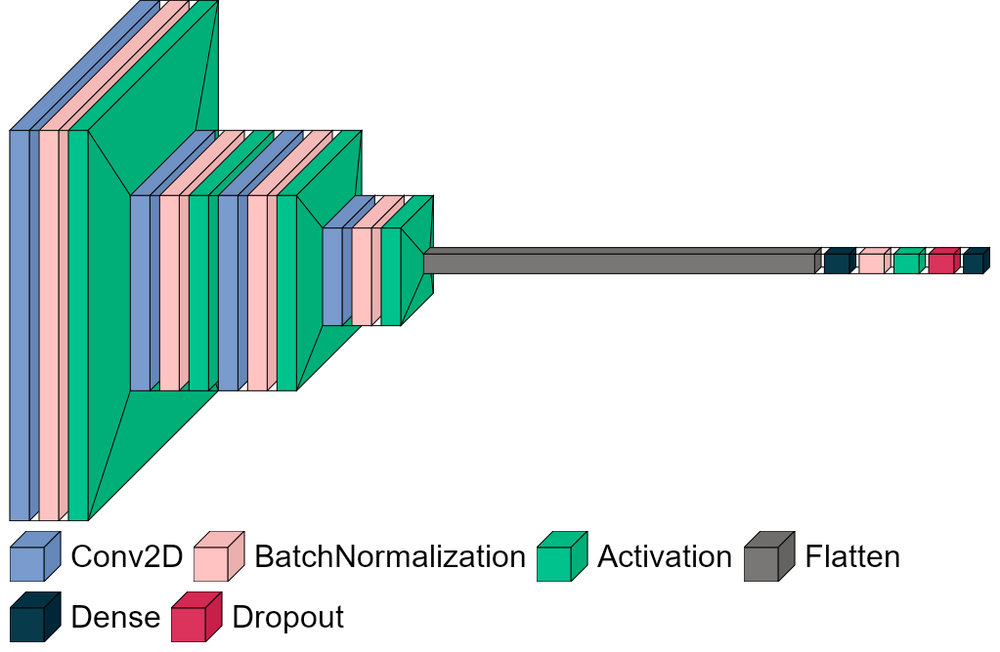

In [46]:

# ! our own model
patch_size          = 100
strides            = (2,2) # size for strides in convolution
kernel_size        = (3,3) # convolution kernel size

def make_model_3(nb_filters=32):
    model = Sequential(name="cnn3")
    model.add(Conv2D(nb_filters, kernel_size, padding='same', 
                     input_shape=(patch_size,patch_size, 3)))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters, kernel_size, strides=strides, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    
    model.add(Conv2D(nb_filters*2, kernel_size, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters*2, kernel_size, strides=strides, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    
    model.add(Flatten())
    model.add(Dense(256))  #tweak
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))

    # Model Compilation
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=0.01),
        loss=keras.losses.BinaryCrossentropy(from_logits=False),
        metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)]
    )
    
    return model

filters = 32
model3 = make_model_3(filters)
visualkeras.layered_view(model3 , legend=True, font=font, color_map=color_map)  
# model3.summary()

In [317]:
batch_size        = 64
epochs            = 25
augmented         = False
reduced           = True

model_name = "model_cnn3_red2"
callbacks = get_callbacks(model_name)

model3 = make_model_3(filters)
history3 = train_model(model3, epochs, batch_size, callbacks, augmented, reduced)

model3.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history3)

Epoch 1/25
402/402 [==============================] - 181s 434ms/step - loss: 0.6911 - binary_accuracy: 0.5818 - auc_22: 0.6121 - val_loss: 0.6541 - val_binary_accuracy: 0.6320 - val_auc_22: 0.6960 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 173s 431ms/step - loss: 0.6394 - binary_accuracy: 0.6297 - auc_22: 0.6840 - val_loss: 0.5779 - val_binary_accuracy: 0.6921 - val_auc_22: 0.7755 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 173s 429ms/step - loss: 0.6204 - binary_accuracy: 0.6535 - auc_22: 0.7129 - val_loss: 0.5975 - val_binary_accuracy: 0.6784 - val_auc_22: 0.7480 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 172s 429ms/step - loss: 0.6029 - binary_accuracy: 0.6681 - auc_22: 0.7362 - val_loss: 0.5645 - val_binary_accuracy: 0.6971 - val_auc_22: 0.7968 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 181s 450ms/step - loss: 0.5700 - binary_accuracy: 0.6986 - auc_22: 0.7723 - val_loss: 0.5505 - val_bin

In [318]:
batch_size        = 64
epochs            = 25
augmented         = True
reduced           = True

model_name = "model_cnn3_red2_aug"
callbacks = get_callbacks(model_name)

model3 = make_model_3(filters)
history3 = train_model(model3, epochs, batch_size, callbacks, augmented,reduced)

model3.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history3)

Epoch 1/25
402/402 [==============================] - 246s 595ms/step - loss: 0.7534 - binary_accuracy: 0.4947 - auc_23: 0.4964 - val_loss: 14.8644 - val_binary_accuracy: 0.5008 - val_auc_23: 0.5035 - lr: 0.0100
Epoch 2/25
402/402 [==============================] - 240s 595ms/step - loss: 0.7151 - binary_accuracy: 0.5046 - auc_23: 0.5040 - val_loss: 13.7616 - val_binary_accuracy: 0.5008 - val_auc_23: 0.5010 - lr: 0.0100
Epoch 3/25
402/402 [==============================] - 235s 583ms/step - loss: 0.7042 - binary_accuracy: 0.5056 - auc_23: 0.5075 - val_loss: 17.4230 - val_binary_accuracy: 0.5008 - val_auc_23: 0.4990 - lr: 0.0100
Epoch 4/25
402/402 [==============================] - 238s 592ms/step - loss: 0.6994 - binary_accuracy: 0.5039 - auc_23: 0.5021 - val_loss: 2.2466 - val_binary_accuracy: 0.4997 - val_auc_23: 0.5328 - lr: 0.0100
Epoch 5/25
402/402 [==============================] - 300s 746ms/step - loss: 0.6955 - binary_accuracy: 0.5000 - auc_23: 0.4983 - val_loss: 6.9351 - val_

# FCNN

## Preparing dataset

In [57]:
def get_patches(name, set_="train_val",red=False):
    if red:
        patches_path = pathlib.Path(ddir, set_, "patches","reduced")
    else:
        patches_path = pathlib.Path(ddir, set_, "patches")
    patch = skimage.img_as_float(skimage.io.imread(pathlib.Path(patches_path,"images", f"{name}.jpg")))
    mask = skimage.img_as_float(skimage.io.imread(pathlib.Path(patches_path, "masks", f"{name}.bmp")))
    mask_fish = np.all(mask == (1, 1, 0), axis=-1)
    return (patch,mask_fish)

In [73]:
# def save_masks(set_="train_val"):
#     for file in tqdm(pathlib.Path(ddir, set_, "patches","reduced", "images").iterdir()):
#         if file.is_file() and not pathlib.Path(ddir, set_, "patches","reduced", "masks", f"{file.name[:-4]}.bmp").is_file():
#             orig_name = '_'.join(file.name.split("_")[:3])
#             ignore = 25
#             r,c = [int(p)//2 for p in file.name.split("_")[4].split("x")]
#             mask = skimage.img_as_float(skimage.io.imread(pathlib.Path(ddir, set_,"masks", f"{orig_name}_.bmp")))
#             mask = skimage.transform.resize(mask, (int(mask.shape[0]//2), int(mask.shape[1]//2),3))
#             mask_patch = mask[r-ignore: r+ignore, c-ignore: c+ignore]
#             skimage.io.imsave(
#                 pathlib.Path(ddir, set_, "patches","reduced", "masks", f"{file.name[:-4]}.bmp"),
#                 skimage.img_as_ubyte(mask_patch),
#                 check_contrast=False,
#             )

# save_masks("train_val")
# save_masks("test")

0it [00:00, ?it/s]

In [75]:
# ds_train = [get_patches(name, "train_val") for name in tqdm(get_filenames("train_val", "patches/images"),desc="train_val")]
# ds_test = [get_patches(name, "test") for name in tqdm(get_filenames("test", "patches/images"),desc="test")]

ds_red_train = [get_patches(name, "train_val",True) for name in tqdm(get_filenames("train_val", "patches/reduced/images"),desc="train_val")]
ds_red_test = [get_patches(name, "test",True) for name in tqdm(get_filenames("test", "patches/reduced/images"),desc="test")]

train_val:   0%|          | 0/37128 [00:00<?, ?it/s]

test:   0%|          | 0/2856 [00:00<?, ?it/s]

In [48]:
# assume list with tuples of (image,annotation)
ds_tr = tf.data.Dataset.from_tensor_slices((
    [d[0] for d in ds_train],
    [d[1] for d in ds_train]))
ds_tr = ds_tr.shuffle(buffer_size=len(ds_tr))

ds_te = tf.data.Dataset.from_tensor_slices((
    [d[0] for d in ds_test],
    [d[1] for d in ds_test]))
ds_te = ds_te.shuffle(buffer_size=len(ds_te))

print(len(ds_train), ds_train[0][0].shape, ds_train[0][1].shape)
print(ds_train[0][0].dtype, ds_train[0][1].dtype)
print(len(ds_tr),len(ds_te))

37093 (50, 50, 3) (50, 50)
float64 bool
37093 2828


In [ ]:
# assume list with tuples of (image,annotation)
ds_red_tr = tf.data.Dataset.from_tensor_slices((
    [d[0] for d in ds_red_train],
    [d[1] for d in ds_red_train]))
ds_red_tr = ds_red_tr.shuffle(buffer_size=len(ds_red_tr))

ds_red_te = tf.data.Dataset.from_tensor_slices((
    [d[0] for d in ds_red_test],
    [d[1] for d in ds_red_test]))
ds_red_te = ds_red_te.shuffle(buffer_size=len(ds_red_te))

print(len(ds_red_train), ds_red_train[0][0].shape, ds_red_train[0][1].shape)
print(ds_red_train[0][0].dtype, ds_red_train[0][1].dtype)

print(len(ds_red_tr),len(ds_red_te))

In [65]:
ds_tr.save(pathlib.Path(ddir,"npy","dataset_train").as_posix())
ds_te.save(pathlib.Path(ddir,"npy","dataset_test").as_posix())
ds_red_tr.save(pathlib.Path(ddir,"npy","dataset_reduced_train").as_posix())
ds_red_te.save(pathlib.Path(ddir,"npy","dataset_reduced_test").as_posix())

del ds_train, ds_test
del ds_red_train, ds_red_test

In [78]:
ds_tr = tf.data.Dataset.load(pathlib.Path(ddir,"npy","dataset_train").as_posix())
ds_te = tf.data.Dataset.load(pathlib.Path(ddir,"npy","dataset_test").as_posix())
ds_red_tr = tf.data.Dataset.load(pathlib.Path(ddir,"npy","dataset_reduced_train").as_posix())
ds_red_te = tf.data.Dataset.load(pathlib.Path(ddir,"npy","dataset_reduced_test").as_posix())

In [ ]:
k = int(len(ds_tr)*0.7)
ds_s_tr = ds_tr.take(k)
ds_s_val = ds_tr.skip(k)
print(len(ds_s_tr), len(ds_s_val),len(ds_te))

k = int(len(ds_red_tr)*0.7)
ds_s_red_tr = ds_red_tr.take(k)
ds_s_red_val = ds_red_tr.skip(k)
print(len(ds_s_red_tr), len(ds_s_red_val),len(ds_red_te))

25965 11128 2828
17992 7712 1981


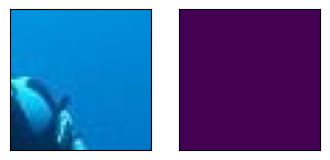

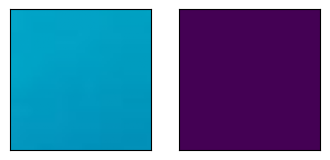

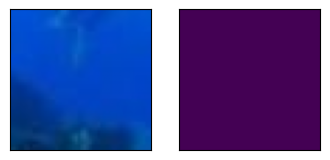

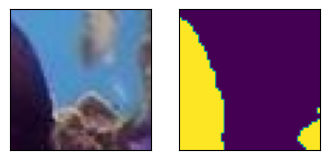

In [67]:
for i in ds_s_tr.take(4):
    fig, axes = plt.subplots(1, 2, figsize=(4, 2))
    axes[0].imshow(i[0])
    axes[1].imshow(i[1])
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])

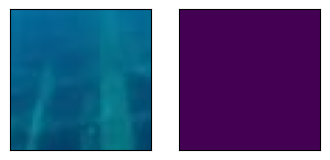

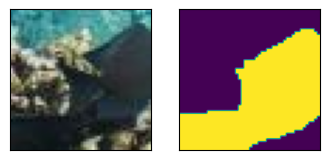

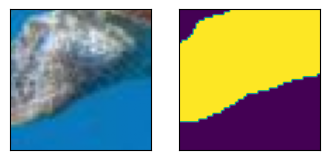

In [52]:
for i in ds_s_red_tr.take(3):
    fig, axes = plt.subplots(1, 2, figsize=(4, 2))
    axes[0].imshow(i[0])
    axes[1].imshow(i[1])
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])

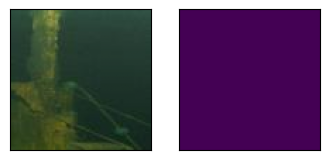

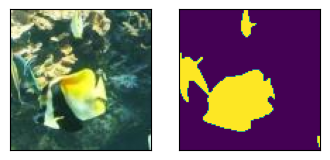

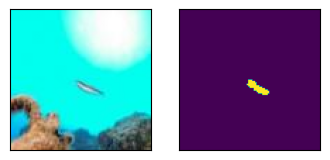

In [343]:
for i in ds_s_red_tr.take(3):
    fig, axes = plt.subplots(1, 2, figsize=(4, 2))
    axes[0].imshow(i[0])
    axes[1].imshow(i[1])
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])

In [117]:
images_te = []
masks_te = []
for x, y in ds_te:
    images_te.append(x)
    masks_te.append(y)
images_te = np.array(images_te)
masks_te = np.array(masks_te)
labels_te = np.array([y[25,25] for  y in masks_te])

print(images_te.shape, labels_te.shape)
print(images_te.dtype, labels_te.dtype)
print(np.unique(labels_te, return_counts=True))

(2828, 50, 50, 3) (2828,)
float64 bool
(array([False,  True]), array([1380, 1448], dtype=int64))


In [118]:
images_red_te = []
masks_red_te = []
for x, y in ds_red_te:
    images_red_te.append(x)
    masks_red_te.append(y)
images_red_te = np.array(images_red_te)
masks_red_te = np.array(masks_red_te)
labels_red_te = np.array([y[25,25] for  y in masks_red_te])

print(images_red_te.shape, labels_red_te.shape)
print(images_red_te.dtype, labels_red_te.dtype)
print(np.unique(labels_red_te, return_counts=True))

(2763, 50, 50, 3) (2763,)
float64 bool
(array([False,  True]), array([1367, 1396], dtype=int64))


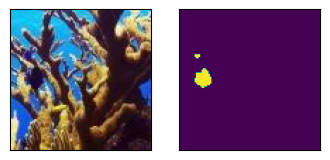

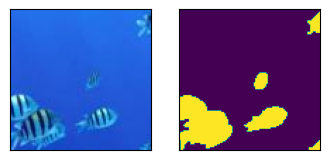

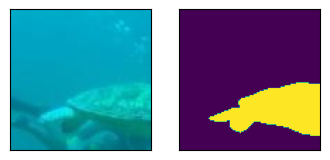

In [85]:
amt = 3
random_idx = np.random.choice(len(images_red_te), amt, replace=False)
for im,patch in zip(images_red_te[random_idx],masks_red_te[random_idx]):
    fig, axes = plt.subplots(1, 2, figsize=(4, 2))
    axes[0].imshow(im)
    axes[1].imshow(patch)
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
    plt.show()

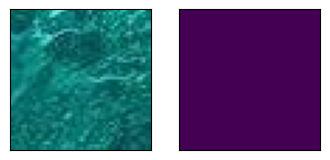

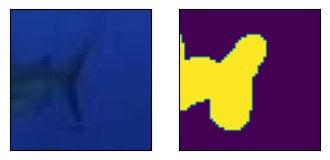

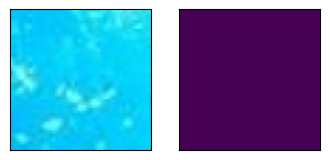

In [55]:

for im,patch in zip(images_te[:3],masks_te[:3]):
    fig, axes = plt.subplots(1, 2, figsize=(4, 2))
    axes[0].imshow(im)
    axes[1].imshow(patch)
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
    plt.show()

## Simple model

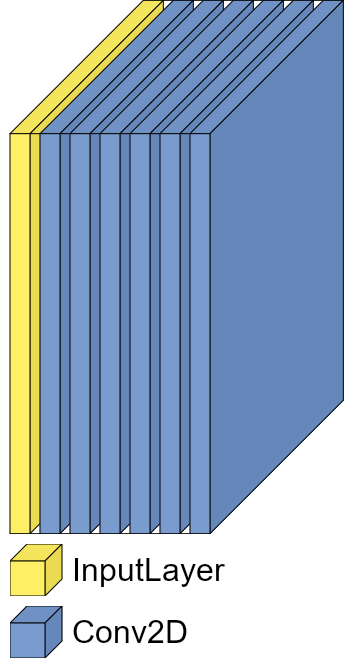

In [53]:
# Simple FCN model
def make_model_simple():
    input_layer = keras.Input(shape=(100, 100, 3), name='input')
    x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_layer)
    x = keras.layers.Conv2D(filters=8, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.Conv2D(filters=16, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.Conv2D(filters=128, kernel_size=(1,1), padding='same', activation='relu')(x)
    x = keras.layers.Conv2D(filters=1, kernel_size=(1,1), padding='same', activation='sigmoid')(x)
    model = keras.Model(input_layer, x, name="simple_fcnn")
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.01),
              loss=keras.losses.BinaryCrossentropy(from_logits=False), 
              metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)])
    return model

model_simple = make_model_simple()
visualkeras.layered_view(model_simple , legend=True, font=font, color_map=color_map)
# print(model_simple.summary())

In [15]:
epochs = 75
batch_size = 64

model_name = "model_full_simple2"
callbacks = get_callbacks(model_name)

model_simple = make_model_simple()
history_simple = model_simple.fit(ds_s_tr.shuffle(1024).batch(batch_size), 
                                  validation_data=ds_s_val.batch(batch_size), 
                                  epochs=epochs, 
                                  callbacks=callbacks)

model_simple.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history_simple)

Epoch 1/75

406/406 [==============================] - 69s 158ms/step - loss: 0.6050 - binary_accuracy: 0.6832 - auc: 0.6122 - val_loss: 0.5956 - val_binary_accuracy: 0.6928 - val_auc: 0.6287 - lr: 0.0100
Epoch 2/75
406/406 [==============================] - 55s 134ms/step - loss: 0.5959 - binary_accuracy: 0.6909 - auc: 0.6271 - val_loss: 0.5932 - val_binary_accuracy: 0.6944 - val_auc: 0.6369 - lr: 0.0100
Epoch 3/75
406/406 [==============================] - 54s 133ms/step - loss: 0.5939 - binary_accuracy: 0.6910 - auc: 0.6351 - val_loss: 0.5861 - val_binary_accuracy: 0.6946 - val_auc: 0.6444 - lr: 0.0100
Epoch 4/75
406/406 [==============================] - 54s 132ms/step - loss: 0.5873 - binary_accuracy: 0.6923 - auc: 0.6444 - val_loss: 0.5843 - val_binary_accuracy: 0.6951 - val_auc: 0.6441 - lr: 0.0100
Epoch 5/75
406/406 [==============================] - 54s 132ms/step - loss: 0.5856 - binary_accuracy: 0.6921 - auc: 0.6408 - val_loss: 0.5821 - val_binary_accuracy: 0.6948 - val_auc:

In [16]:
epochs = 50
batch_size = 64

model_name = "model_full_simple_red2"
callbacks = get_callbacks(model_name)

model_simple_red = make_model_simple()
# model_simple_red = model_simple
history_simple_red = model_simple_red.fit(ds_s_red_tr.shuffle(1024).batch(batch_size), 
                                  validation_data=ds_s_red_val.batch(batch_size), 
                                  epochs=epochs, 
                                  callbacks=callbacks)

model_simple_red.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history_simple_red)

Epoch 1/50
282/282 [==============================] - 131s 453ms/step - loss: 0.4785 - binary_accuracy: 0.8050 - auc: 0.6044 - val_loss: 0.4712 - val_binary_accuracy: 0.8051 - val_auc: 0.6384 - lr: 0.0100
Epoch 2/50
282/282 [==============================] - 126s 446ms/step - loss: 0.4712 - binary_accuracy: 0.8060 - auc: 0.6211 - val_loss: 0.4713 - val_binary_accuracy: 0.8070 - val_auc: 0.6355 - lr: 0.0100
Epoch 3/50
282/282 [==============================] - 127s 452ms/step - loss: 0.4698 - binary_accuracy: 0.8097 - auc: 0.6223 - val_loss: 0.4656 - val_binary_accuracy: 0.8124 - val_auc: 0.6231 - lr: 0.0100
Epoch 4/50
282/282 [==============================] - 126s 446ms/step - loss: 0.4657 - binary_accuracy: 0.8117 - auc: 0.6270 - val_loss: 0.4643 - val_binary_accuracy: 0.8153 - val_auc: 0.6360 - lr: 0.0100
Epoch 5/50
282/282 [==============================] - 126s 446ms/step - loss: 0.4672 - binary_accuracy: 0.8100 - auc: 0.6261 - val_loss: 0.4693 - val_binary_accuracy: 0.8067 - val_

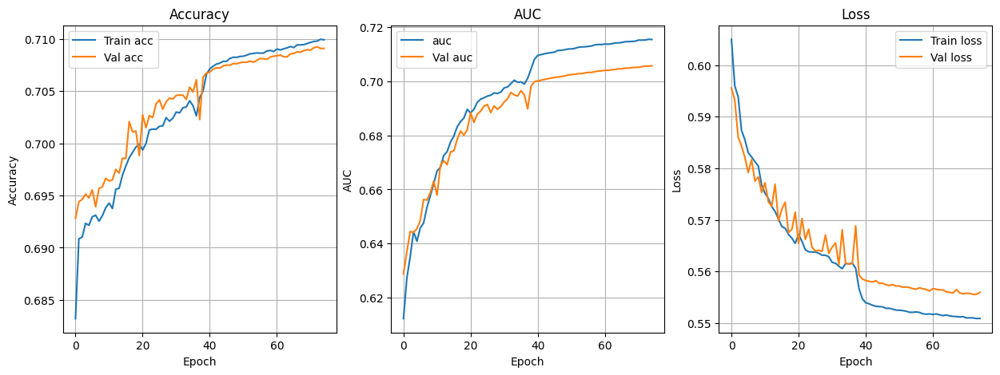

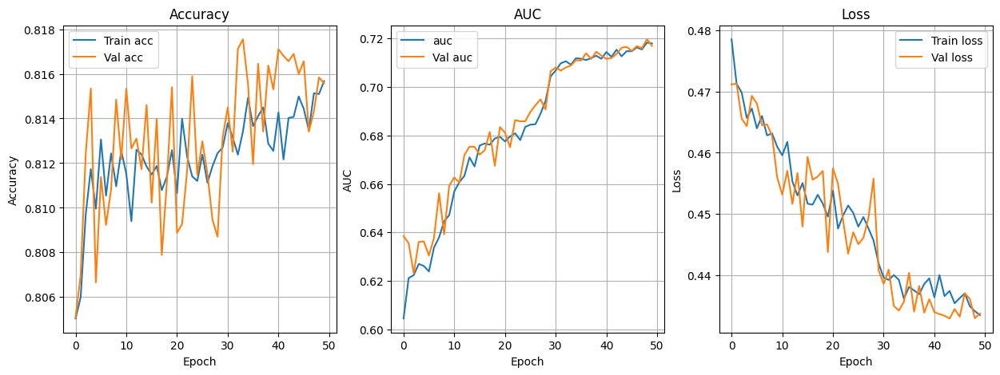

In [21]:
history_simple = np.load(pathlib.Path(ddir, "models", f"model_full_simple2_history.npy"), allow_pickle=True).item()
history_simple_red = np.load(pathlib.Path(ddir, "models", f"model_full_simple_red2_history.npy"), allow_pickle=True).item()
plot_loss_acc(history_simple,)
plot_loss_acc(history_simple_red)

1/1 [==============================] - 0s 190ms/step


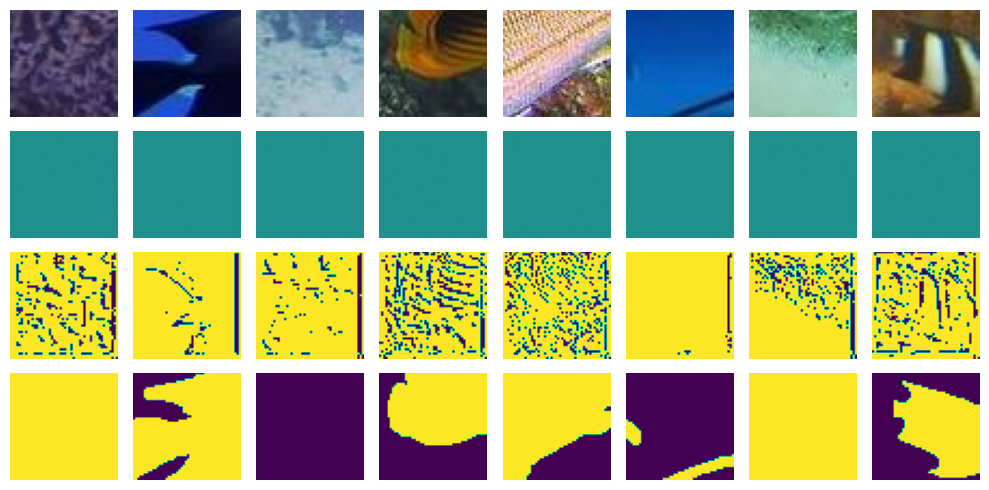

Epoch 1/4
290/290 [==============================] - 80s 255ms/step - loss: 0.6055 - binary_accuracy: 0.6790 - val_loss: 0.6046 - val_binary_accuracy: 0.6415
Epoch 2/4
290/290 [==============================] - 83s 285ms/step - loss: 0.5967 - binary_accuracy: 0.6850 - val_loss: 0.6022 - val_binary_accuracy: 0.6583
Epoch 3/4
290/290 [==============================] - 88s 299ms/step - loss: 0.5946 - binary_accuracy: 0.6907 - val_loss: 0.5986 - val_binary_accuracy: 0.6572
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


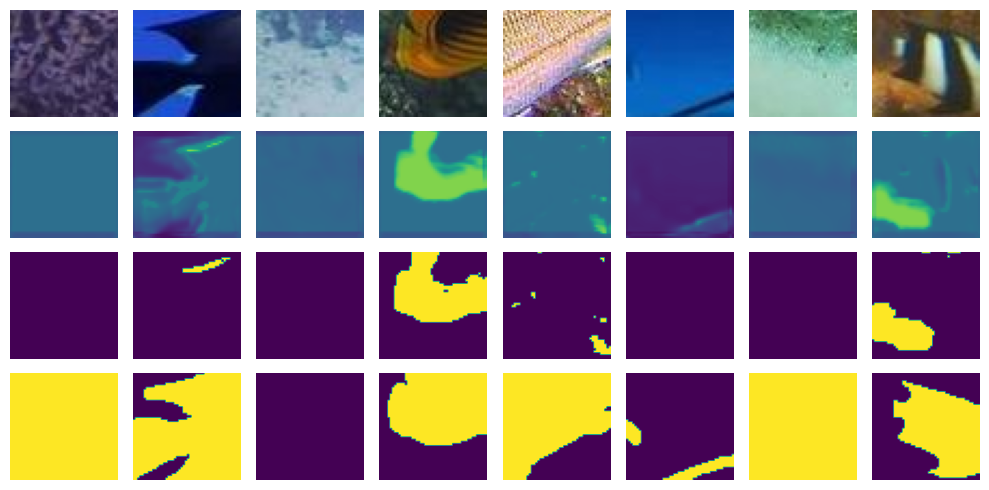

Epoch 1/4
290/290 [==============================] - 105s 362ms/step - loss: 0.5915 - binary_accuracy: 0.6911 - val_loss: 0.5989 - val_binary_accuracy: 0.6565
Epoch 2/4
290/290 [==============================] - 100s 342ms/step - loss: 0.5897 - binary_accuracy: 0.6936 - val_loss: 0.6005 - val_binary_accuracy: 0.6570
Epoch 3/4
290/290 [==============================] - 103s 353ms/step - loss: 0.5884 - binary_accuracy: 0.6938 - val_loss: 0.5962 - val_binary_accuracy: 0.6593
Epoch 4/4
1/1 [==============================] - 0s 67ms/step


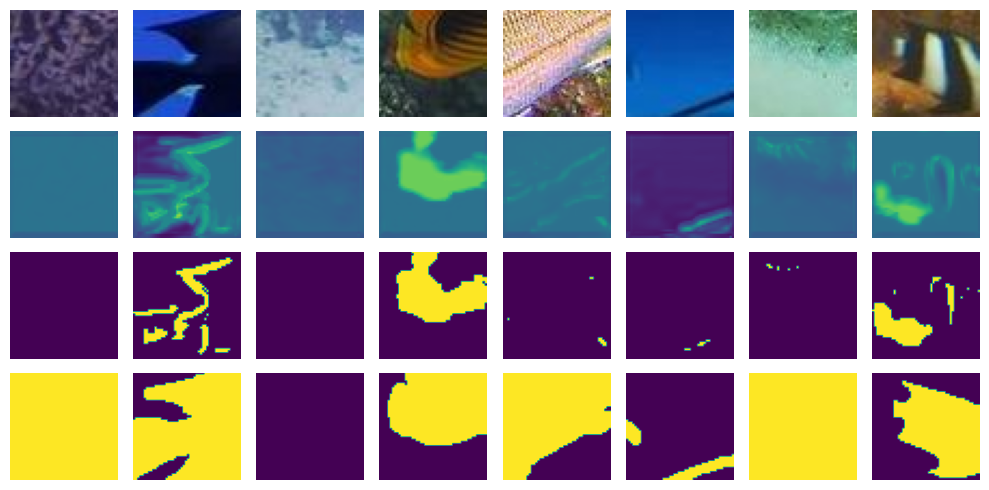

Epoch 1/4
290/290 [==============================] - 110s 378ms/step - loss: 0.5858 - binary_accuracy: 0.6942 - val_loss: 0.5909 - val_binary_accuracy: 0.6605
Epoch 2/4
290/290 [==============================] - 82s 280ms/step - loss: 0.5820 - binary_accuracy: 0.6949 - val_loss: 0.5869 - val_binary_accuracy: 0.6616
Epoch 3/4
290/290 [==============================] - 69s 238ms/step - loss: 0.5802 - binary_accuracy: 0.6955 - val_loss: 0.5806 - val_binary_accuracy: 0.6646
Epoch 4/4
1/1 [==============================] - 0s 160ms/step


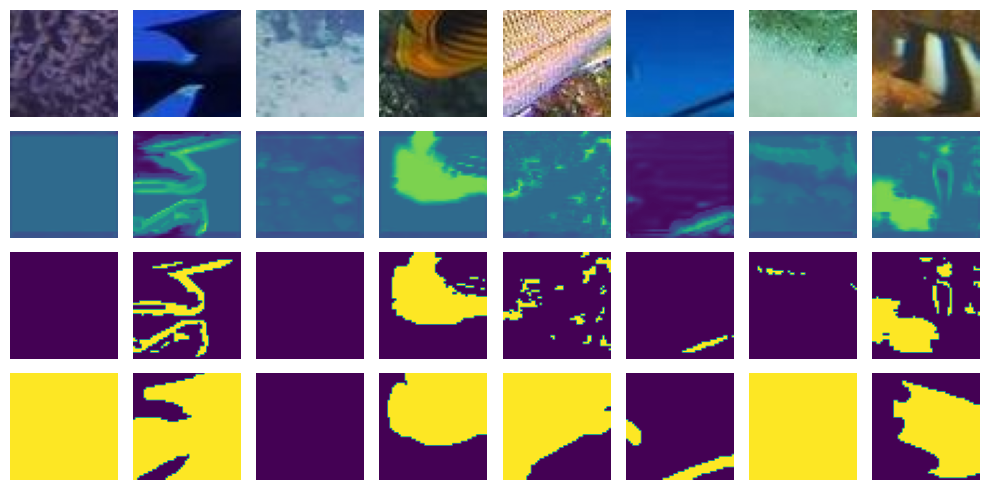

Epoch 1/4
290/290 [==============================] - 102s 350ms/step - loss: 0.5766 - binary_accuracy: 0.6975 - val_loss: 0.5790 - val_binary_accuracy: 0.6701
Epoch 2/4
290/290 [==============================] - 111s 382ms/step - loss: 0.5729 - binary_accuracy: 0.6989 - val_loss: 0.5697 - val_binary_accuracy: 0.6708
Epoch 3/4
290/290 [==============================] - 100s 343ms/step - loss: 0.5730 - binary_accuracy: 0.6984 - val_loss: 0.5708 - val_binary_accuracy: 0.6724
Epoch 4/4
1/1 [==============================] - 0s 45ms/step


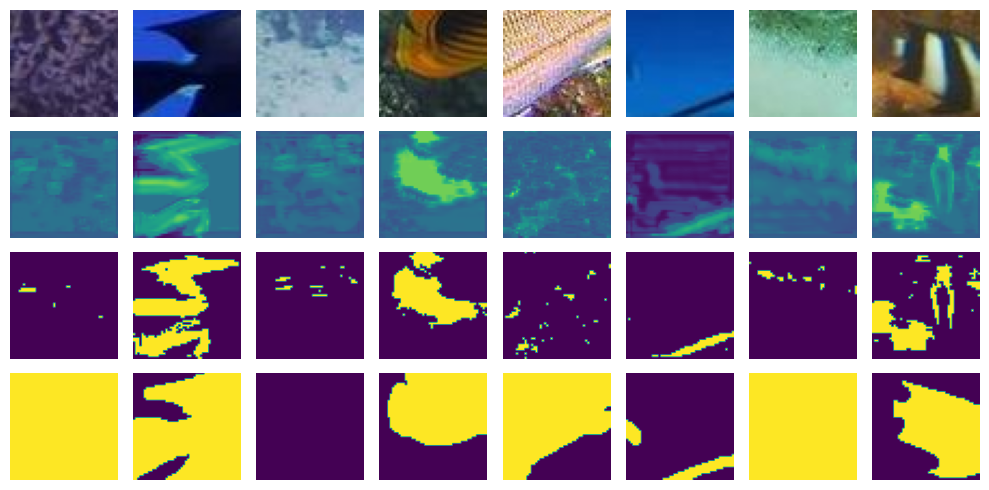

Epoch 1/4
290/290 [==============================] - 72s 246ms/step - loss: 0.5697 - binary_accuracy: 0.6997 - val_loss: 0.5705 - val_binary_accuracy: 0.6729
Epoch 2/4
207/290 [====================>.........] - ETA: 18s - loss: 0.5701 - binary_accuracy: 0.7000

KeyboardInterrupt: 

In [120]:
ntest = 8
batch_size = 128
(tx,ty) = next(iter(ds_te.shuffle(25).batch(ntest)))
model_simple = make_model_simple()
while(True):
    tyhat = model_simple.predict(tx)
    fig,axs = plt.subplots(nrows=4, ncols=ntest, figsize=(10,5))
    for ti in range(ntest):
        axs[0,ti].imshow(tx[ti])
        axs[1,ti].imshow(tyhat[ti,:,:,0], vmin=0, vmax=1)
        axs[2,ti].imshow(tyhat[ti,:,:,0]>0.5, vmin=0, vmax=1)
        axs[3,ti].imshow(ty[ti], vmin=0, vmax=1)
    for ax in axs.flatten():
        ax.axis("off")
    plt.tight_layout()
    plt.show()
    # model.fit(ds_tr.shuffle(300).batch(64), validation_data=ds_te.batch(64), epochs=4, callbacks=[tensorboard_callback])
    model_simple.fit(ds_tr.shuffle(1024).batch(batch_size), 
              validation_data=ds_te.batch(batch_size), 
              epochs=4)


In [22]:
score = model_simple.evaluate(images_te, masks_te)
print('Test loss:', score[0])
print('Test accuracy:', score[1])


89/89 [==============================] - 3s 21ms/step - loss: 0.5542 - binary_accuracy: 0.6875 - auc: 0.7420
Test loss: 0.5541769862174988
Test accuracy: 0.6874877214431763


89/89 [==============================] - 1s 15ms/step
(2828, 50, 50, 1)
(2828, 1)
(array([0.00295338, 0.0031214 , 0.00315913, ..., 0.97981536, 0.98258156,
       0.9831447 ], dtype=float32), array([1, 1, 1, ..., 1, 1, 1], dtype=int64))


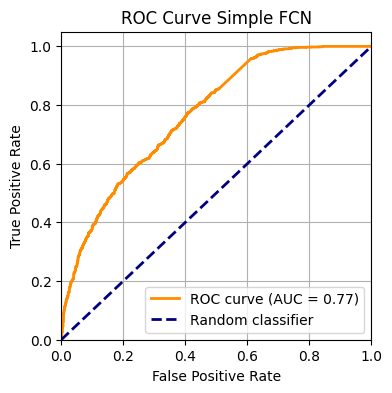

0.7679492953799344

In [28]:
predictions_simple = model_simple.predict(images_te)
pred_proba_te = np.array([x[25,25] for x in predictions_simple])

print(predictions_simple.shape)
print(pred_proba_te.shape)
print(np.unique(pred_proba_te, return_counts=True))
plot_AUC(labels_te,pred_proba_te,title="Simple FCN")

62/62 [==============================] - 3s 52ms/step
(1981, 100, 100, 1)
(1981, 1)
(array([6.3292614e-06, 1.6182055e-05, 1.4768587e-04, ..., 9.7450942e-01,
       9.7464478e-01, 9.7713953e-01], dtype=float32), array([1, 1, 1, ..., 1, 1, 1], dtype=int64))


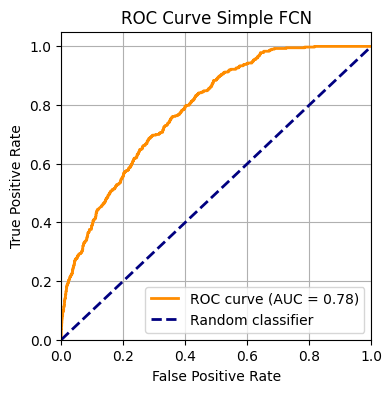

0.7845725713696108

In [27]:
predictions_simple_red = model_simple_red.predict(images_red_te)
pred_proba_te_red = np.array([x[25,25] for x in predictions_simple_red])

print(predictions_simple_red.shape)
print(pred_proba_te_red.shape)
print(np.unique(pred_proba_te_red, return_counts=True))
plot_AUC(labels_red_te,pred_proba_te_red,title="Simple FCN",red=True)

In [124]:
# plot_confustion_matrix(labels_te,pred_proba_te>0.5,percent=True)

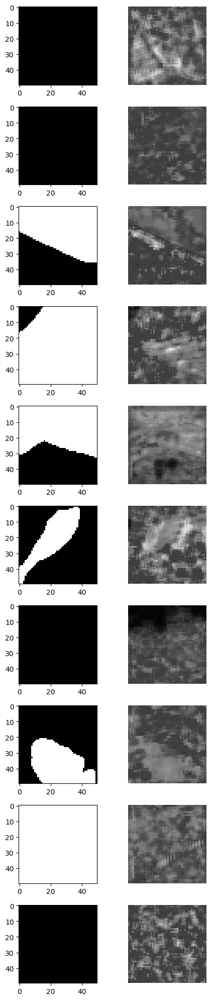

In [29]:
amt = 10
fig, ax = plt.subplots(amt,2,figsize=(5,2*amt))
random_idx = np.random.choice(len(masks_te), amt, replace=False)

for i,(m,p) in enumerate(zip(masks_te[random_idx],predictions_simple[random_idx])):
    ax[i,0].imshow(m, cmap="gray", vmin=0, vmax=1)
    ax[i,1].imshow(p, cmap="gray", vmin=0, vmax=1)
    ax[i,1].axis("off")
plt.tight_layout()

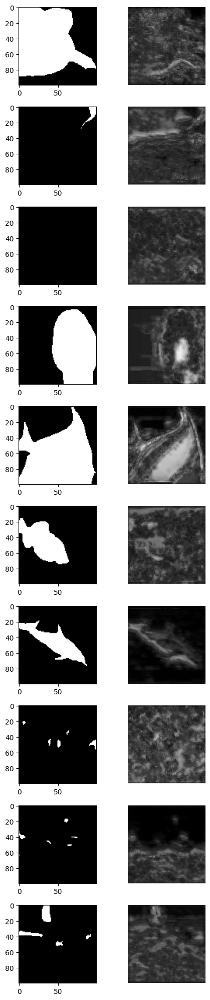

In [30]:
amt = 10
fig, ax = plt.subplots(amt,2,figsize=(5,2*amt))
random_idx = np.random.choice(len(masks_red_te), amt, replace=False)

for i,(m,p) in enumerate(zip(masks_red_te[random_idx],predictions_simple_red[random_idx])):
    ax[i,0].imshow(m, cmap="gray", vmin=0, vmax=1)
    ax[i,1].imshow(p, cmap="gray", vmin=0, vmax=1)
    ax[i,1].axis("off")
plt.tight_layout()

## U-net

In [109]:
def make_model_unet1():
    # Input layer
    # 50 can't be divided by 4 (downsampling -> upsampling) so we need to pad or crop the input
    input_layer = keras.Input(shape=(None,None, 3), name='input')
    # if input_layer.shape[1] is not None and input_layer.shape[1] % 4 != 0:
    input_pad = keras.layers.ZeroPadding2D(padding=(2, 2))(input_layer)
    # # cropping to be even (50, 50, 3) to (48, 48, 3): 
    # input_cropped = keras.layers.Cropping2D(cropping=((1, 1), (1, 1)))(input_layer)
    
    # Block 1: Encoder
    # if input_layer.shape[1] is not None and input_layer.shape[1] % 4 != 0:
    x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_pad)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.SeparableConv2D(filters=8, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x1 = x
    # x = keras.layers.MaxPooling2D(2)(x)
    x = keras.layers.MaxPooling2D(3)(x)
    x = keras.layers.SeparableConv2D(filters=16, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x2 = x
    
    # x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_layer)
    # # x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_cropped)
    # # x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_pad)
    # x = keras.layers.BatchNormalization()(x)
    # x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    # x = keras.layers.BatchNormalization()(x)
    
    # # Block 1: Encoder
    # x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_layer)
    # # x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_cropped)
    # # x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_pad)
    # x = keras.layers.BatchNormalization()(x)
    # x = keras.layers.SeparableConv2D(filters=8, kernel_size=(3,3), padding='same', activation='relu')(x)
    # x = keras.layers.BatchNormalization()(x)
    # x1 = x
    # print("x1: ",x.shape)
    # x = keras.layers.MaxPooling2D(3)(x)
    # print("maxpool 1: ",x.shape)

    # Block 2: Encoder
    # x = keras.layers.SeparableConv2D(filters=16, kernel_size=(3,3), padding='same', activation='relu')(x)
    # x = keras.layers.BatchNormalization()(x)
    # x2 = x
    # print("x2 : ",x.shape)
    x = keras.layers.MaxPooling2D(2)(x)
    # print("maxpool 2 : ",x.shape)
    
    # Block 3: Decoder with Skip Connections
    x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.UpSampling2D(2)(x)
    # print("upsample 1: ",x.shape, x2.shape)
    x = keras.layers.Concatenate(name="concat_skip1")([x,x2]) # Skip connections
    x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    # x = keras.layers.UpSampling2D(2)(x)
    x = keras.layers.UpSampling2D(3)(x)
    # print("upsample 2: ",x.shape)
    x = keras.layers.Concatenate(name="concat_skip2")([x,x1]) # Skip connections
    # print("concat: ",x.shape)
    # Block 4: Output
    x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.Conv2D(filters=128, kernel_size=(1,1), padding='same', activation='relu')(x)
    x = keras.layers.Conv2D(filters=1, kernel_size=(1,1), padding='same', activation='sigmoid')(x)
    # crop output back to (50, 50, 1)
    # if input_layer.shape[1] is not None and input_layer.shape[1] % 4 != 0:
    x = keras.layers.Cropping2D(cropping=((2, 2), (2, 2)))(x)
    

    # Model
    # model = keras.Model(input_cropped, x)
    model = keras.Model(input_layer, x, name="unet")
    
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.01),
              loss=keras.losses.BinaryCrossentropy(from_logits=False), 
              metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)])
    return model

model_unet = make_model_unet1()
# print(model_unet.summary())

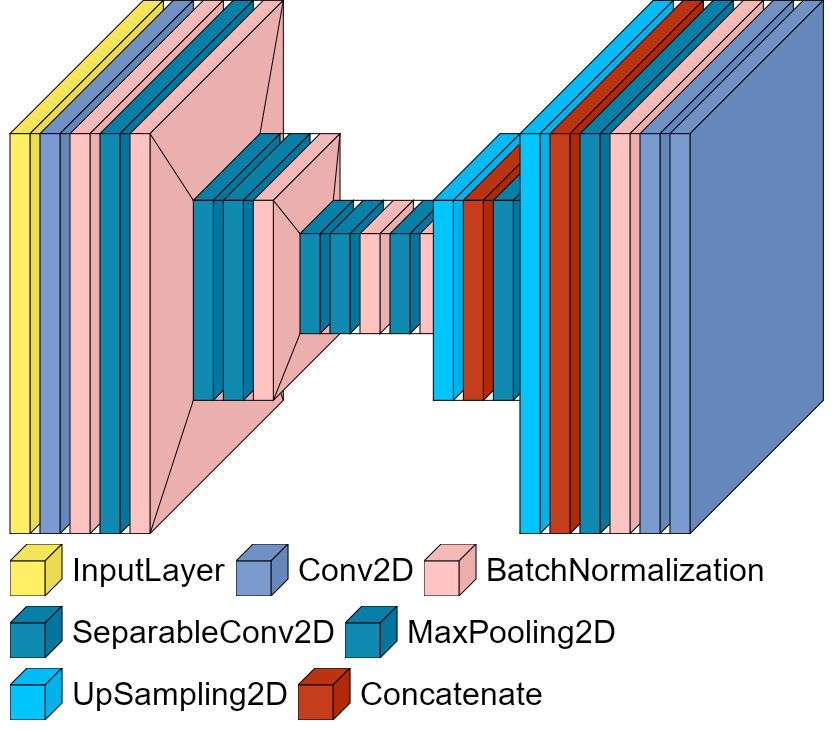

In [52]:
def make_model_unet2():
    input_layer = keras.Input(shape=(None, None, 3), name='input')
    x = keras.layers.Conv2D(filters=4, kernel_size=(3,3), padding='same', activation='relu')(input_layer)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.SeparableConv2D(filters=8, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x1 = x
    x = keras.layers.MaxPooling2D(2)(x)
    
    x = keras.layers.SeparableConv2D(filters=16, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x2 = x
    x = keras.layers.MaxPooling2D(2)(x)
    
    x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    
    x = keras.layers.UpSampling2D(2)(x)
    x = keras.layers.Concatenate(name="concat_skip1")([x,x2]) # Skip connections
    x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    
    x = keras.layers.UpSampling2D(2)(x)
    x = keras.layers.Concatenate(name="concat_skip2")([x,x1]) # Skip connections
    x = keras.layers.SeparableConv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.Conv2D(filters=128, kernel_size=(1,1), padding='same', activation='relu')(x)
    x = keras.layers.Conv2D(filters=1, kernel_size=(1,1), padding='same', activation='sigmoid')(x)
    model = keras.Model(input_layer, x, name="unet_ex")
    
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.01),
              loss=keras.losses.BinaryCrossentropy(from_logits=False), 
              metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)])
    return model

model_unet = make_model_unet2()
visualkeras.layered_view(model_unet  , legend=True, font=font, color_map=color_map)
# print(model_unet.summary())

In [105]:
def model2():
    inputs = keras.Input(shape=(None,None,3))
    #Contraction path
    c1 = keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(inputs)
    c1 = keras.layers.Dropout(0.1)(c1)
    c1 = keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    b1 = keras.layers.BatchNormalization()(c1)
    r1 = keras.layers.ReLU()(b1)
    p1 = keras.layers.MaxPooling2D((2, 2))(r1)

    c2 = keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = keras.layers.Dropout(0.1)(c2)
    c2 = keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    b2 = keras.layers.BatchNormalization()(c2)
    r2 = keras.layers.ReLU()(b2)
    p2 = keras.layers.MaxPooling2D((2, 2))(r2)
    
    c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    c3 = tf.keras.layers.Dropout(0.2)(c3)
    c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
    b3 = tf.keras.layers.BatchNormalization()(c3)
    r3 = tf.keras.layers.ReLU()(b3)
    p3 = tf.keras.layers.MaxPooling2D((2, 2))(r3)
    
    
    c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
    b4 = tf.keras.layers.BatchNormalization()(c4)
    r4 = tf.keras.layers.ReLU()(b4)
    c4 = tf.keras.layers.Dropout(0.3)(r4)
    c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)


    #Expansive path 
    u3 = keras.layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c4)
    u3 = tf.keras.layers.ZeroPadding2D(padding=((1,0),(0,1)))(u3)
    u3 = keras.layers.concatenate([u3, c3])
    u3 = keras.layers.BatchNormalization()(u3)
    u3 = keras.layers.ReLU()(u3)
    
    u4 = keras.layers.Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(u3)
    u4 = keras.layers.concatenate([u4, c2])
    u4 = keras.layers.BatchNormalization()(u4)
    u4 = keras.layers.ReLU()(u4)
    
    u5 = keras.layers.Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(u4)
    u5 = keras.layers.concatenate([u5, c1], axis=3)
    u5 = keras.layers.BatchNormalization()(u5)
    u5 = keras.layers.ReLU()(u5)
    
    outputs = keras.layers.Conv2D(1, 1, padding="same", activation = "sigmoid")(u5)
    unet_model = keras.Model(inputs, outputs, name="U-Net")
    unet_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.01),
                loss=keras.losses.BinaryCrossentropy(from_logits=False), 
                metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)])
    return unet_model
model = model2()
model.summary()

Model: "U-Net"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_33 (InputLayer)       [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d_308 (Conv2D)         (None, None, None, 16)       448       ['input_33[0][0]']            
                                                                                                  
 dropout_117 (Dropout)       (None, None, None, 16)       0         ['conv2d_308[0][0]']          
                                                                                                  
 conv2d_309 (Conv2D)         (None, None, None, 16)       2320      ['dropout_117[0][0]']         
                                                                                              

In [39]:
def model3():
    inputs = keras.Input(shape=(None,None,3))
    #Contraction path
    c1 = keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(inputs)
    c1 = keras.layers.Dropout(0.1)(c1)
    c1 = keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    b1 = keras.layers.BatchNormalization()(c1)
    r1 = keras.layers.ReLU()(b1)
    p1 = keras.layers.MaxPooling2D((2, 2))(r1)

    c2 = keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = keras.layers.Dropout(0.1)(c2)
    c2 = keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    b2 = keras.layers.BatchNormalization()(c2)
    r2 = keras.layers.ReLU()(b2)
    p2 = keras.layers.MaxPooling2D((2, 2))(r2)
    
    c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    b3 = tf.keras.layers.BatchNormalization()(c3)
    r3 = tf.keras.layers.ReLU()(b3)
    c3 = tf.keras.layers.Dropout(0.2)(r3)
    c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)


    #Expansive path 
    u4 = keras.layers.Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c3)
    u4 = keras.layers.concatenate([u4, c2])
    u4 = keras.layers.BatchNormalization()(u4)
    u4 = keras.layers.ReLU()(u4)
    
    u5 = keras.layers.Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(u4)
    u5 = keras.layers.concatenate([u5, c1], axis=3)
    u5 = keras.layers.BatchNormalization()(u5)
    u5 = keras.layers.ReLU()(u5)
    
    outputs = keras.layers.Conv2D(1, 1, padding="same", activation = "sigmoid")(u5)
    unet_model = keras.Model(inputs, outputs, name="U-Net")
    unet_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.01),
                loss=keras.losses.BinaryCrossentropy(from_logits=False), 
                metrics=[keras.metrics.BinaryAccuracy(),keras.metrics.AUC(name="auc",from_logits=False)])
    return unet_model
model = model3()
model.summary()

Model: "U-Net"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d_6 (Conv2D)           (None, None, None, 16)       448       ['input_1[0][0]']             
                                                                                                  
 dropout (Dropout)           (None, None, None, 16)       0         ['conv2d_6[0][0]']            
                                                                                                  
 conv2d_7 (Conv2D)           (None, None, None, 16)       2320      ['dropout[0][0]']             
                                                                                              

In [69]:
epochs = 75
batch_size = 64

model_name = "model_full_unet2"
callbacks = get_callbacks(model_name)

model_unet = make_model_unet1()
history_unet = model_unet.fit(ds_s_tr.shuffle(1024).batch(batch_size), 
                                  validation_data=ds_s_val.batch(batch_size), 
                                  epochs=epochs, 
                                  callbacks=callbacks)

model_unet.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history_unet)

Epoch 1/75
406/406 [==============================] - 107s 244ms/step - loss: 0.5803 - binary_accuracy: 0.6967 - auc: 0.6772 - val_loss: 0.5780 - val_binary_accuracy: 0.6790 - val_auc: 0.7170 - lr: 0.0100
Epoch 2/75
406/406 [==============================] - 83s 203ms/step - loss: 0.5421 - binary_accuracy: 0.7241 - auc: 0.7398 - val_loss: 0.5708 - val_binary_accuracy: 0.7079 - val_auc: 0.6969 - lr: 0.0100
Epoch 3/75
406/406 [==============================] - 83s 204ms/step - loss: 0.5286 - binary_accuracy: 0.7333 - auc: 0.7578 - val_loss: 0.5546 - val_binary_accuracy: 0.7255 - val_auc: 0.7262 - lr: 0.0100
Epoch 4/75
406/406 [==============================] - 93s 228ms/step - loss: 0.5194 - binary_accuracy: 0.7397 - auc: 0.7707 - val_loss: 0.5590 - val_binary_accuracy: 0.7281 - val_auc: 0.7449 - lr: 0.0100
Epoch 5/75
406/406 [==============================] - 85s 208ms/step - loss: 0.5118 - binary_accuracy: 0.7432 - auc: 0.7790 - val_loss: 0.5269 - val_binary_accuracy: 0.7264 - val_auc:

In [57]:
epochs = 25
batch_size = 64

model_name = "model_full_unet_red_final2"
callbacks = get_callbacks(model_name)

model_unet_red = model3()
history_unet_red = model_unet_red.fit(ds_s_red_tr.shuffle(1024).batch(batch_size), 
                                  validation_data=ds_s_red_val.batch(batch_size), 
                                  epochs=epochs, 
                                  callbacks=callbacks)

model_unet_red.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history_unet_red)

ValueError: Attempt to convert a value (<_BatchDataset element_spec=(TensorSpec(shape=(None, 100, 100, 3), dtype=tf.float64, name=None), TensorSpec(shape=(None, 100, 100), dtype=tf.bool, name=None))>) with an unsupported type (<class 'tensorflow.python.data.ops.batch_op._BatchDataset'>) to a Tensor.

1/1 [==============================] - 0s 61ms/step


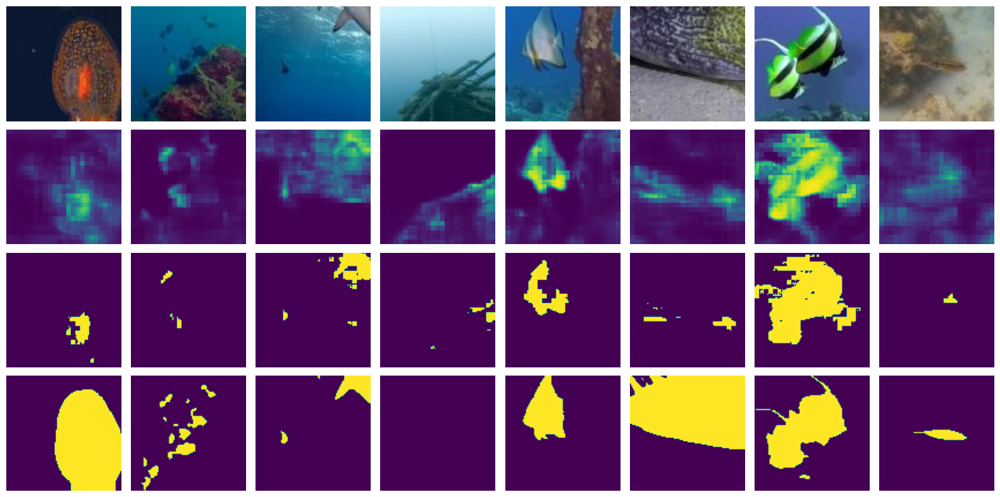

In [45]:
ntest = 8
(tx,ty) = next(iter(ds_red_te.batch(ntest)))
tyhat = model_unet_red.predict(tx)
fig,axs = plt.subplots(nrows=4, ncols=ntest, figsize=(ntest*2,8))
for ti in range(ntest):
    axs[0,ti].imshow(tx[ti])
    axs[1,ti].imshow(tyhat[ti,:,:,0], vmin=0, vmax=1)
    axs[2,ti].imshow(tyhat[ti,:,:,0]>0.5, vmin=0, vmax=1)
    axs[3,ti].imshow(ty[ti], vmin=0, vmax=1)
for ax in axs.flatten():
    ax.axis("off")
plt.tight_layout()
plt.show()

1/1 [==============================] - 1s 554ms/step


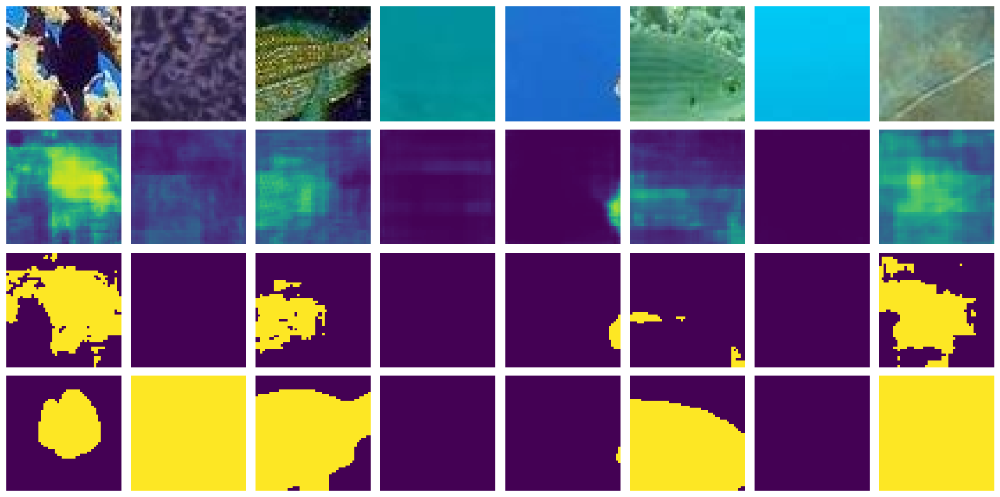

In [45]:
ntest = 8
(tx,ty) = next(iter(ds_te.batch(ntest)))
tyhat = model_unet.predict(tx)
fig,axs = plt.subplots(nrows=4, ncols=ntest, figsize=(ntest*2,8))
for ti in range(ntest):
    axs[0,ti].imshow(tx[ti])
    axs[1,ti].imshow(tyhat[ti,:,:,0], vmin=0, vmax=1)
    axs[2,ti].imshow(tyhat[ti,:,:,0]>0.5, vmin=0, vmax=1)
    axs[3,ti].imshow(ty[ti], vmin=0, vmax=1)
for ax in axs.flatten():
    ax.axis("off")
plt.tight_layout()
plt.show()

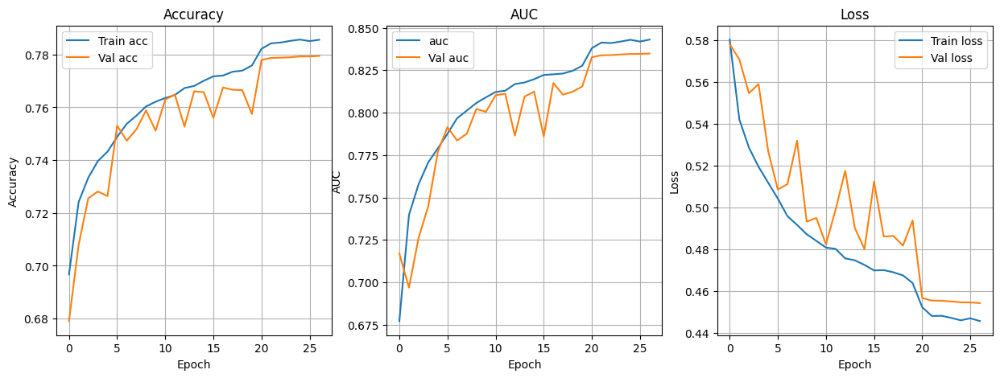

In [46]:
plot_loss_acc(history_unet,epochs=27)
# also plot validation auc in addition to accuracy

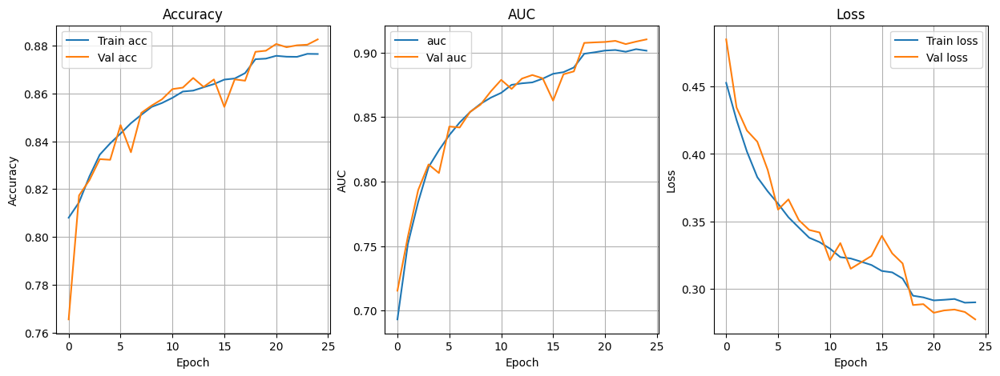

In [46]:
plot_loss_acc(history_unet_red)

1/1 [==============================] - 1s 581ms/step


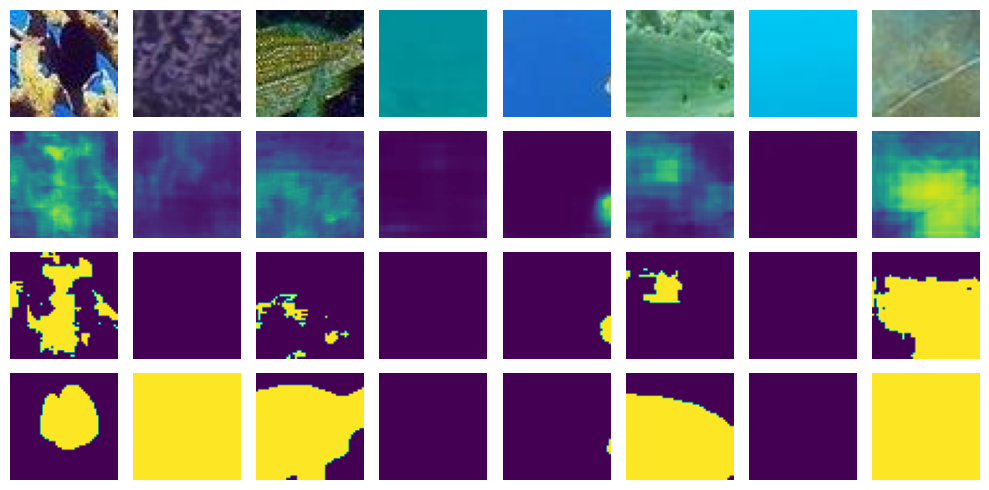

Epoch 1/4
203/203 [==============================] - 100s 459ms/step - loss: 0.4417 - binary_accuracy: 0.7891 - val_loss: 0.4412 - val_binary_accuracy: 0.7888 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4416 - binary_accuracy: 0.7894 - val_loss: 0.4414 - val_binary_accuracy: 0.7887 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 92s 454ms/step - loss: 0.4412 - binary_accuracy: 0.7893 - val_loss: 0.4414 - val_binary_accuracy: 0.7887 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


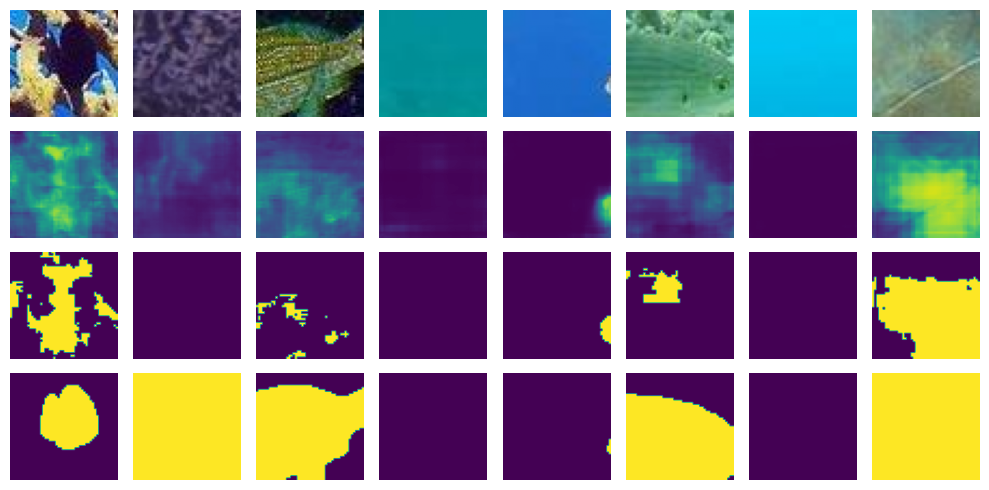

Epoch 1/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4409 - binary_accuracy: 0.7896 - val_loss: 0.4415 - val_binary_accuracy: 0.7886 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4408 - binary_accuracy: 0.7895 - val_loss: 0.4417 - val_binary_accuracy: 0.7886 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 92s 454ms/step - loss: 0.4410 - binary_accuracy: 0.7896 - val_loss: 0.4417 - val_binary_accuracy: 0.7886 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


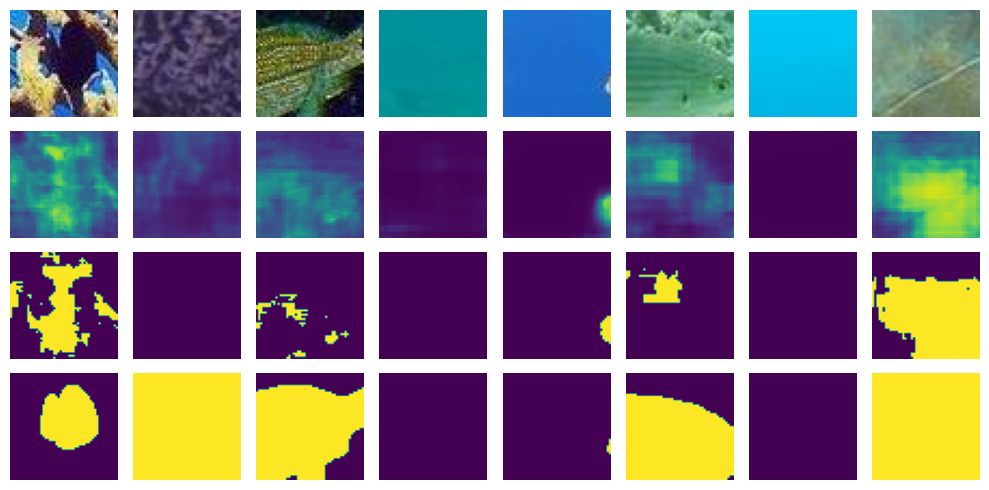

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4407 - binary_accuracy: 0.7898 - val_loss: 0.4417 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4412 - binary_accuracy: 0.7897 - val_loss: 0.4417 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4403 - binary_accuracy: 0.7901 - val_loss: 0.4418 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


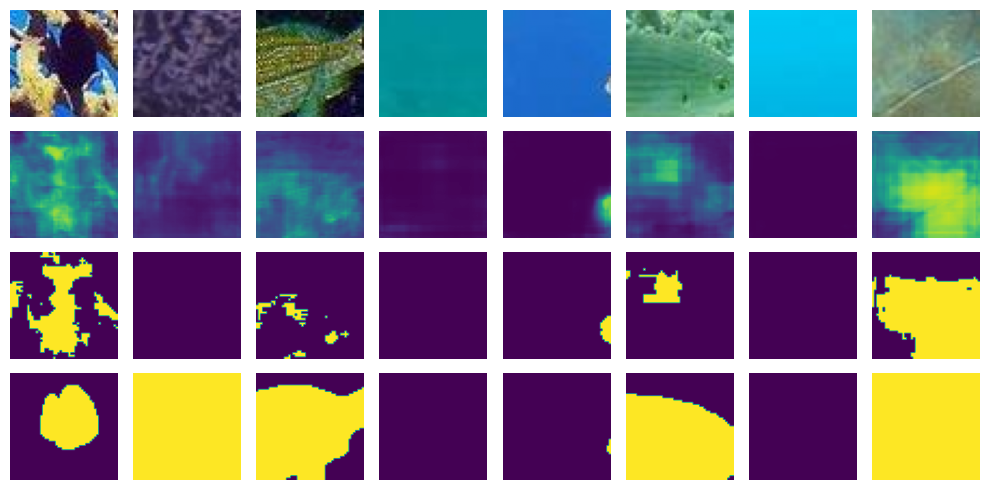

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4416 - binary_accuracy: 0.7894 - val_loss: 0.4419 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4405 - binary_accuracy: 0.7900 - val_loss: 0.4419 - val_binary_accuracy: 0.7885 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4411 - binary_accuracy: 0.7897 - val_loss: 0.4419 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


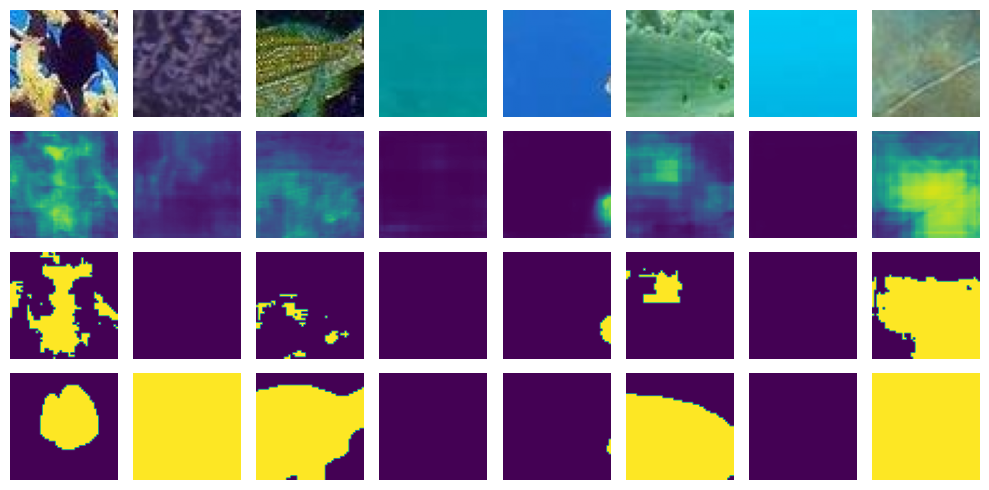

Epoch 1/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4406 - binary_accuracy: 0.7898 - val_loss: 0.4419 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4411 - binary_accuracy: 0.7896 - val_loss: 0.4420 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4404 - binary_accuracy: 0.7899 - val_loss: 0.4420 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 57ms/step


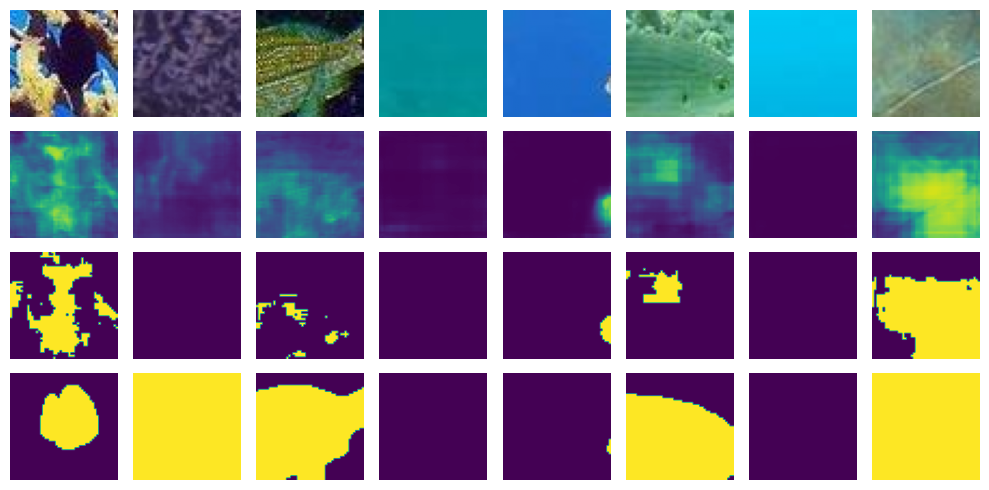

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4405 - binary_accuracy: 0.7900 - val_loss: 0.4420 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4406 - binary_accuracy: 0.7899 - val_loss: 0.4420 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4407 - binary_accuracy: 0.7897 - val_loss: 0.4421 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


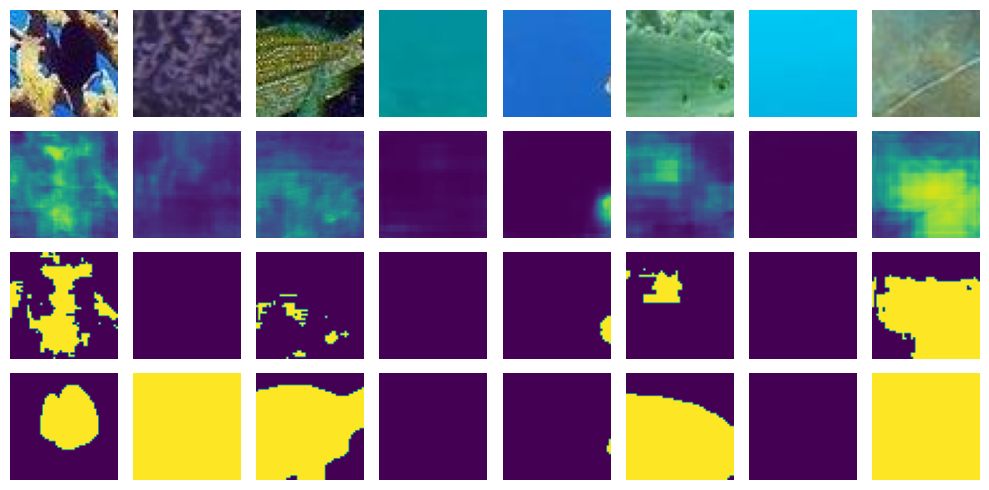

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4407 - binary_accuracy: 0.7897 - val_loss: 0.4421 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4408 - binary_accuracy: 0.7900 - val_loss: 0.4421 - val_binary_accuracy: 0.7884 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4405 - binary_accuracy: 0.7901 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


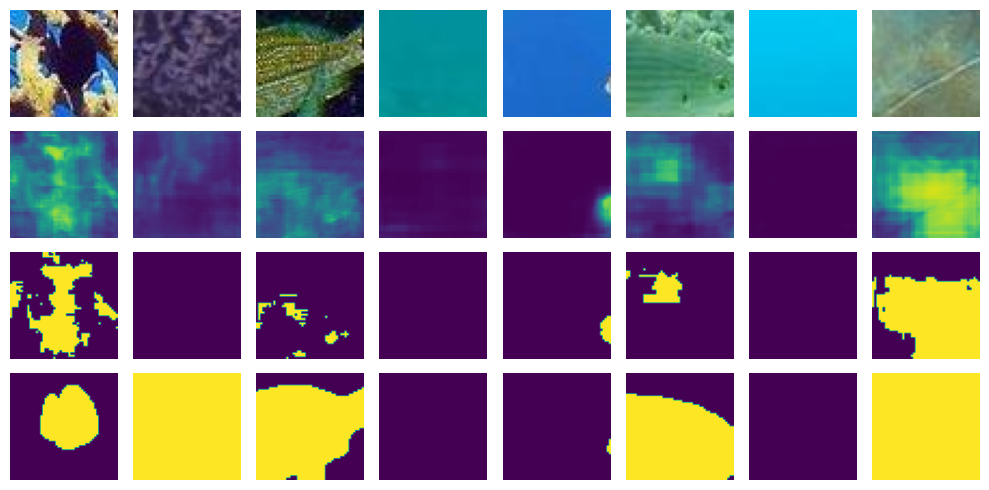

Epoch 1/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4409 - binary_accuracy: 0.7896 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4403 - binary_accuracy: 0.7901 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4403 - binary_accuracy: 0.7901 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


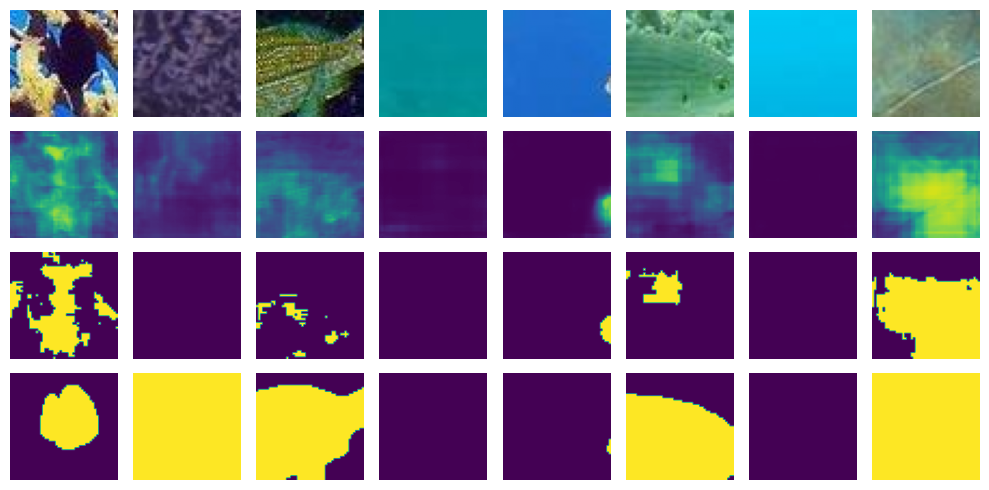

Epoch 1/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4399 - binary_accuracy: 0.7903 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4410 - binary_accuracy: 0.7894 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4403 - binary_accuracy: 0.7898 - val_loss: 0.4422 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


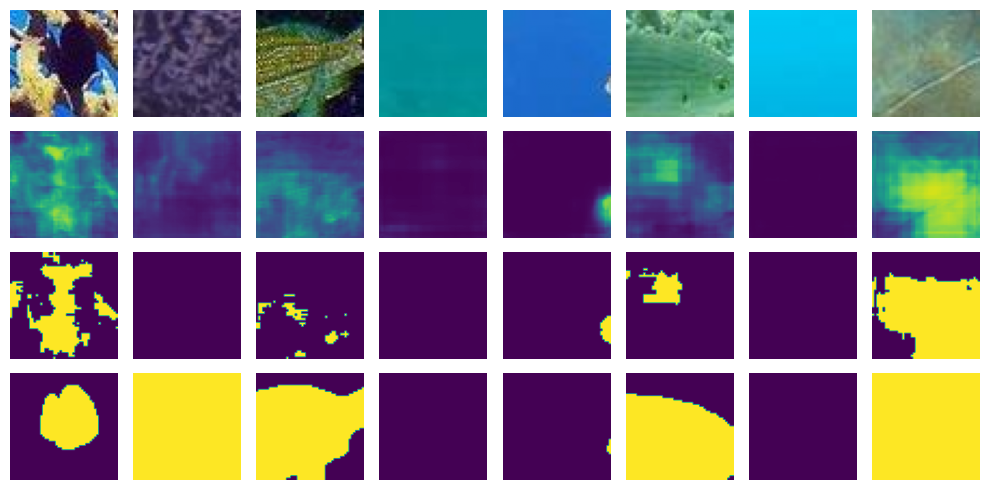

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4409 - binary_accuracy: 0.7896 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4411 - binary_accuracy: 0.7895 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4401 - binary_accuracy: 0.7900 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


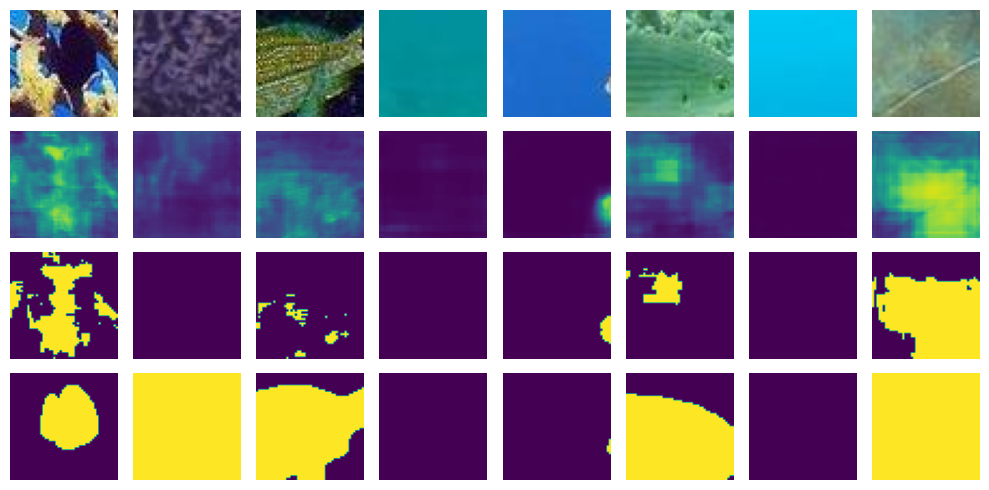

Epoch 1/4
203/203 [==============================] - 92s 454ms/step - loss: 0.4406 - binary_accuracy: 0.7899 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4409 - binary_accuracy: 0.7896 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4397 - binary_accuracy: 0.7902 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


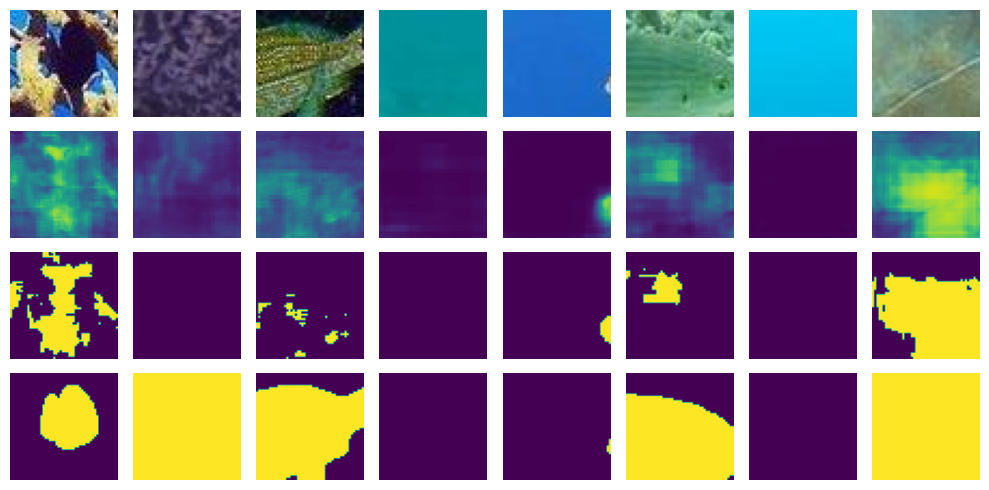

Epoch 1/4
203/203 [==============================] - 95s 467ms/step - loss: 0.4399 - binary_accuracy: 0.7904 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 95s 469ms/step - loss: 0.4396 - binary_accuracy: 0.7902 - val_loss: 0.4424 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 468ms/step - loss: 0.4402 - binary_accuracy: 0.7904 - val_loss: 0.4423 - val_binary_accuracy: 0.7883 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 52ms/step


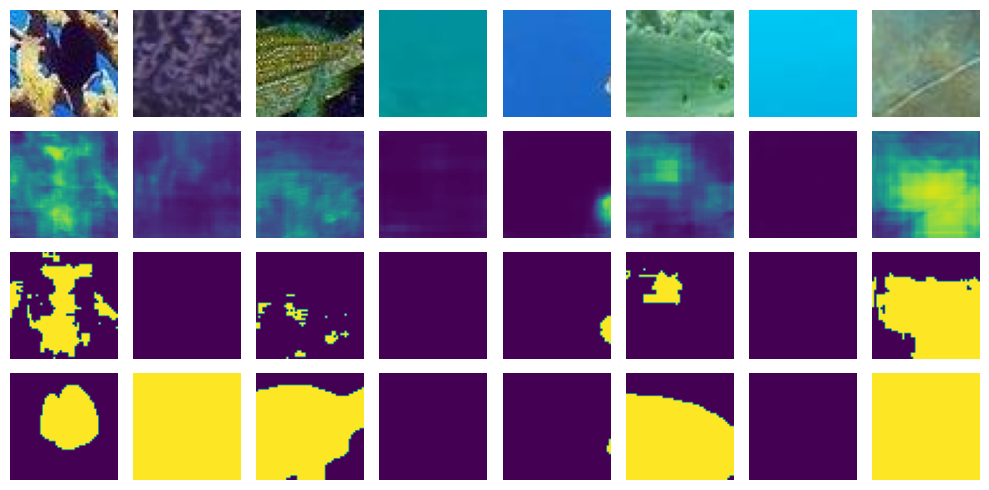

Epoch 1/4
203/203 [==============================] - 95s 467ms/step - loss: 0.4402 - binary_accuracy: 0.7902 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 95s 467ms/step - loss: 0.4404 - binary_accuracy: 0.7899 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 469ms/step - loss: 0.4402 - binary_accuracy: 0.7900 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 63ms/step


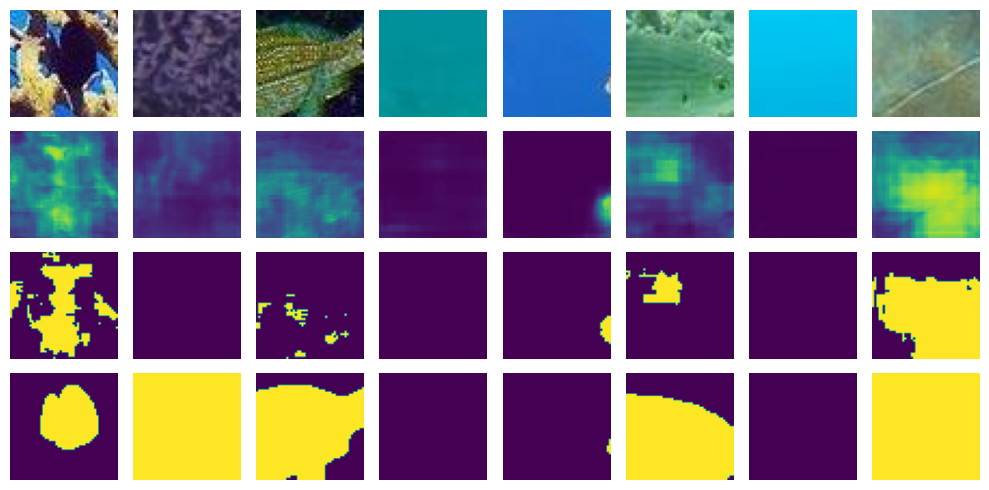

Epoch 1/4
203/203 [==============================] - 95s 468ms/step - loss: 0.4405 - binary_accuracy: 0.7901 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7903 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4400 - binary_accuracy: 0.7902 - val_loss: 0.4424 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 52ms/step


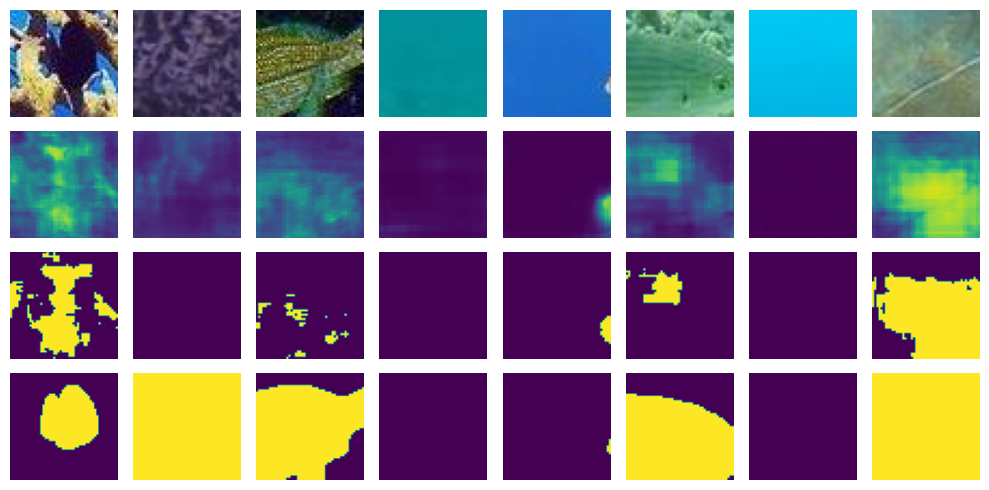

Epoch 1/4
203/203 [==============================] - 94s 460ms/step - loss: 0.4392 - binary_accuracy: 0.7904 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7903 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7904 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


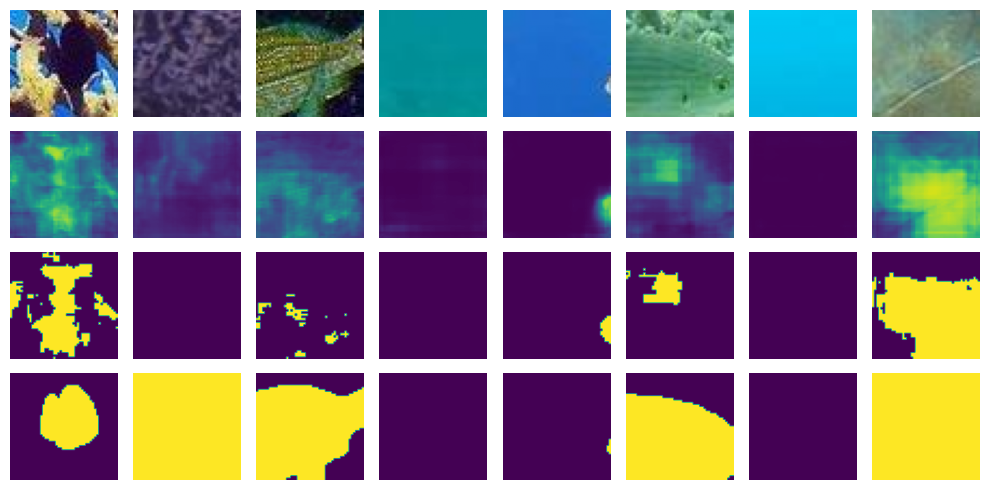

Epoch 1/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4398 - binary_accuracy: 0.7902 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7904 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4394 - binary_accuracy: 0.7904 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


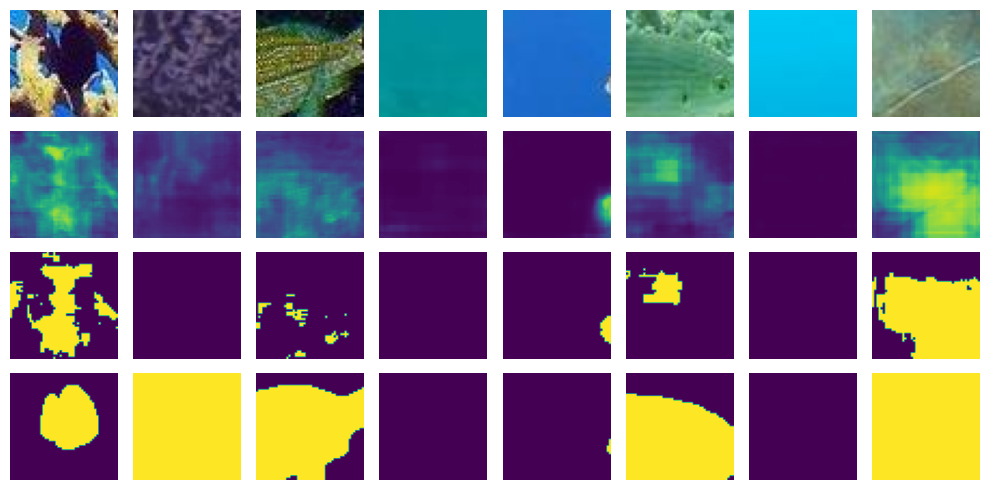

Epoch 1/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4395 - binary_accuracy: 0.7905 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4403 - binary_accuracy: 0.7899 - val_loss: 0.4425 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4400 - binary_accuracy: 0.7901 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 68ms/step


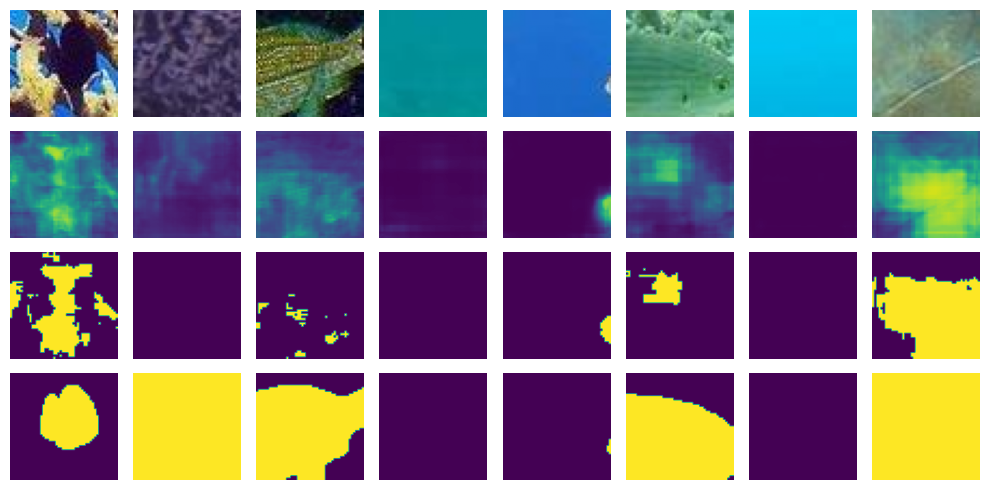

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7900 - val_loss: 0.4425 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4397 - binary_accuracy: 0.7903 - val_loss: 0.4425 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4389 - binary_accuracy: 0.7907 - val_loss: 0.4425 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


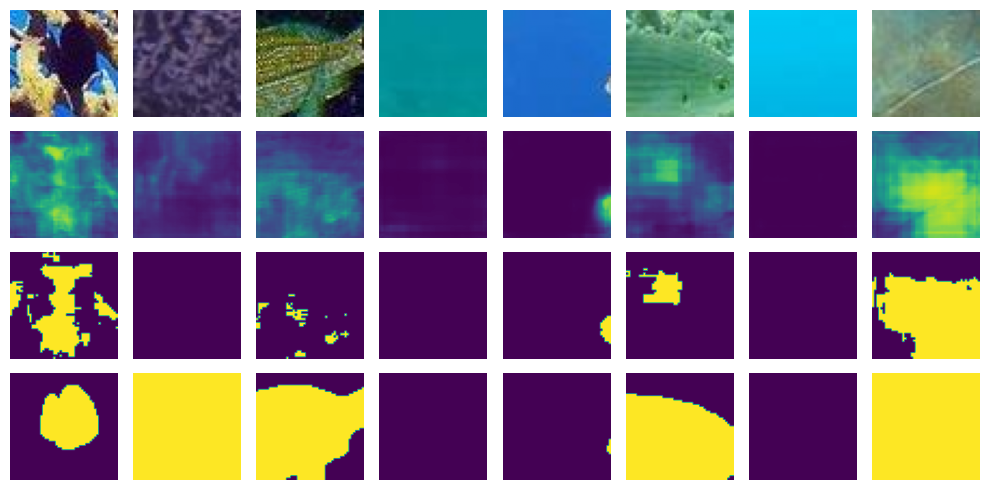

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4398 - binary_accuracy: 0.7900 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4397 - binary_accuracy: 0.7905 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4392 - binary_accuracy: 0.7905 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


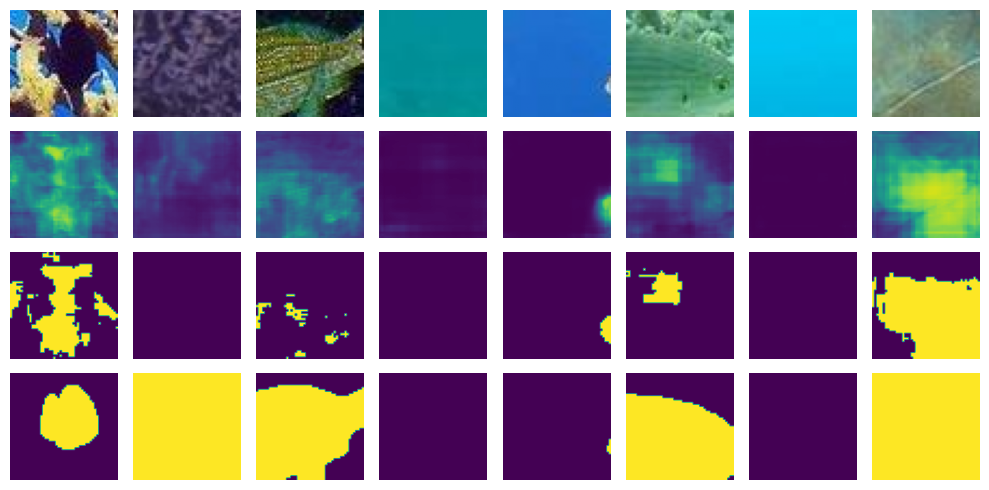

Epoch 1/4
203/203 [==============================] - 94s 464ms/step - loss: 0.4401 - binary_accuracy: 0.7900 - val_loss: 0.4426 - val_binary_accuracy: 0.7882 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 460ms/step - loss: 0.4398 - binary_accuracy: 0.7902 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4393 - binary_accuracy: 0.7906 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


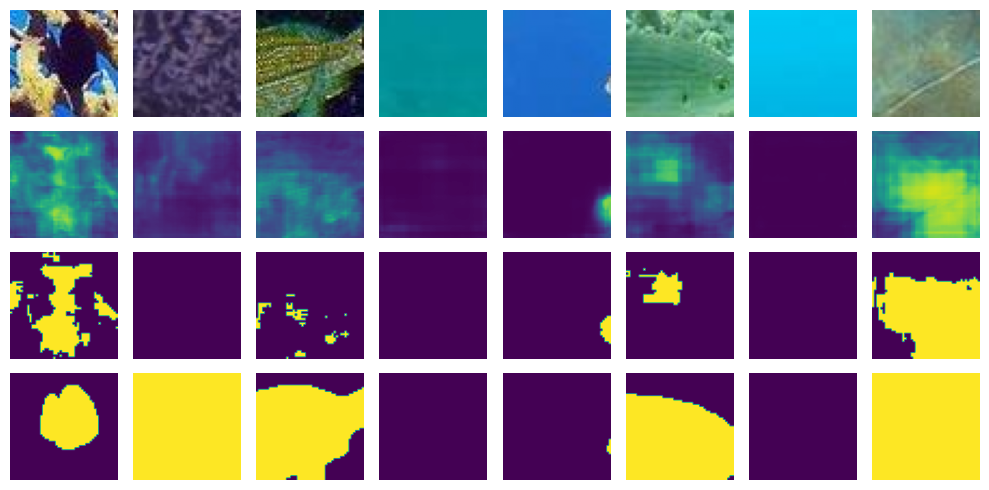

Epoch 1/4
203/203 [==============================] - 94s 464ms/step - loss: 0.4391 - binary_accuracy: 0.7907 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 95s 464ms/step - loss: 0.4391 - binary_accuracy: 0.7903 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4389 - binary_accuracy: 0.7905 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 56ms/step


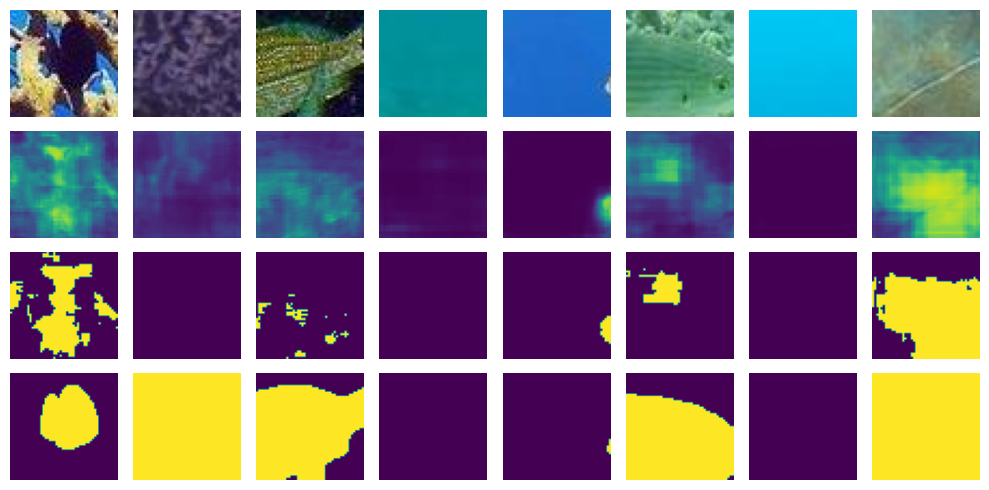

Epoch 1/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4395 - binary_accuracy: 0.7903 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4399 - binary_accuracy: 0.7902 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4390 - binary_accuracy: 0.7906 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 64ms/step


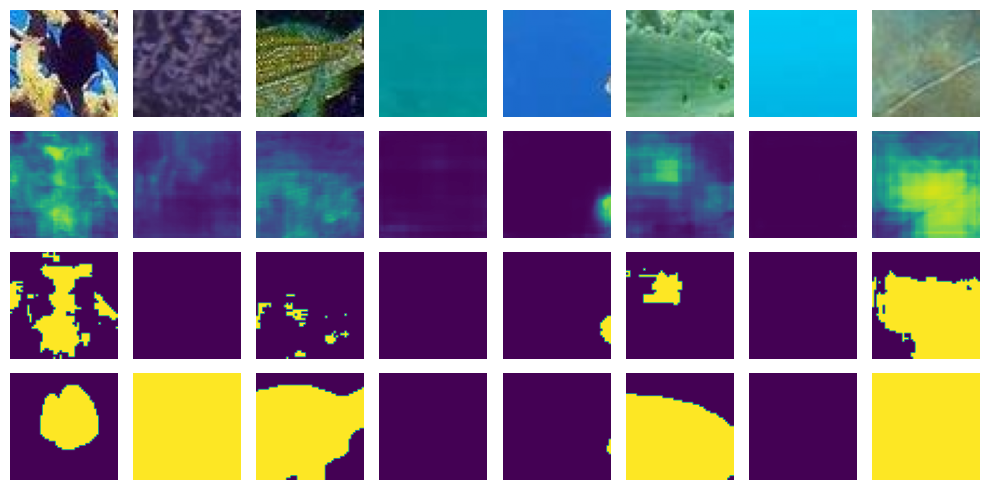

Epoch 1/4
203/203 [==============================] - 97s 474ms/step - loss: 0.4395 - binary_accuracy: 0.7904 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 96s 469ms/step - loss: 0.4396 - binary_accuracy: 0.7905 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4393 - binary_accuracy: 0.7904 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 60ms/step


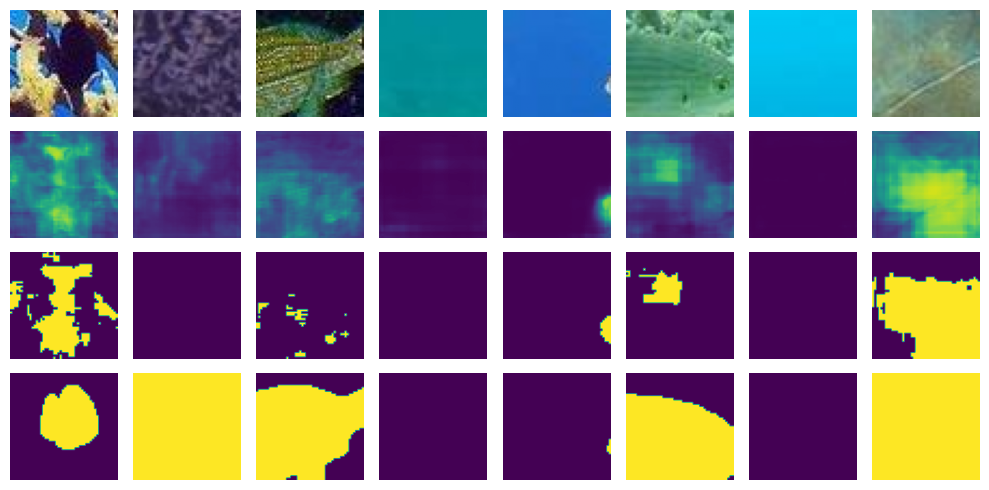

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4395 - binary_accuracy: 0.7904 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 96s 471ms/step - loss: 0.4388 - binary_accuracy: 0.7908 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 96s 474ms/step - loss: 0.4386 - binary_accuracy: 0.7912 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


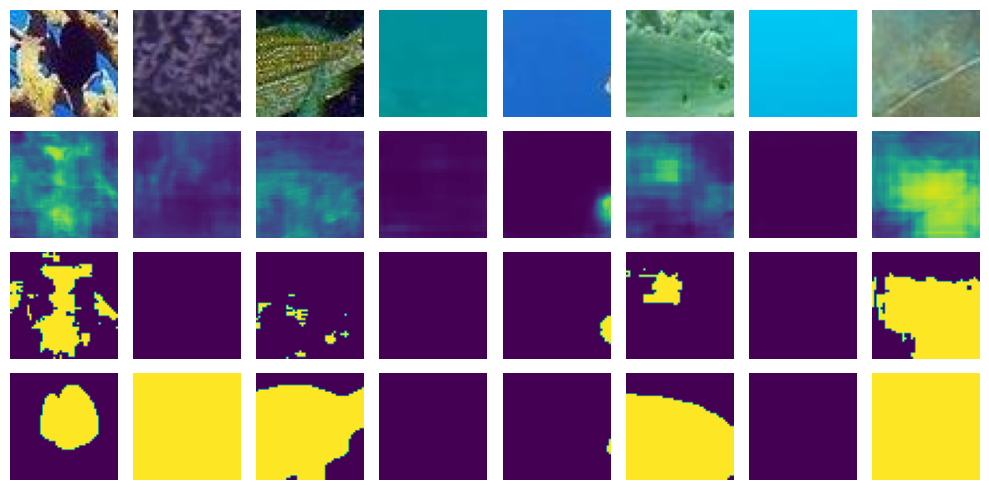

Epoch 1/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4391 - binary_accuracy: 0.7906 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 96s 472ms/step - loss: 0.4392 - binary_accuracy: 0.7903 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 467ms/step - loss: 0.4396 - binary_accuracy: 0.7903 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 56ms/step


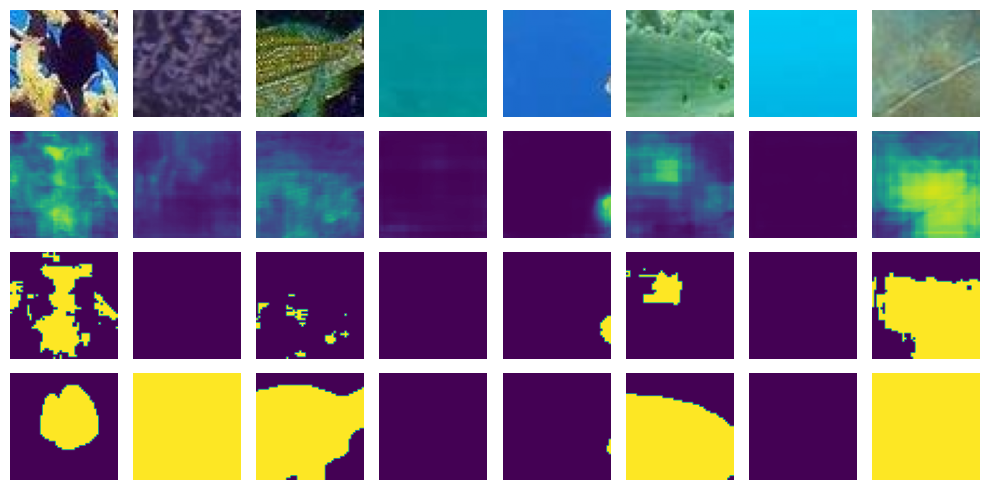

Epoch 1/4
203/203 [==============================] - 95s 464ms/step - loss: 0.4395 - binary_accuracy: 0.7903 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4394 - binary_accuracy: 0.7903 - val_loss: 0.4426 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4386 - binary_accuracy: 0.7909 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


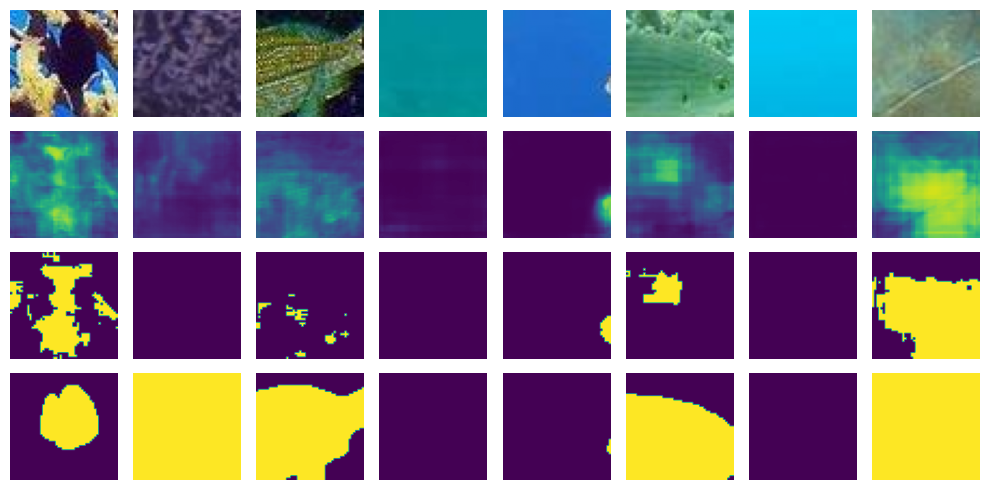

Epoch 1/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4386 - binary_accuracy: 0.7911 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4392 - binary_accuracy: 0.7906 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4389 - binary_accuracy: 0.7909 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 71ms/step


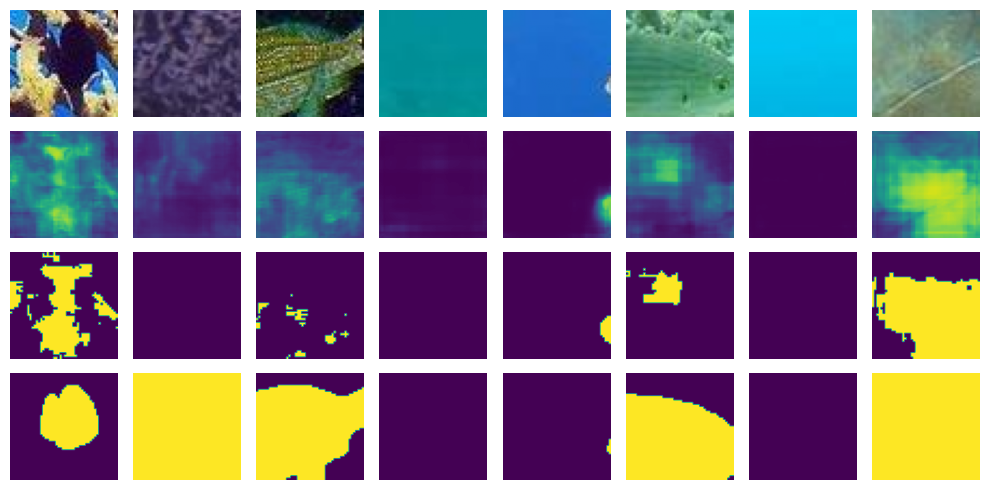

Epoch 1/4
203/203 [==============================] - 94s 460ms/step - loss: 0.4388 - binary_accuracy: 0.7913 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 464ms/step - loss: 0.4388 - binary_accuracy: 0.7907 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4393 - binary_accuracy: 0.7908 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


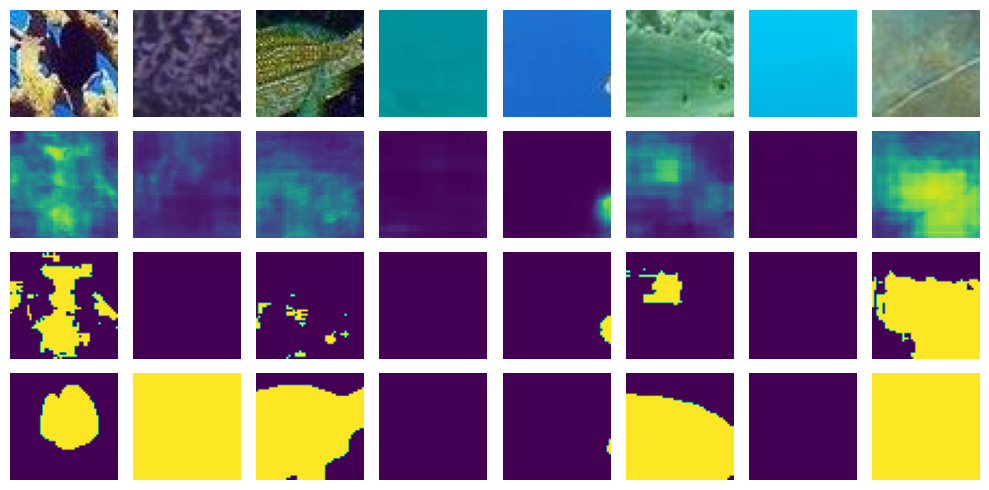

Epoch 1/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4386 - binary_accuracy: 0.7909 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4384 - binary_accuracy: 0.7911 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4391 - binary_accuracy: 0.7904 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 58ms/step


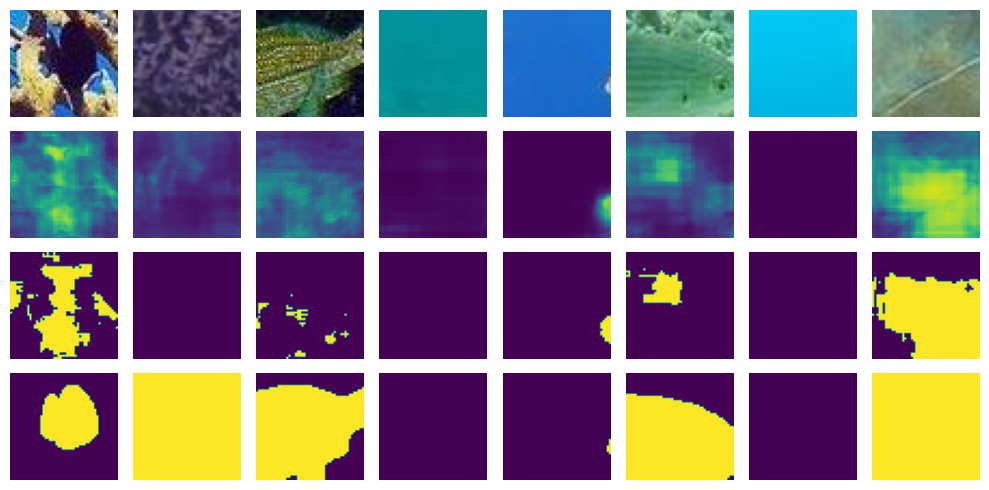

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4391 - binary_accuracy: 0.7909 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4383 - binary_accuracy: 0.7912 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 464ms/step - loss: 0.4387 - binary_accuracy: 0.7910 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 56ms/step


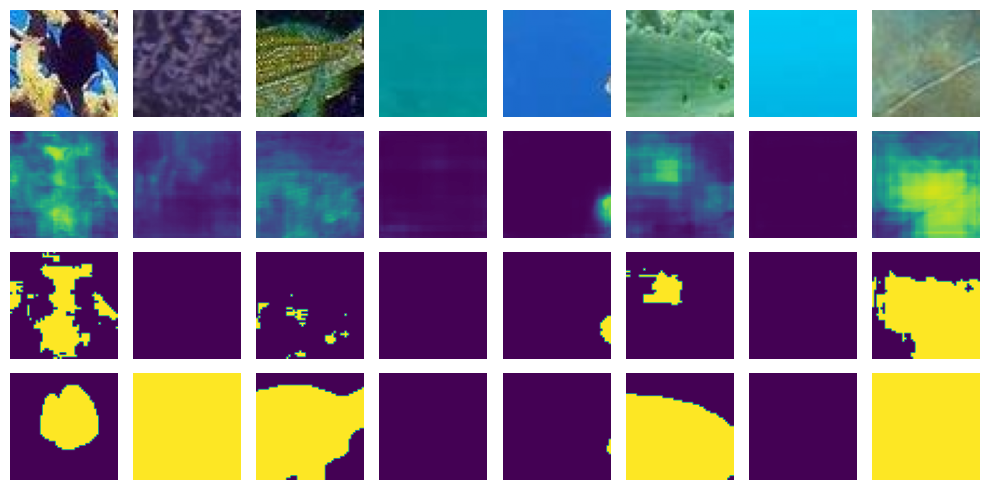

Epoch 1/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4388 - binary_accuracy: 0.7909 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4392 - binary_accuracy: 0.7905 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4388 - binary_accuracy: 0.7906 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


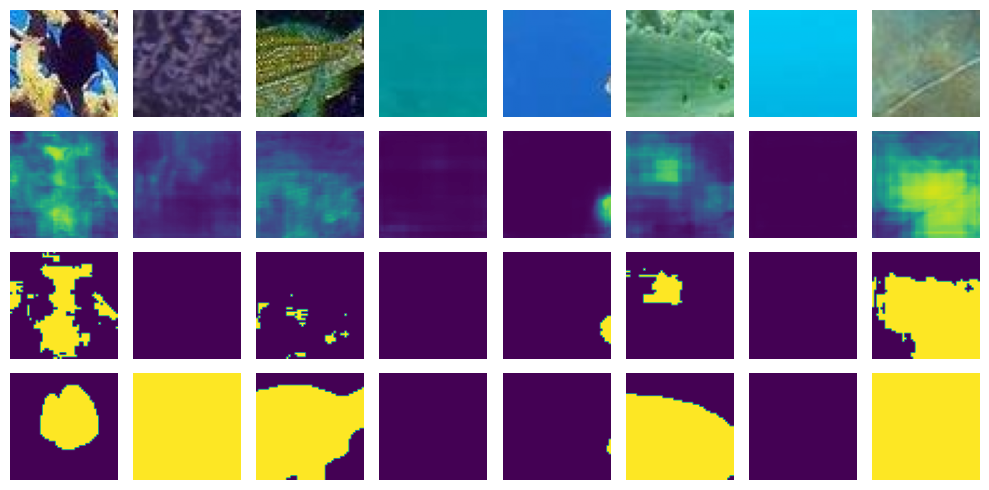

Epoch 1/4
203/203 [==============================] - 100s 493ms/step - loss: 0.4384 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 104s 510ms/step - loss: 0.4389 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 97s 478ms/step - loss: 0.4387 - binary_accuracy: 0.7907 - val_loss: 0.4427 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


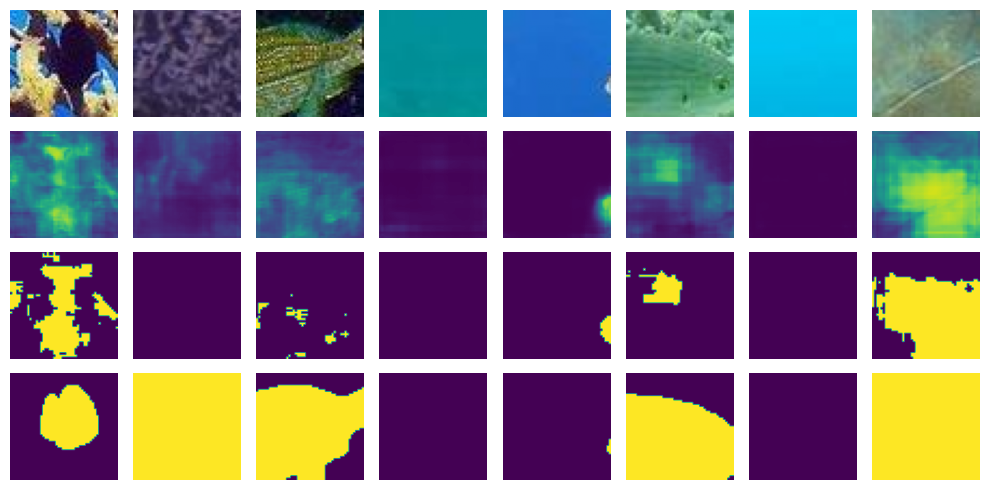

Epoch 1/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4387 - binary_accuracy: 0.7912 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4381 - binary_accuracy: 0.7913 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 462ms/step - loss: 0.4394 - binary_accuracy: 0.7904 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 56ms/step


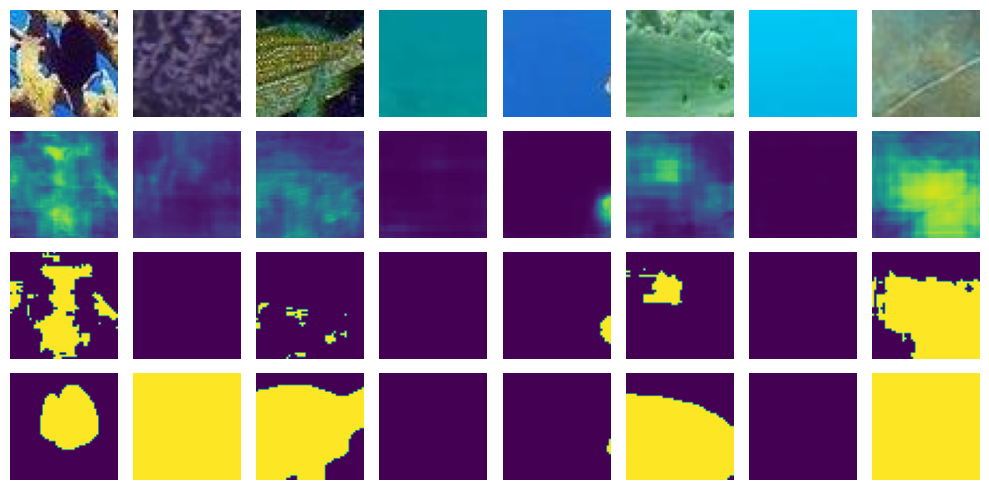

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4385 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4386 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4384 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 59ms/step


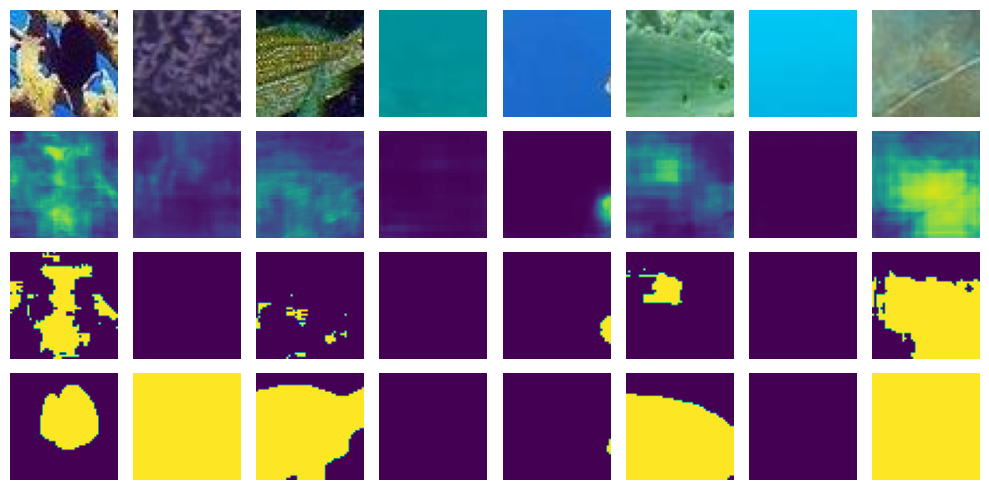

Epoch 1/4
203/203 [==============================] - 95s 464ms/step - loss: 0.4385 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 460ms/step - loss: 0.4381 - binary_accuracy: 0.7913 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 95s 465ms/step - loss: 0.4391 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


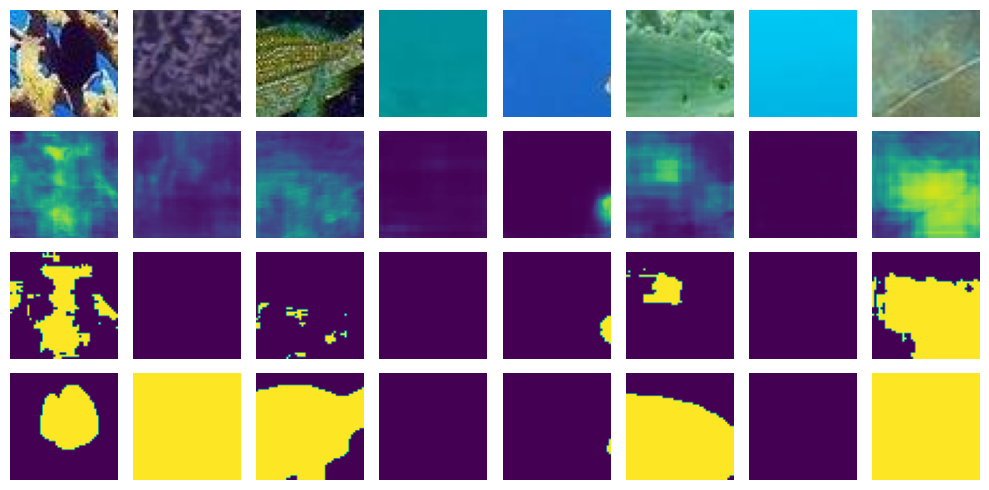

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4384 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4382 - binary_accuracy: 0.7915 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4381 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


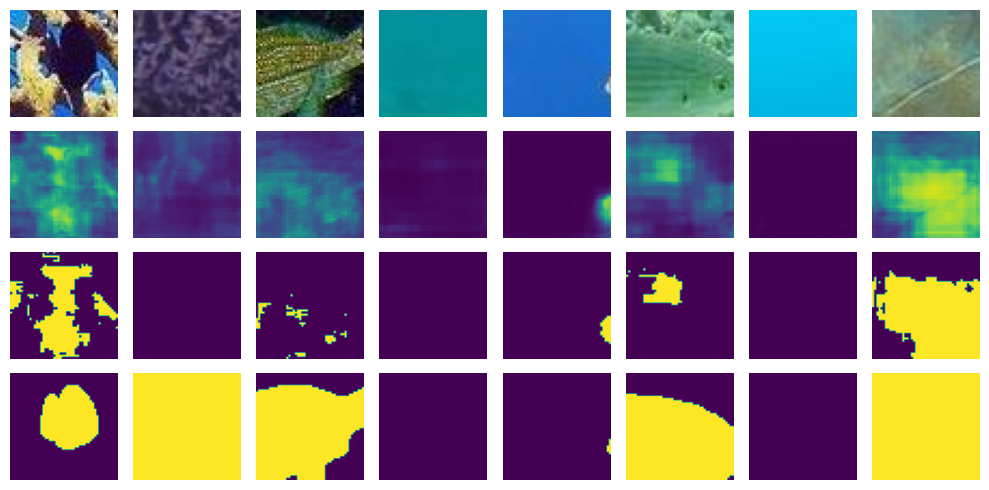

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4384 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4380 - binary_accuracy: 0.7914 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4387 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


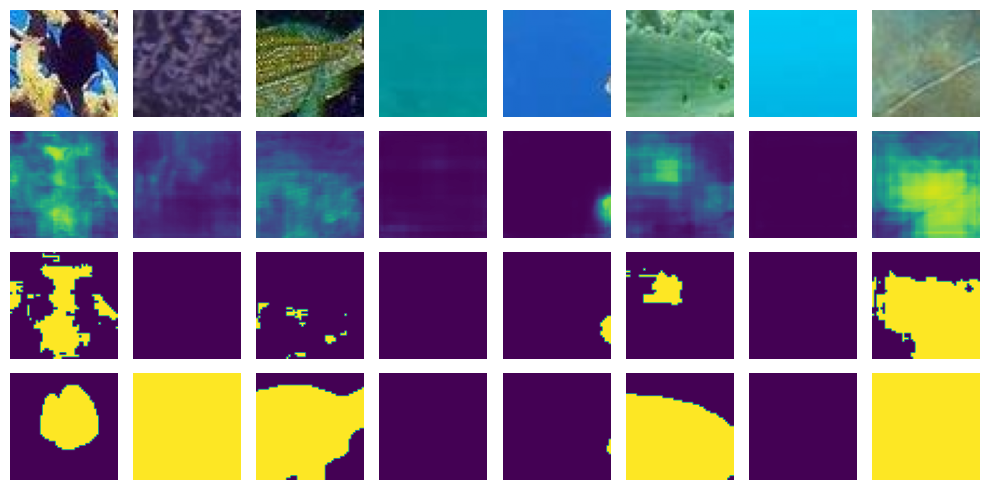

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4384 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4379 - binary_accuracy: 0.7913 - val_loss: 0.4429 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4382 - binary_accuracy: 0.7909 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


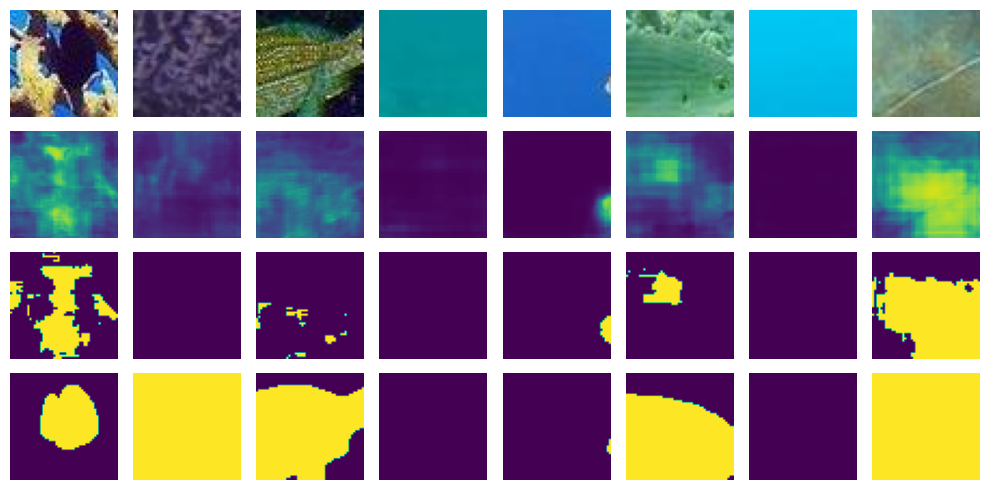

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4377 - binary_accuracy: 0.7915 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4377 - binary_accuracy: 0.7917 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4381 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 51ms/step


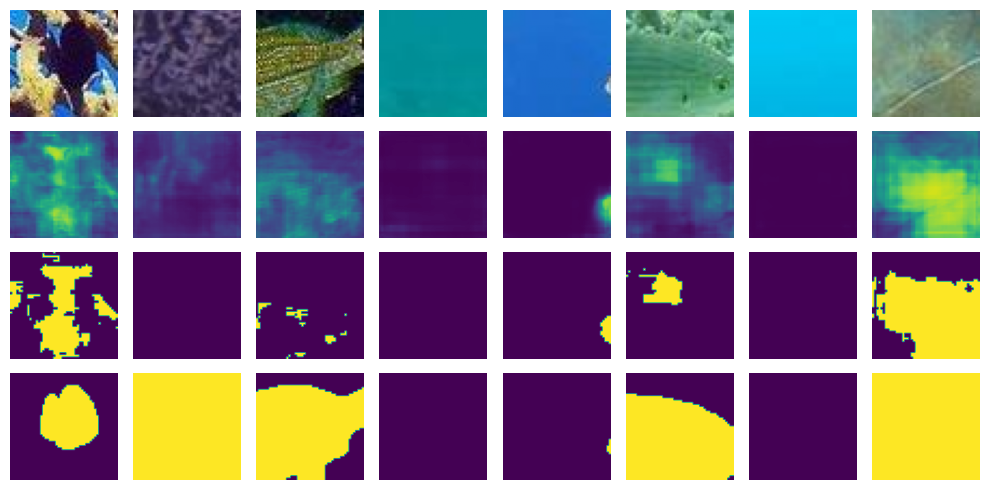

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4383 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 94s 461ms/step - loss: 0.4384 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4388 - binary_accuracy: 0.7908 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 54ms/step


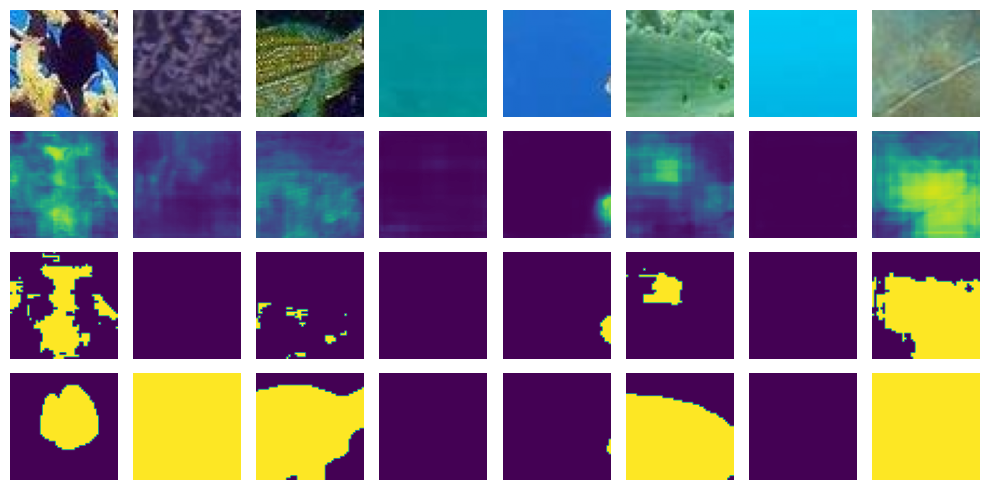

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4383 - binary_accuracy: 0.7911 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4385 - binary_accuracy: 0.7912 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4388 - binary_accuracy: 0.7908 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


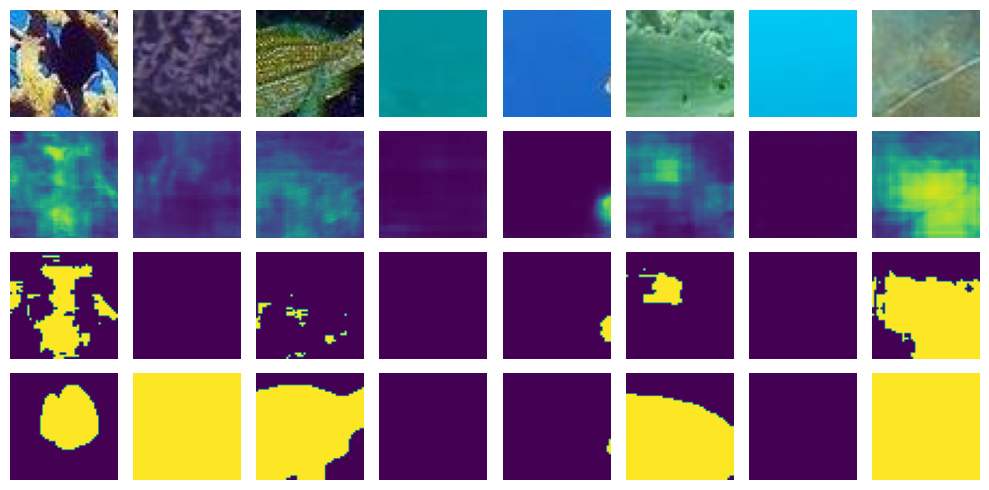

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4386 - binary_accuracy: 0.7909 - val_loss: 0.4429 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4381 - binary_accuracy: 0.7913 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 455ms/step - loss: 0.4382 - binary_accuracy: 0.7913 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 52ms/step


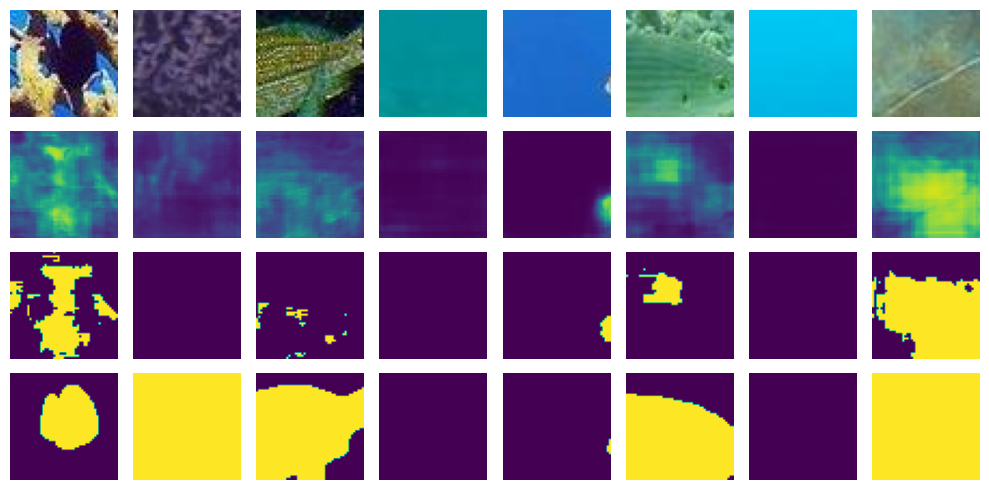

Epoch 1/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4378 - binary_accuracy: 0.7917 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4379 - binary_accuracy: 0.7915 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4381 - binary_accuracy: 0.7912 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


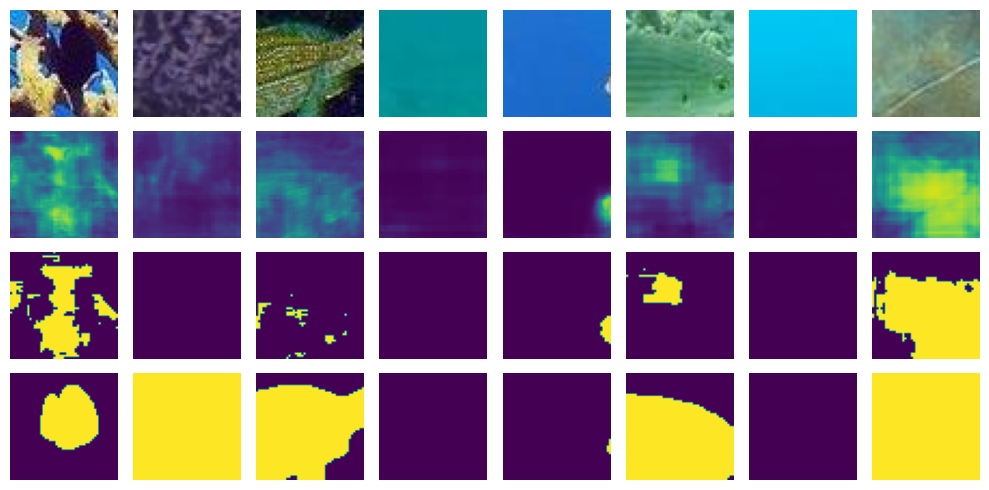

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4380 - binary_accuracy: 0.7912 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4384 - binary_accuracy: 0.7914 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4379 - binary_accuracy: 0.7911 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 50ms/step


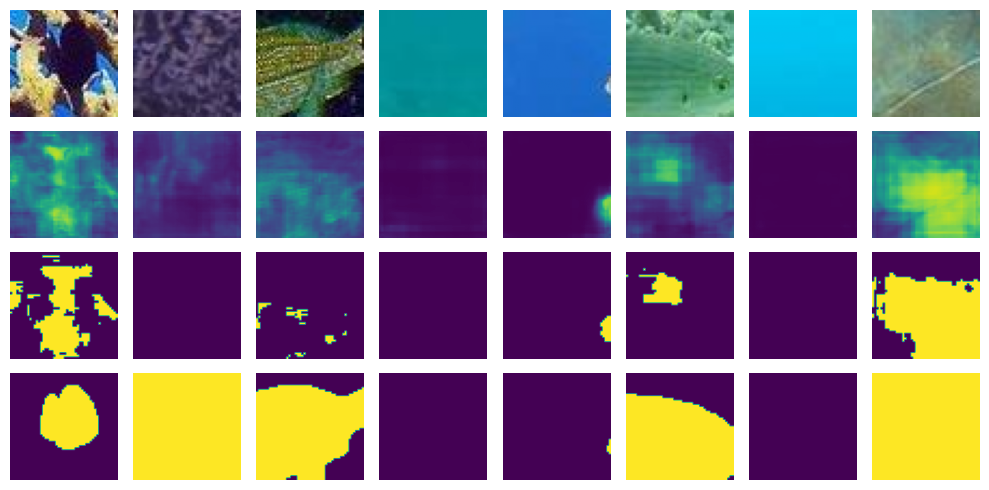

Epoch 1/4
203/203 [==============================] - 94s 459ms/step - loss: 0.4386 - binary_accuracy: 0.7907 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4382 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4381 - binary_accuracy: 0.7914 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


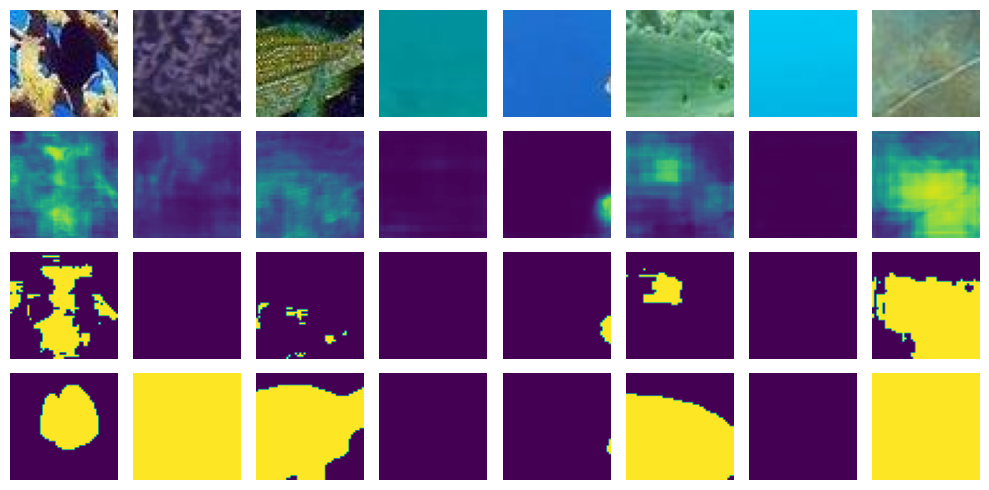

Epoch 1/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4384 - binary_accuracy: 0.7912 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4381 - binary_accuracy: 0.7910 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4379 - binary_accuracy: 0.7916 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 60ms/step


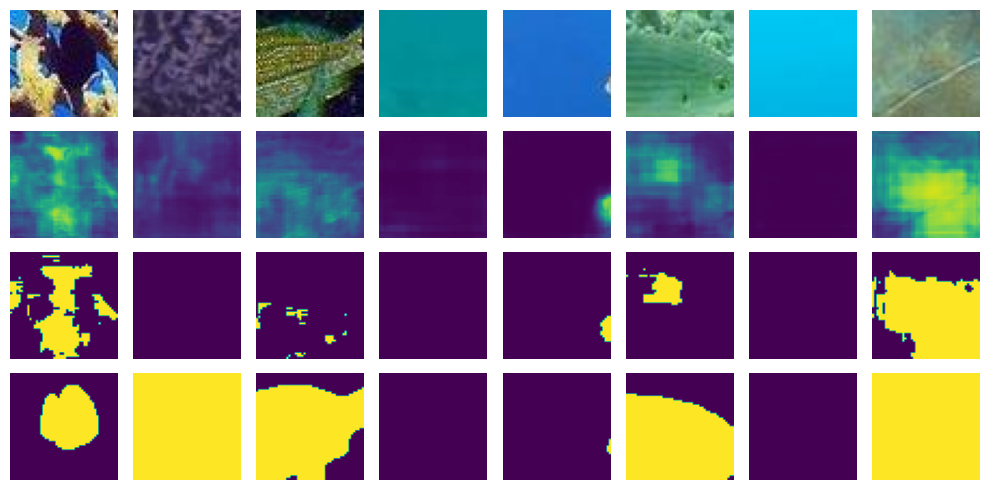

Epoch 1/4
203/203 [==============================] - 93s 459ms/step - loss: 0.4381 - binary_accuracy: 0.7913 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4376 - binary_accuracy: 0.7915 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4385 - binary_accuracy: 0.7910 - val_loss: 0.4428 - val_binary_accuracy: 0.7881 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 55ms/step


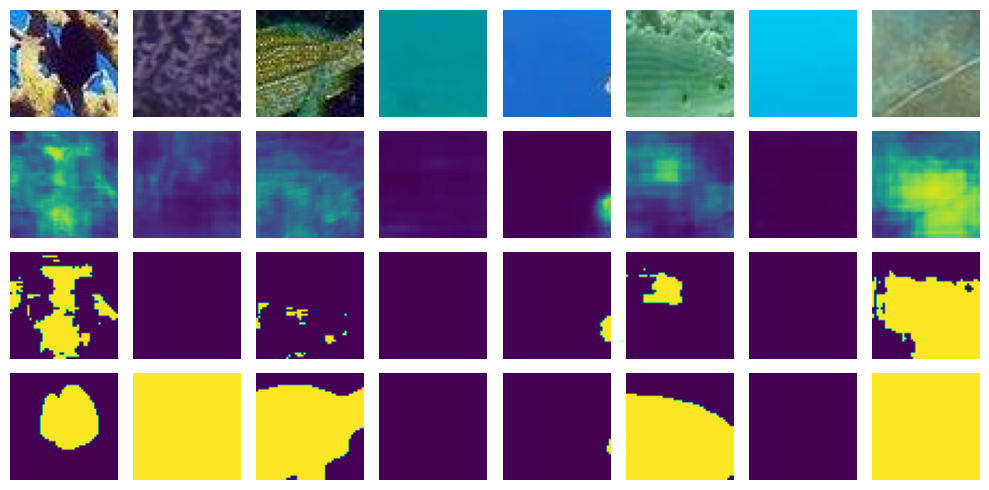

Epoch 1/4
203/203 [==============================] - 94s 463ms/step - loss: 0.4378 - binary_accuracy: 0.7913 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4373 - binary_accuracy: 0.7917 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
203/203 [==============================] - 93s 458ms/step - loss: 0.4380 - binary_accuracy: 0.7913 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 4/4
1/1 [==============================] - 0s 53ms/step


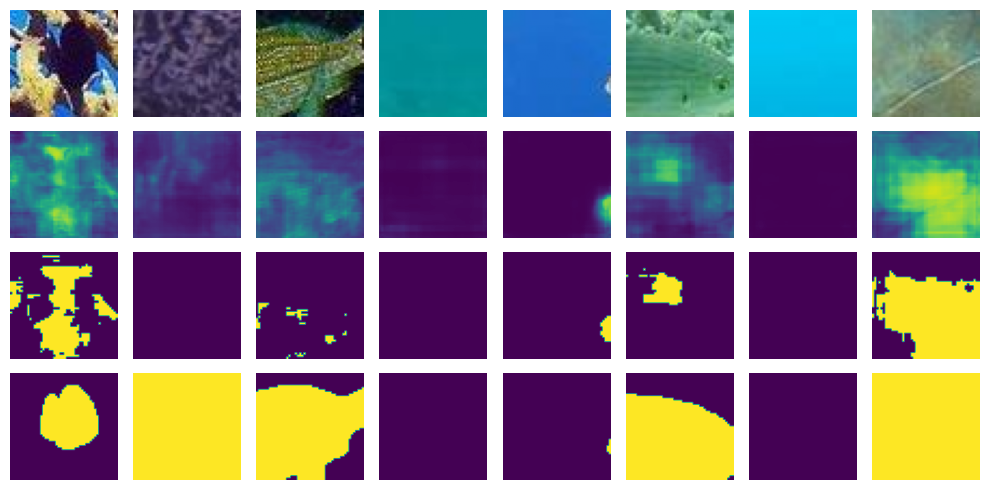

Epoch 1/4
203/203 [==============================] - 93s 456ms/step - loss: 0.4383 - binary_accuracy: 0.7911 - val_loss: 0.4428 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 2/4
203/203 [==============================] - 93s 457ms/step - loss: 0.4380 - binary_accuracy: 0.7914 - val_loss: 0.4429 - val_binary_accuracy: 0.7880 - lr: 2.5000e-05
Epoch 3/4
 45/203 [=====>........................] - ETA: 1:02 - loss: 0.4387 - binary_accuracy: 0.7917

KeyboardInterrupt: 

In [166]:
ntest = 8
batch_size = 128
(tx,ty) = next(iter(ds_te.batch(ntest)))
while(True):
    tyhat = model_unet.predict(tx)
    fig,axs = plt.subplots(nrows=4, ncols=ntest, figsize=(10,5))
    for ti in range(ntest):
        axs[0,ti].imshow(tx[ti])
        axs[1,ti].imshow(tyhat[ti,:,:,0], vmin=0, vmax=1)
        axs[2,ti].imshow(tyhat[ti,:,:,0]>0.5, vmin=0, vmax=1)
        axs[3,ti].imshow(ty[ti], vmin=0, vmax=1)
    for ax in axs.flatten():
        ax.axis("off")
    plt.tight_layout()
    plt.show()
    model_unet.fit(ds_s_tr.shuffle(1024).batch(batch_size), validation_data=ds_s_val.batch(batch_size), epochs=4, callbacks=callbacks)

89/89 [==============================] - 4s 33ms/step - loss: 0.4733 - binary_accuracy: 0.7715 - auc: 0.8396
Test loss: 0.47334498167037964
Test accuracy: 0.7714926600456238
(2828, 50, 50, 1)
(2828, 1)
(array([3.6487579e-06, 3.9642860e-06, 6.3329385e-06, ..., 9.9518734e-01,
       9.9545789e-01, 9.9585444e-01], dtype=float32), array([1, 1, 1, ..., 1, 1, 1], dtype=int64))


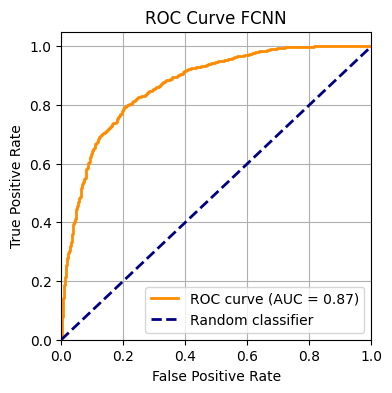

0.8711391024101208

In [48]:
score = model_unet.evaluate(images_te, masks_te)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

predictions_unet = model_unet.predict(images_te, verbose=0)
pred_proba_te = np.array([x[25,25] for x in predictions_unet])

print(predictions_unet.shape)
print(pred_proba_te.shape)
print(np.unique(pred_proba_te, return_counts=True))
plot_AUC(labels_te,pred_proba_te,"FCNN")

62/62 [==============================] - 8s 115ms/step - loss: 0.3537 - binary_accuracy: 0.8522 - auc: 0.8775
Test loss: 0.3536665141582489
Test accuracy: 0.852228581905365
(1981, 100, 100, 1)
(1981, 1)
(array([1.6863920e-05, 1.8522545e-05, 1.8816541e-05, ..., 9.9361855e-01,
       9.9481249e-01, 9.9527532e-01], dtype=float32), array([1, 1, 1, ..., 1, 1, 1], dtype=int64))


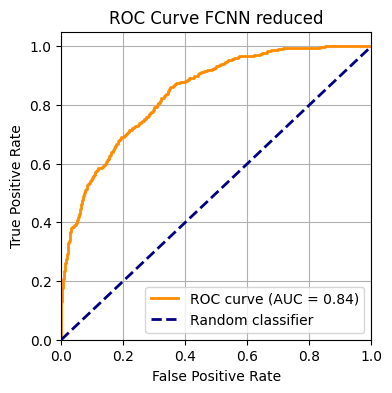

0.843246327200114

In [47]:
score = model_unet_red.evaluate(images_red_te, masks_red_te)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

predictions_unet_red = model_unet_red.predict(images_red_te, verbose=0)
pred_proba_te_red = np.array([x[25,25] for x in predictions_unet_red])

print(predictions_unet_red.shape)
print(pred_proba_te_red.shape)
print(np.unique(pred_proba_te, return_counts=True))
plot_AUC(labels_red_te,pred_proba_te,"FCNN reduced")

In [134]:
# plot_confustion_matrix(labels_te,pred_proba_te>0.5)

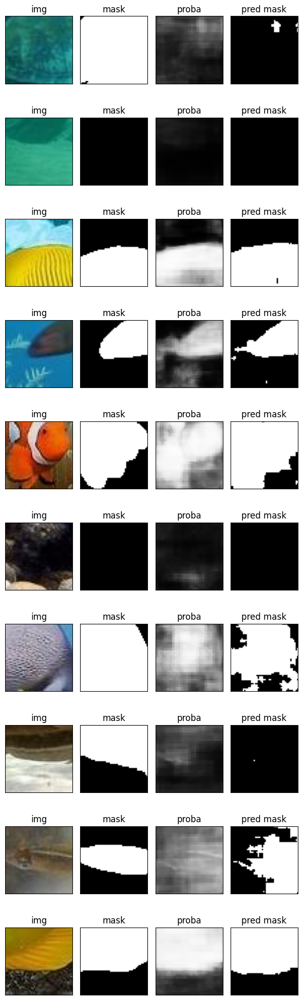

In [58]:
amt = 10
fig, ax = plt.subplots(amt,4,figsize=(6,2*amt))
random_idx = np.random.choice(len(masks_te), size=amt, replace=False)

for i,(im,m,p) in enumerate(zip(images_te[random_idx],masks_te[random_idx],predictions_unet[random_idx])):
    ax[i,0].imshow(im)
    ax[i,1].imshow(m, cmap="gray", vmin=0, vmax=1)
    ax[i,2].imshow(p, cmap="gray", vmin=0, vmax=1)
    ax[i,3].imshow(p>0.5, cmap="gray", vmin=0, vmax=1)
    
    ax[i,0].set_title("img")
    ax[i,1].set_title("mask")
    ax[i,2].set_title("proba")
    ax[i,3].set_title("pred mask")
    
    
    for a in ax.flatten():
        a.set_xticks([])
        a.set_yticks([])
plt.tight_layout()

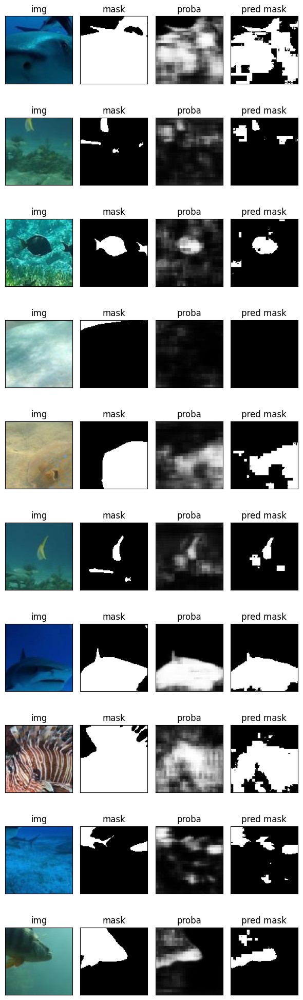

In [58]:
amt = 10
fig, ax = plt.subplots(amt,4,figsize=(6,2*amt))
random_idx = np.random.choice(len(masks_red_te), size=amt, replace=False)

for i,(im,m,p) in enumerate(zip(images_red_te[random_idx],masks_red_te[random_idx],predictions_unet_red[random_idx])):
    ax[i,0].imshow(im)
    ax[i,1].imshow(m, cmap="gray", vmin=0, vmax=1)
    ax[i,2].imshow(p, cmap="gray", vmin=0, vmax=1)
    ax[i,3].imshow(p>0.4, cmap="gray", vmin=0, vmax=1)
    
    ax[i,0].set_title("img")
    ax[i,1].set_title("mask")
    ax[i,2].set_title("proba")
    ax[i,3].set_title("pred mask")
    
    
    for a in ax.flatten():
        a.set_xticks([])
        a.set_yticks([])
plt.tight_layout()

# Load models

In [85]:
# simple NN
model_nn = keras.models.load_model(pathlib.Path(ddir, "models", "model_nn.keras"))
history_nn = np.load(pathlib.Path(ddir, "models", "model_nn_history.npy"), allow_pickle=True).item()
model_nn_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_nn_aug.keras"))
history_nn_aug = np.load(pathlib.Path(ddir, "models", "model_nn_aug_history.npy"), allow_pickle=True).item()


# assignment example
model_cnn1 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn1.keras"))
history_cnn1 = np.load(pathlib.Path(ddir, "models", "model_cnn1_history.npy"), allow_pickle=True).item()
model_cnn1_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn1_aug.keras"))
history_cnn1_aug = np.load(pathlib.Path(ddir, "models", "model_cnn1_aug_history.npy"), allow_pickle=True).item()


# RPS example
model_cnn2 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2.keras"))
history_cnn2 = np.load(pathlib.Path(ddir, "models", "model_cnn2_history.npy"), allow_pickle=True).item()
model_cnn2_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_aug.keras"))
history_cnn2_aug = np.load(pathlib.Path(ddir, "models", "model_cnn2_aug_history.npy"), allow_pickle=True).item()

model_cnn2_2 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_2.keras"))
history_cnn2_2 = np.load(pathlib.Path(ddir, "models", "model_cnn2_2_history.npy"), allow_pickle=True).item()
# model_cnn2_2_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_2_aug.keras"))
# history_cnn2_2_aug = np.load(pathlib.Path(ddir, "models", "model_cnn2_2_aug_history.npy"), allow_pickle=True).item()

# Ours
model_cnn3 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn3.keras"))
history_cnn3 = np.load(pathlib.Path(ddir, "models", "model_cnn3_history.npy"), allow_pickle=True).item()
model_cnn3_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn3_aug.keras"))
history_cnn3_aug = np.load(pathlib.Path(ddir, "models", "model_cnn3_aug_history.npy"), allow_pickle=True).item()

In [8]:
# simple NN
model_nn_red = keras.models.load_model(pathlib.Path(ddir, "models", "model_nn_red.keras"))
history_nn_red = np.load(pathlib.Path(ddir, "models", "model_nn_red_history.npy"), allow_pickle=True).item()
model_nn_red_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_nn_red_aug.keras"))
history_nn_red_aug = np.load(pathlib.Path(ddir, "models", "model_nn_red_aug_history.npy"), allow_pickle=True).item()


# assignment example
model_cnn1_red = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn1_red.keras"))
history_cnn1_red = np.load(pathlib.Path(ddir, "models", "model_cnn1_red_history.npy"), allow_pickle=True).item()
model_cnn1_red_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn1_red_aug.keras"))
history_cnn1_red_aug = np.load(pathlib.Path(ddir, "models", "model_cnn1_red_aug_history.npy"), allow_pickle=True).item()


# RPS example
model_cnn2_red = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_red.keras"))
history_cnn2_red = np.load(pathlib.Path(ddir, "models", "model_cnn2_red_history.npy"), allow_pickle=True).item()
model_cnn2_red_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_red_aug.keras"))
history_cnn2_red_aug = np.load(pathlib.Path(ddir, "models", "model_cnn2_red_aug_history.npy"), allow_pickle=True).item()

model_cnn2_2_red = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_2_red.keras"))
history_cnn2_2_red = np.load(pathlib.Path(ddir, "models", "model_cnn2_2_red_history.npy"), allow_pickle=True).item()
model_cnn2_2_red_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_2_red_aug.keras"))
history_cnn2_2_red_aug = np.load(pathlib.Path(ddir, "models", "model_cnn2_2_red_aug_history.npy"), allow_pickle=True).item()

# Ours
model_cnn3_red = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn3_red.keras"))
history_cnn3_red = np.load(pathlib.Path(ddir, "models", "model_cnn3_red_history.npy"), allow_pickle=True).item()
model_cnn3_red_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn3_red_aug.keras"))
history_cnn3_red_aug = np.load(pathlib.Path(ddir, "models", "model_cnn3_red_aug_history.npy"), allow_pickle=True).item()

In [9]:
model_simple = keras.models.load_model(pathlib.Path(ddir, "models", "model_full_simple2.keras"))
history_simple = np.load(pathlib.Path(ddir, "models", "model_full_simple2_history.npy"), allow_pickle=True).item()

model_unet = keras.models.load_model(pathlib.Path(ddir, "models", "model_full_unet2.keras"))
history_unet = np.load(pathlib.Path(ddir, "models", "model_full_unet2_history.npy"), allow_pickle=True).item()

model_simple_red = keras.models.load_model(pathlib.Path(ddir, "models", "model_full_simple_red2.keras"))
history_simple_red = np.load(pathlib.Path(ddir, "models", "model_full_simple_red2_history.npy"), allow_pickle=True).item()

model_unet_red = keras.models.load_model(pathlib.Path(ddir, "models", "model_full_unet_red2.keras"))
history_unet_red = np.load(pathlib.Path(ddir, "models", "model_full_unet_red2_history.npy"), allow_pickle=True).item()

In [10]:
best_roc_auc = 0
models = list(pathlib.Path(ddir, "models","checkpoints").glob("*nn*.keras"))
models.extend(pathlib.Path(ddir, "models").glob("*nn*.keras"))
for checkpoint in models:
    if "red2" in checkpoint.name:
        continue
    if "red" in checkpoint.name:
        test_set = patches_test_reduced
        test_labels = labels_test_reduced
    else:
        test_set = patches_test
        test_labels = labels_test
    print("---",checkpoint.name)
    model = keras.models.load_model(checkpoint)
    labels_proba = model.predict(test_set.astype(float)/255, verbose=0)
    labels_pred = labels_proba > 0.5
    fpr, tpr, _ = roc_curve(test_labels, labels_proba)
    roc_auc = auc(fpr, tpr)
    
    print(f"Accuracy: {sklearn.metrics.accuracy_score(test_labels, labels_pred):.4f}%")
    print(f"AUC: {roc_auc:.4f}")
    
    if roc_auc > best_roc_auc:
        best_roc_auc = roc_auc
        best_checkpoint = checkpoint
        best = model
        
print(f"Best checkpoint: {best_checkpoint.name}")

--- checkpoint_best_model_cnn1_2023-12-01_01-49-06.keras
Accuracy: 0.7733%
AUC: 0.8510
--- checkpoint_best_model_cnn1_aug_2023-12-01_02-50-18.keras
Accuracy: 0.7443%
AUC: 0.8354
--- checkpoint_best_model_cnn1_red_2023-12-07_01-23-47.keras
Accuracy: 0.7163%
AUC: 0.8024
--- checkpoint_best_model_cnn1_red_2023-12-08_16-35-11.keras
Accuracy: 0.7213%
AUC: 0.8002
--- checkpoint_best_model_cnn1_red_2023-12-08_21-39-57.keras
Accuracy: 0.7781%
AUC: 0.8707
--- checkpoint_best_model_cnn1_red_aug_2023-12-07_01-34-02.keras
Accuracy: 0.7680%
AUC: 0.8549
--- checkpoint_best_model_cnn1_red_aug_2023-12-08_16-46-32.keras
Accuracy: 0.4995%
AUC: 0.4526
--- checkpoint_best_model_cnn1_red_aug_2023-12-08_21-54-14.keras
Accuracy: 0.4995%
AUC: 0.3929
--- checkpoint_best_model_cnn1_red_aug_2023-12-09_02-47-22.keras
Accuracy: 0.4872%
AUC: 0.4636
--- checkpoint_best_model_cnn2_2023-12-01_01-55-46.keras
Accuracy: 0.7903%
AUC: 0.8686
--- checkpoint_best_model_cnn2_2023-12-01_12-13-59.keras
Accuracy: 0.7652%
AUC: 0.

# Plot

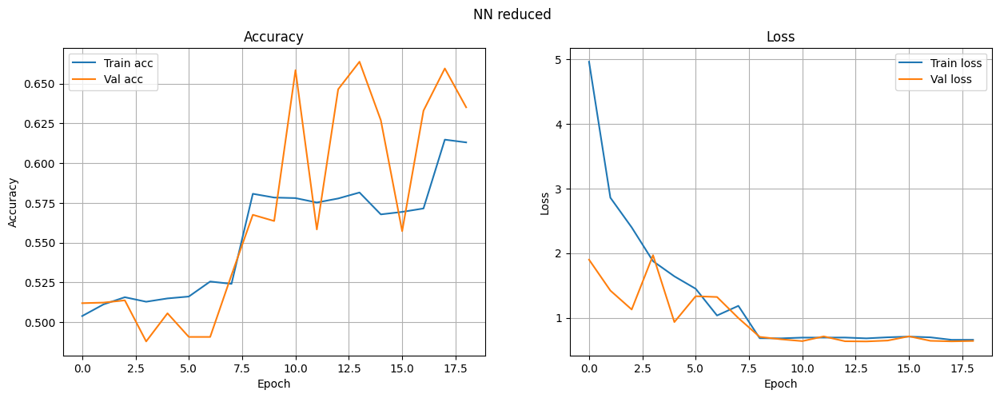

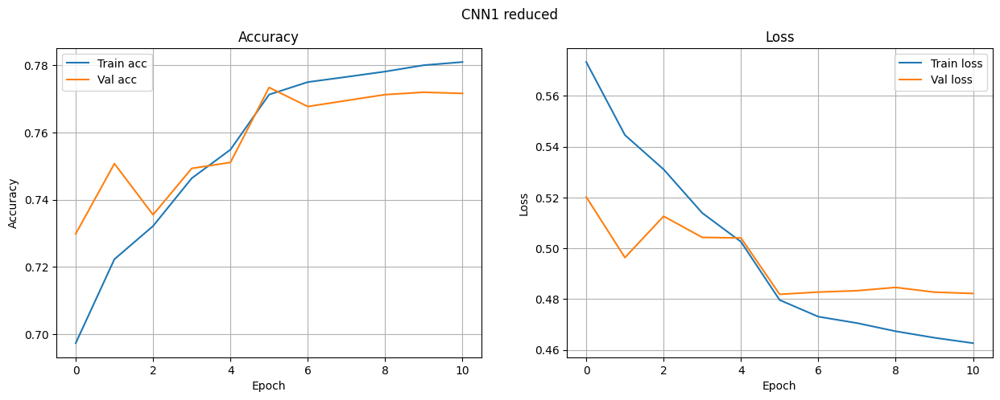

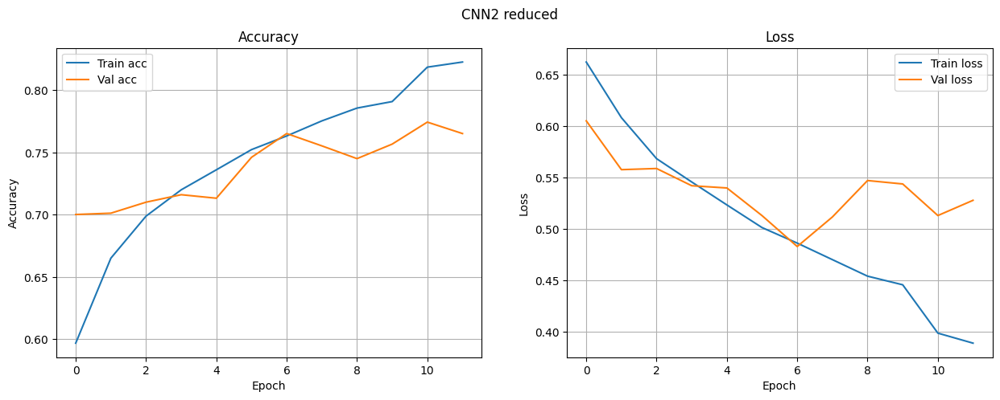

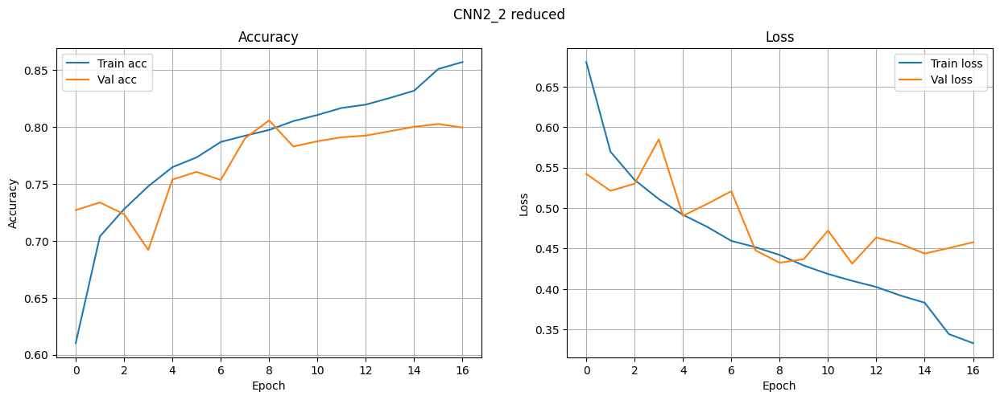

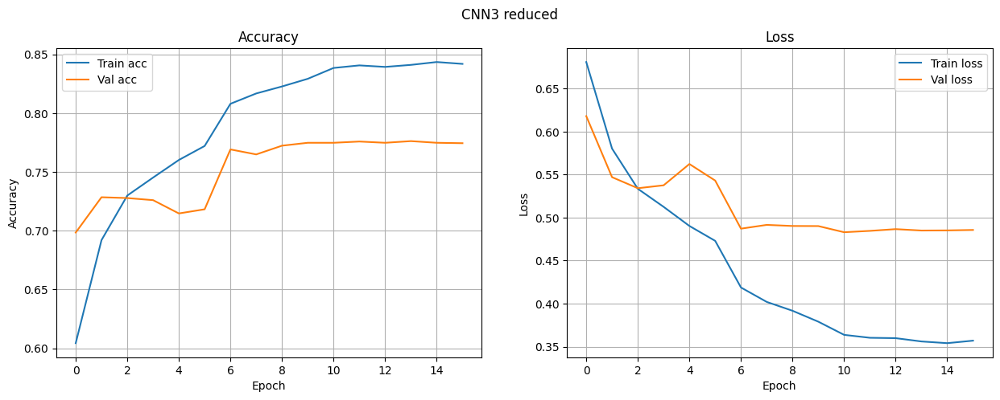

In [136]:
hists = {
   "NN reduced":history_nn,
   "CNN1 reduced":history_cnn1,
   "CNN2 reduced":history_cnn2,
   "CNN2_2 reduced":history_cnn2_2,
   "CNN3 reduced":history_cnn3
}
for n,h in hists.items():
    plot_loss_acc(h,n,auc=False)

In [92]:
def get_prediction_test(model,red=False):
    if red:
        test_set = patches_test_reduced.astype(float)/255
        # test_set = images_red_te
    else:
        test_set = patches_test.astype(float)/255
        # test_set = images_te
    # return model.predict(test_set.astype(float)/255)
    return model.predict(test_set)

predictions_best = get_prediction_test(best, True)

predictions_nn = get_prediction_test(model_nn)
predictions_nn_aug = get_prediction_test(model_nn_aug)
predictions_cnn1 = get_prediction_test(model_cnn1)
predictions_cnn1_aug = get_prediction_test(model_cnn1_aug)
predictions_cnn2 = get_prediction_test(model_cnn2)
predictions_cnn2_aug = get_prediction_test(model_cnn2_aug)
# predictions_cnn2_2_aug = get_prediction_test(model_cnn2_2_aug)
predictions_cnn2_2 = get_prediction_test(model_cnn2_2)
predictions_cnn3 = get_prediction_test(model_cnn3)
predictions_cnn3_aug = get_prediction_test(model_cnn3_aug)

predictions_nn_red = get_prediction_test(model_nn_red,True)
predictions_nn_red_aug = get_prediction_test(model_nn_red_aug,True)
predictions_cnn1_red = get_prediction_test(model_cnn1_red,True)
predictions_cnn1_red_aug = get_prediction_test(model_cnn1_red_aug,True)
predictions_cnn2_red = get_prediction_test(model_cnn2_red,True)
predictions_cnn2_red_aug = get_prediction_test(model_cnn2_red_aug,True)
predictions_cnn2_2_red_aug = get_prediction_test(model_cnn2_2_red_aug,True)
predictions_cnn2_2_red = get_prediction_test(model_cnn2_2_red,True)
predictions_cnn3_red = get_prediction_test(model_cnn3_red,True)
predictions_cnn3_red_aug = get_prediction_test(model_cnn3_red_aug,True)

# predictions_simple = get_prediction_test(model_simple)
# predictions_simple_red = get_prediction_test(model_simple_red,True)
# predictions_unet = get_prediction_test(model_unet)
# predictions_unet_red = get_prediction_test(model_unet_red,True)

11/87 [==>...........................] - ETA: 2s

87/87 [==============================] - 2s 19ms/step


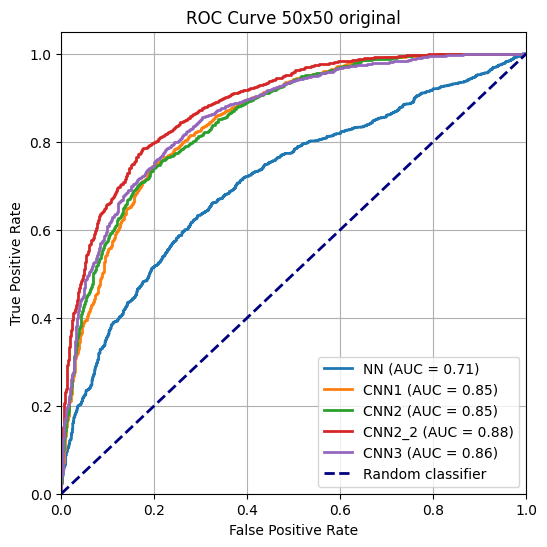

0.8608135158939867

In [125]:
# plot_AUC(labels_test, predictions[:,1])
# plot_AUC(labels_test, predictions)
compare_models = {
    "NN": predictions_nn,
    # "NN A": predictions_nn_aug,
    "CNN1": predictions_cnn1,
    # "CNN1 A": predictions_cnn1_aug,
    "CNN2": predictions_cnn2,
    # "CNN2 A": predictions_cnn2_aug,
    "CNN2_2": predictions_cnn2_2,
    "CNN3": predictions_cnn3,
    # "CNN3 A": predictions_cnn3_aug
}
# plot_AUC(labels_test,compare_models,figsize=(6,6),title="original")
plot_AUC(labels_test,compare_models,figsize=(6,6),title="50x50 original")

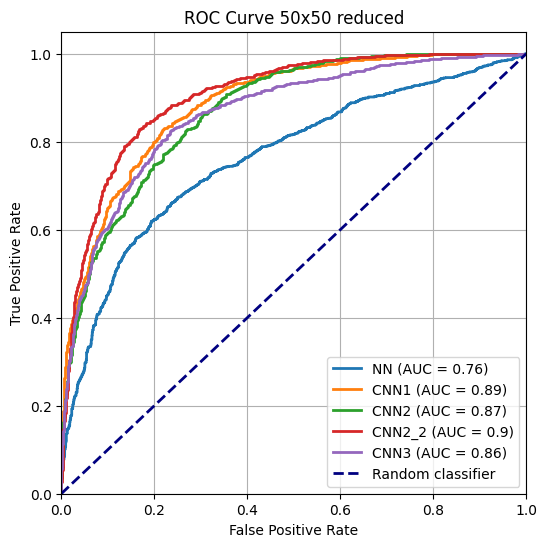

0.8648003185681201

In [126]:
compare_models_red = {
    "NN": predictions_nn_red,
    # "NN A": predictions_nn_red_aug,
    "CNN1": predictions_cnn1_red,
    # "CNN1 A": predictions_cnn1_red_aug,
    "CNN2": predictions_cnn2_red,
    # "CNN2 A": predictions_cnn2_red_aug,
    "CNN2_2": predictions_cnn2_2_red,
    # "CNN2_2 A": predictions_cnn2_2_red_aug,
    "CNN3": predictions_cnn3_red,
    # "CNN3 A": predictions_cnn3_red_aug
}
plot_AUC(labels_test_reduced, compare_models_red,figsize=(6,6),title="50x50 reduced")

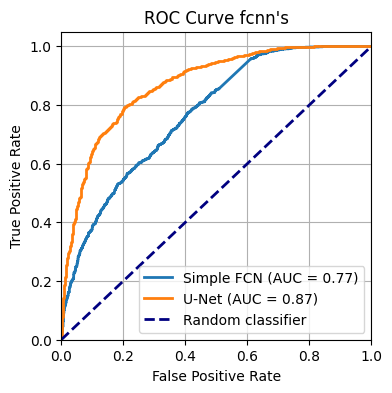

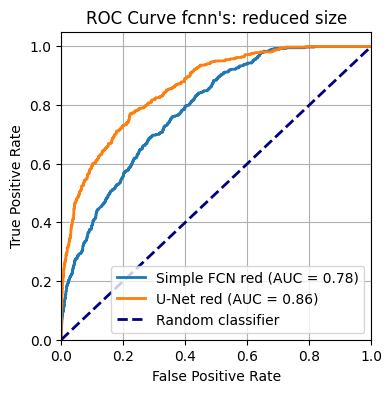

0.8593471657001004

In [59]:
compare_models_fcnn = {
    "Simple FCN": np.array([x[25,25] for x in predictions_simple]),
    "U-Net": np.array([x[25,25] for x in predictions_unet]),
}
plot_AUC(labels_te,compare_models_fcnn,figsize=(4,4),title="fcnn's")
compare_models_fcnn_red = {
    "Simple FCN red": np.array([x[25,25] for x in predictions_simple_red]),
    "U-Net red": np.array([x[25,25] for x in predictions_unet_red]),
}
plot_AUC(labels_red_te,compare_models_fcnn_red,figsize=(4,4),title="fcnn's: reduced size")

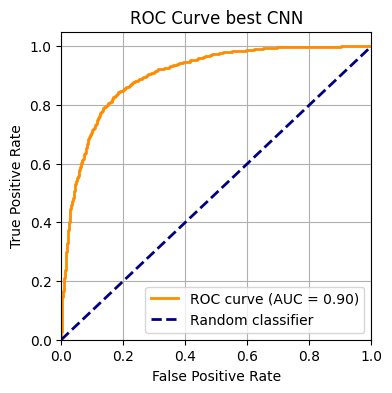

0.903601706016117

In [122]:
plot_AUC(labels_test_reduced,predictions_best,"best CNN")

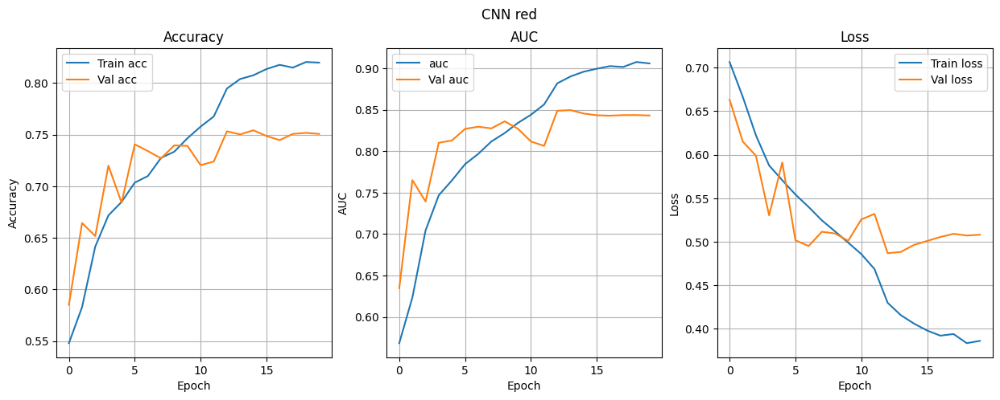

In [132]:
plot_loss_acc(history_cnn2_2_red,"CNN red")

array([[0.83979517, 0.16020483],
       [0.17836676, 0.82163324]])

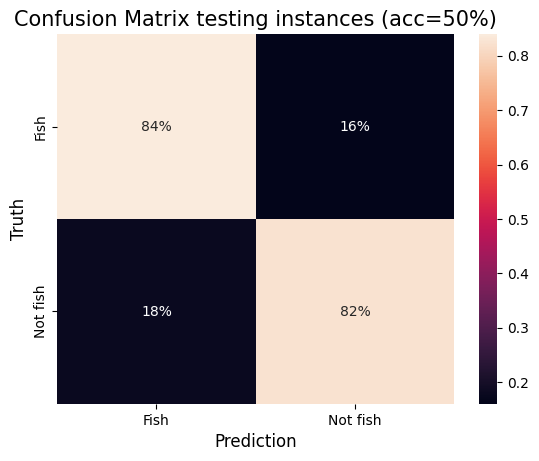

In [156]:
plot_confustion_matrix(labels_red_te,predictions_best>0.5,percent=True)